## Welcome to Plotbot!

👋 Welcome to Plotbot! A tool for downloading and plotting data from the Parker Solar Probe. Created by Dr. Jaye Verniero and Dr. Robert Alexander. Note: this is a work in progress.

First, click in the upper right hand corner of this window to select the plotbot environment. It should be named plotbot_env (Python 3.12.4). Alternatively, you'll be prompted to select the environment when you run the first cell below.







### Plotbot

Let's get started by importing plotbot:

In [29]:
# You may need to install these manually 
# !pip install ipywidgets
# !pip install pytest 
# !pip install termcolor 

In [1]:
from plotbot import *

initialized server_access
initialized global_tracker
initialized ploptions
initialized plot_manager
initialized epad class
initialized epad_hr class
initialized proton class
initialized proton_hr class
initialized data_cubby
initialized proton_fits class
initialized ham_class
No save directory previously set. Defaulting to: ./audio_files
🔉 initialized audifier

Importing libraries, this may take a moment. Hold tight... 

✅ Imported standard libraries and utilities.
✅ Imported numpy, pandas, and scipy libraries.
✅ Imported matplotlib libraries.
✅ Imported cdflib, BeautifulSoup, requests, dateutil, and datetime libraries.

🤖 Plotbot Initialized
✨ Showdahodo initialized
Positional Data Helper Initialized
📈📉 Multiplot Initialized
   Version: 2025_05_21_v2.48
   Commit: v2.48 Refactor: Decouple test_pilot from main plotbot import to fix user FileNotFoundError.

🤖 Plotbot Initialized


Feel free to use ✨Run All✨ to 
initialize all the cells, then scroll down to the plotbot section
and start plotting to your heart's content 📈


In [2]:
#----Print manager----///
print_manager.show_status = False  # Status prints, ⭐️ useful for basic status updates
print_manager.show_processing = False # e.g. Processing mag_RTN_4sa...
print_manager.show_custom_debug = False  # Custom variable operations debugging
print_manager.show_debug = False  # Debug prints, helpful for debugging (will print LOTS of lines)
print_manager.show_time_tracking = False  # For tracking datetime array inputs and outputs
print_manager.show_warning = False     # Turn off warning messages
print_manager.show_variable_testing = False
print_manager.show_test = False  # Turn off test-specific output

print_manager.show_module_prefix = False  # Show/Hide [print_manager]
print_manager.show_category_prefix = False  # Show/Hide [PROCESS], [TIME], etc.

In [42]:
import numpy as np

def upsample_to_match_halfsec(x_times, x_values, target_times, varname=""):
    """
    Efficiently upsample x_values to target_times by matching x_times to nearest value within ±0.5s.
    Uses np.searchsorted for speed. Returns NaN where no match is within tolerance.
    """
    try:
        if x_times is None or x_values is None or len(x_times) == 0 or len(x_values) == 0:
            print(f"⚠️ Upsample skipped for '{varname}': input times or values are empty or None.")
            return np.full(len(target_times), np.nan)

        x_times = np.array(x_times).astype('datetime64[ns]')
        x_values = np.array(x_values)
        target_times = np.array(target_times).astype('datetime64[ns]')

        # Sort inputs (required for searchsorted)
        sort_idx = np.argsort(x_times)
        x_times_sorted = x_times[sort_idx]
        x_values_sorted = x_values[sort_idx]

        # Get numeric representation in nanoseconds
        x_ns = x_times_sorted.astype('int64')
        target_ns = target_times.astype('int64')

        # Search for insertion index
        idxs = np.searchsorted(x_ns, target_ns)

        # Clip indices to valid range
        idxs = np.clip(idxs, 1, len(x_ns) - 1)

        # Check which side is closer (idx-1 or idx)
        prev_diff = np.abs(target_ns - x_ns[idxs - 1])
        next_diff = np.abs(target_ns - x_ns[idxs])
        nearest_idx = np.where(prev_diff <= next_diff, idxs - 1, idxs)

        # Only accept matches within ±0.5 seconds (in ns)
        tolerance = int(0.5 * 1e9)  # 0.5 seconds in nanoseconds
        valid = np.minimum(prev_diff, next_diff) <= tolerance

        result = np.full(len(target_times), np.nan)
        result[valid] = x_values_sorted[nearest_idx[valid]]

        #print(f"✅ Matched {np.count_nonzero(valid)} of {len(target_times)} time points in '{varname}'.")
        return result

    except Exception as e:
        print(f"❌ Upsample failed for '{varname}': {e}")
        return np.full(len(target_times), np.nan)


['2020-01-25 00:00', '2020-02-02 23:59']


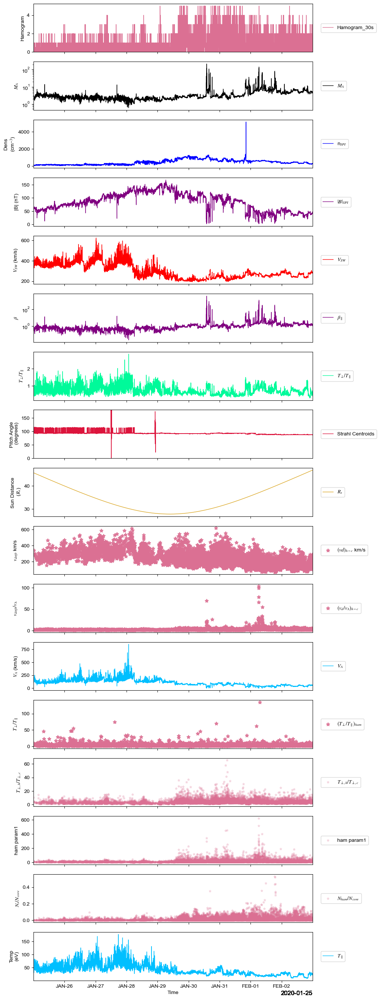

['2020-06-04 00:00', '2020-06-10 23:59']


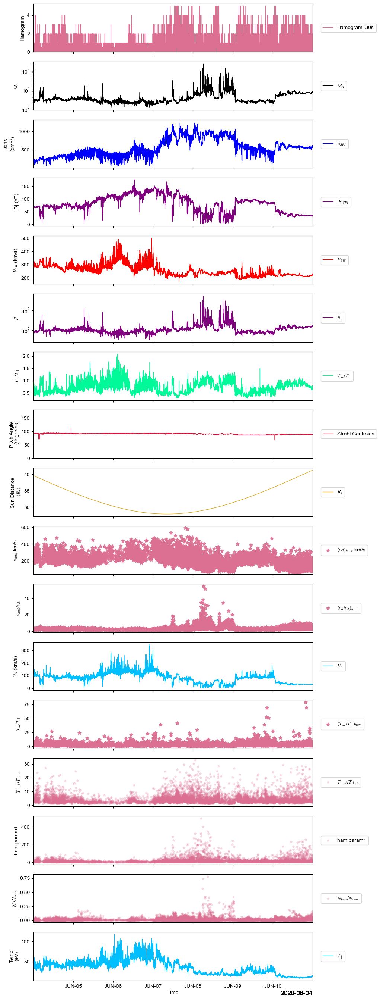

['2020-09-24 00:00', '2020-10-01 23:59']


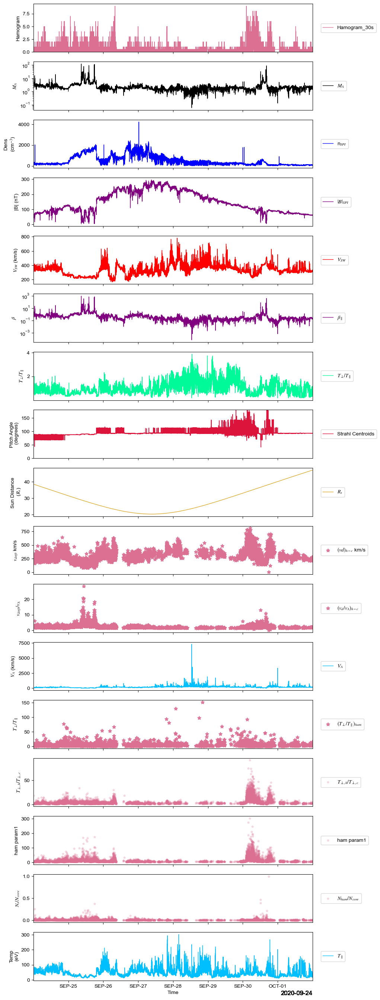

['2021-01-14 00:00', '2021-01-20 23:59']


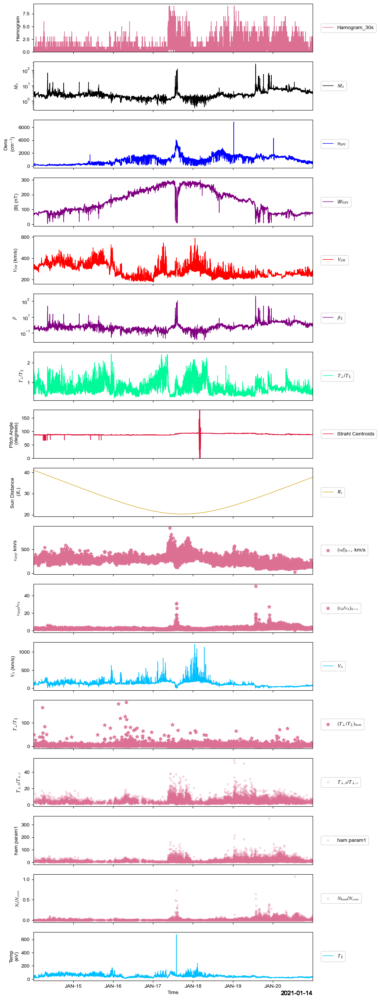

['2021-04-26 00:00', '2021-05-02 23:59']


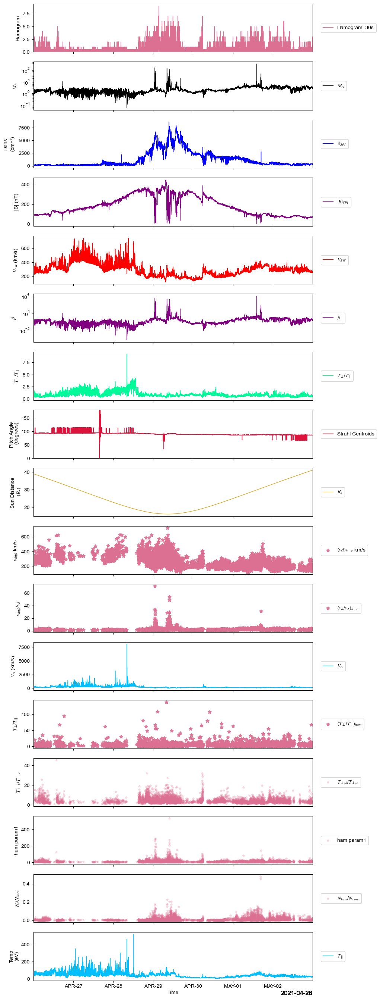

['2021-08-06 00:00', '2021-08-12 23:59']


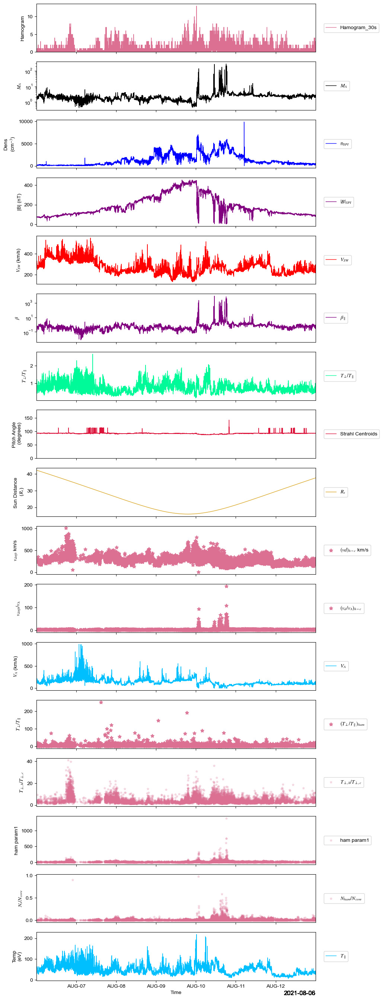

['2021-11-17 00:00', '2021-11-24 23:59']


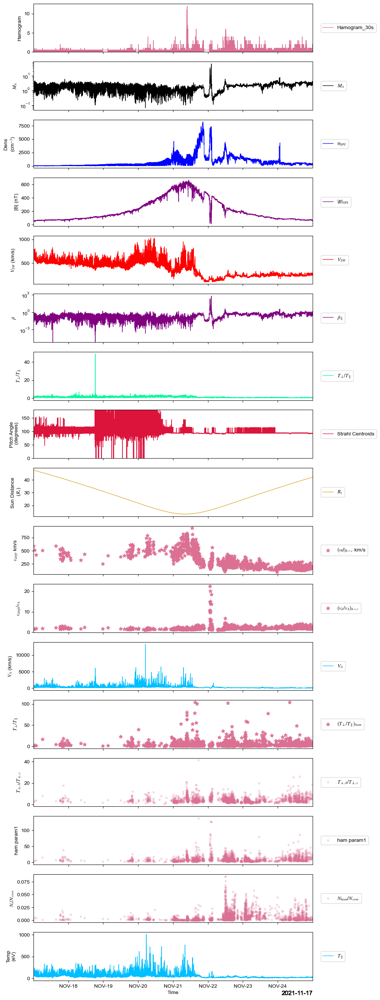

['2022-02-22 00:00', '2022-02-28 23:59']


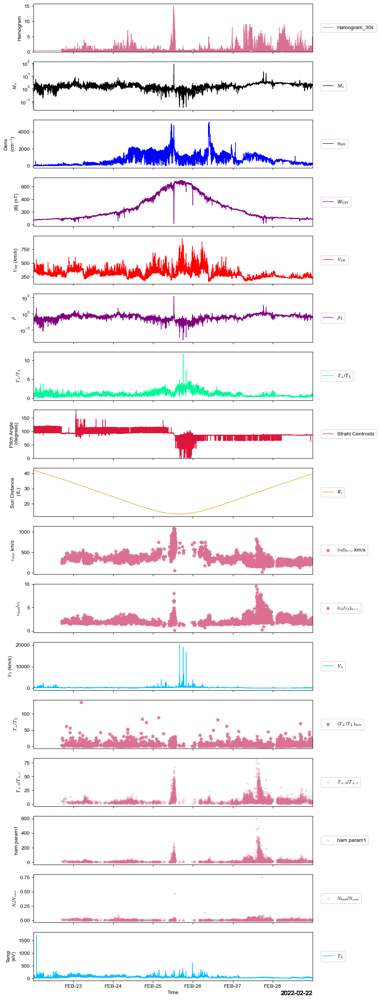

['2022-05-29 00:00', '2022-06-04 23:59']


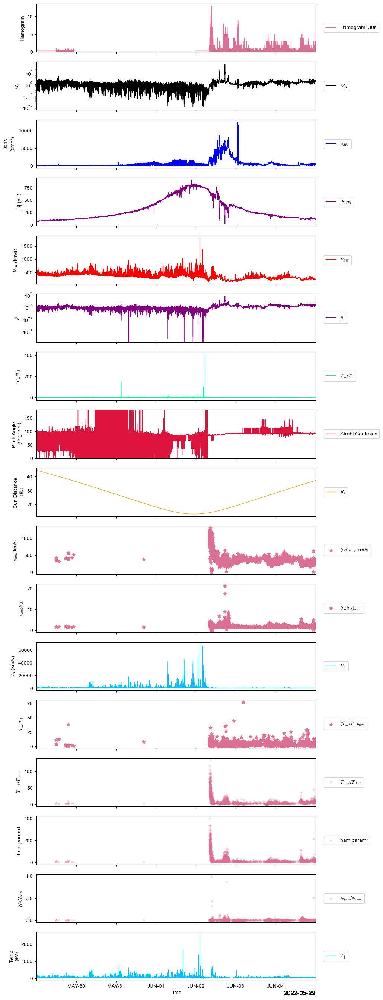

['2022-09-03 00:00', '2022-09-09 23:59']


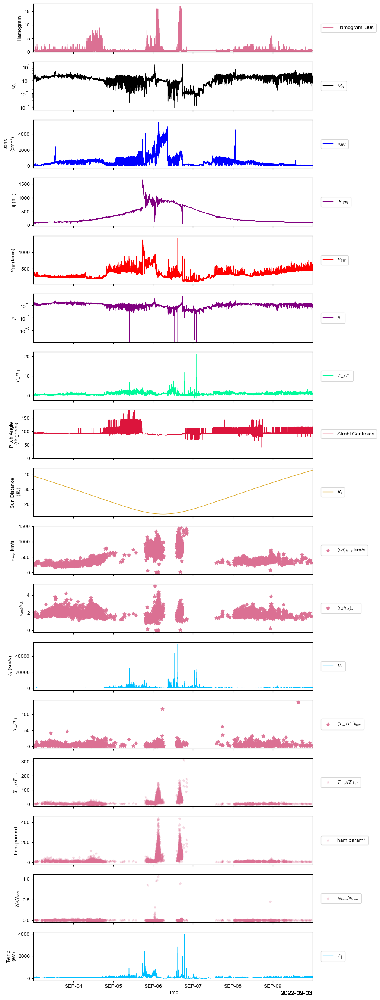

['2022-12-08 00:00', '2022-12-14 23:59']


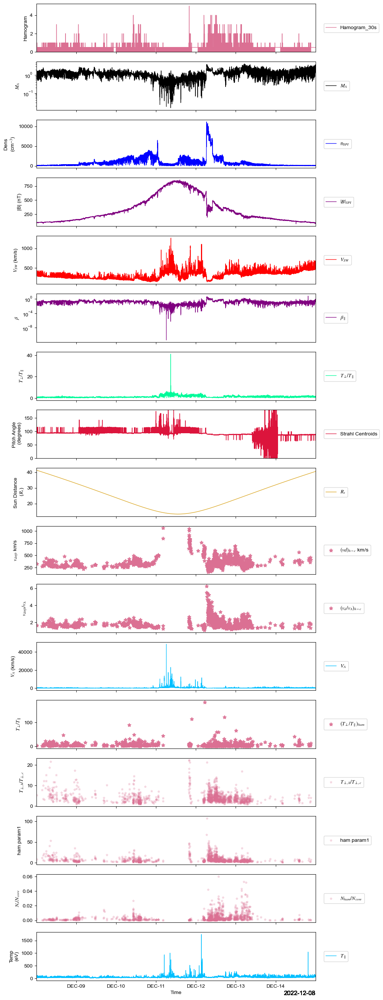

['2023-03-12 00:00', '2023-03-20 23:59']


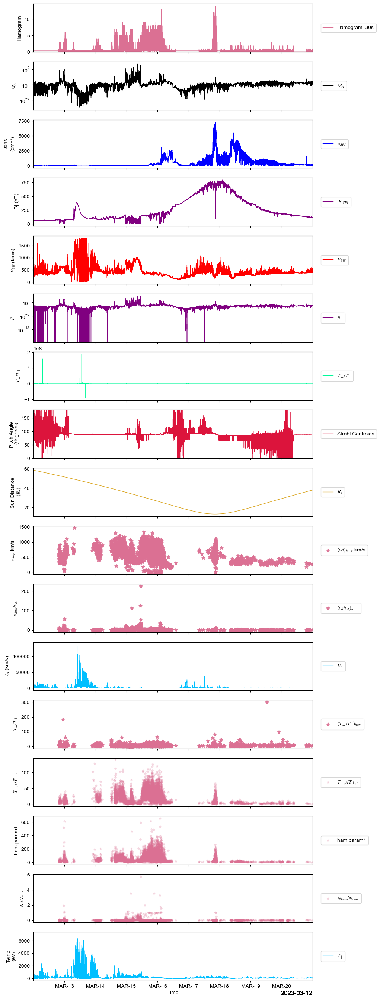

['2023-09-24 00:00', '2023-09-30 23:59']


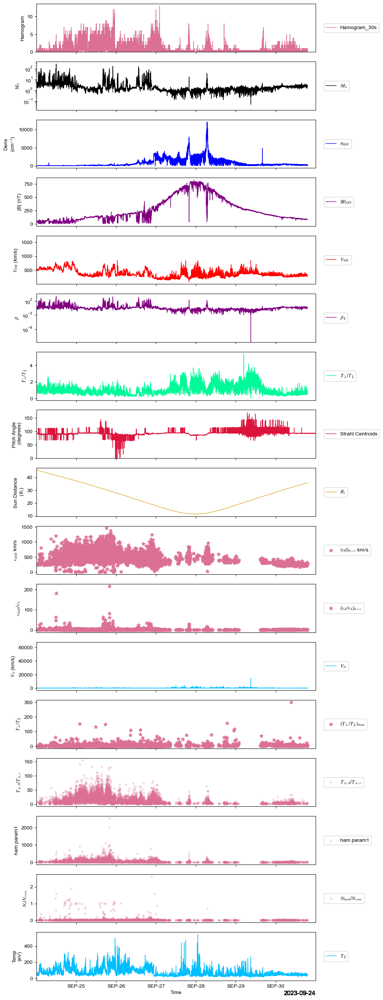

['2023-12-26 00:00', '2024-01-02 23:59']


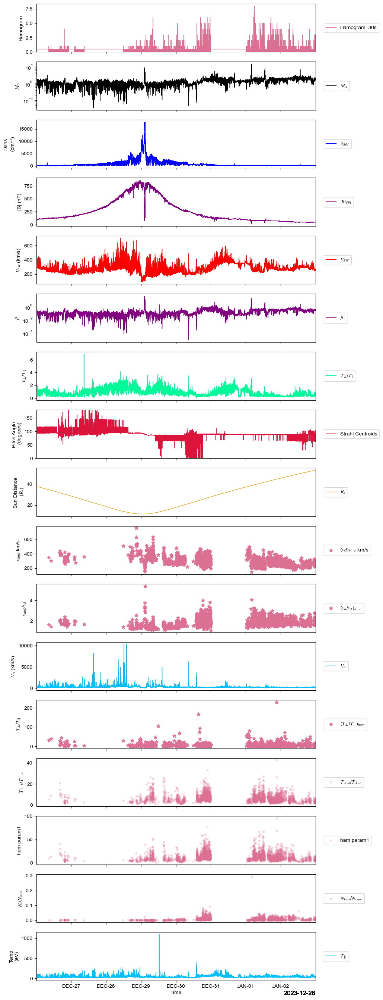

['2024-03-27 00:00', '2024-04-03 23:59']


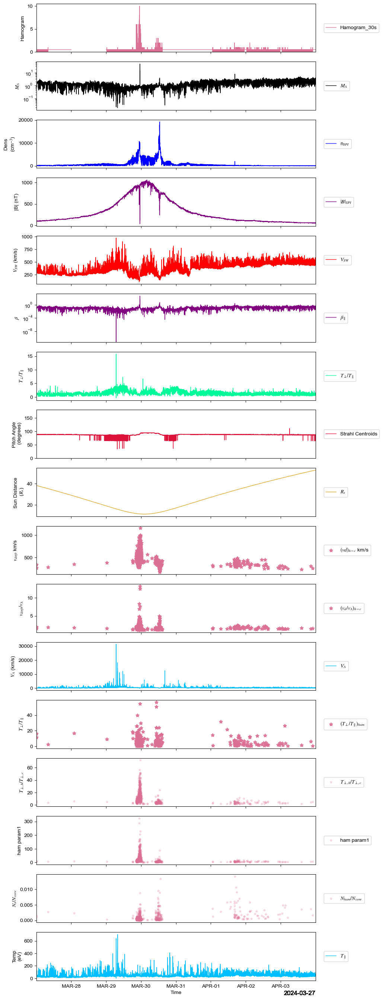

['2024-06-27 00:00', '2024-07-03 23:59']


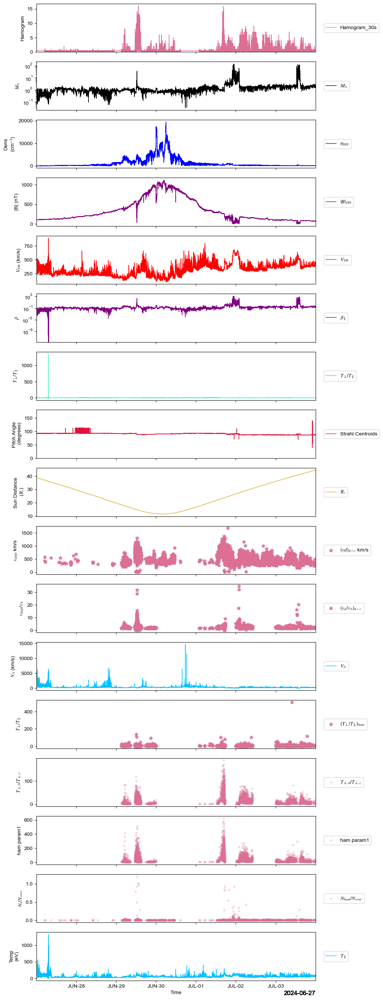

['2024-09-27 00:00', '2024-10-03 23:59']


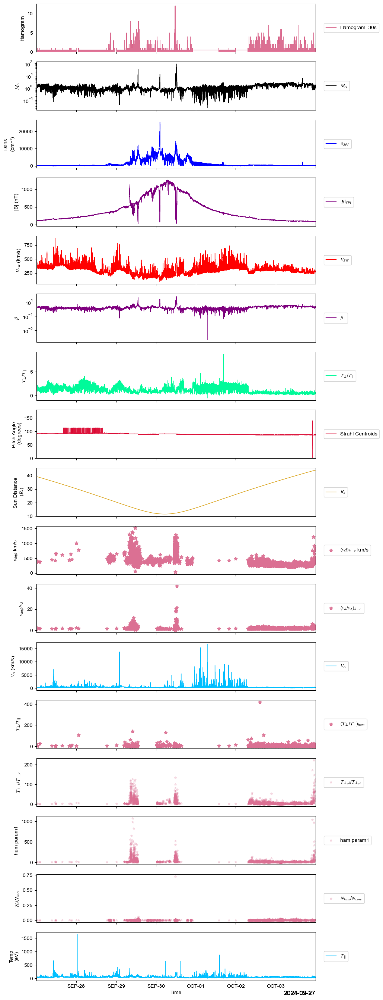

['2024-12-21 00:00', '2024-12-27 23:59']


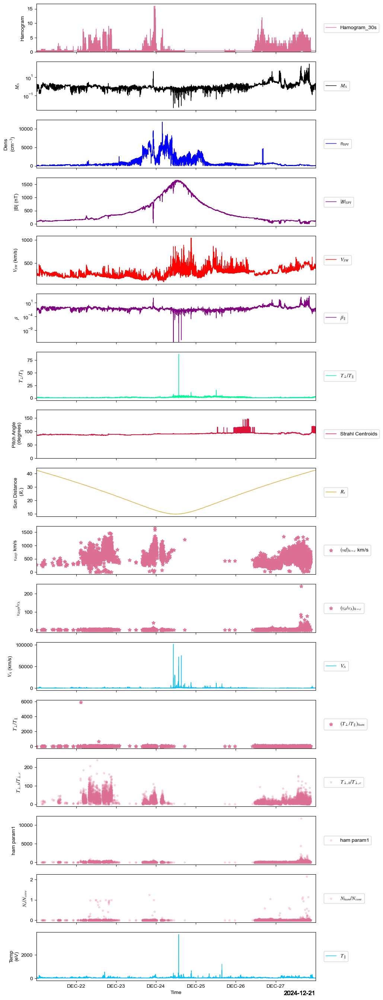

['2025-03-19 00:00', '2025-03-27 23:59']


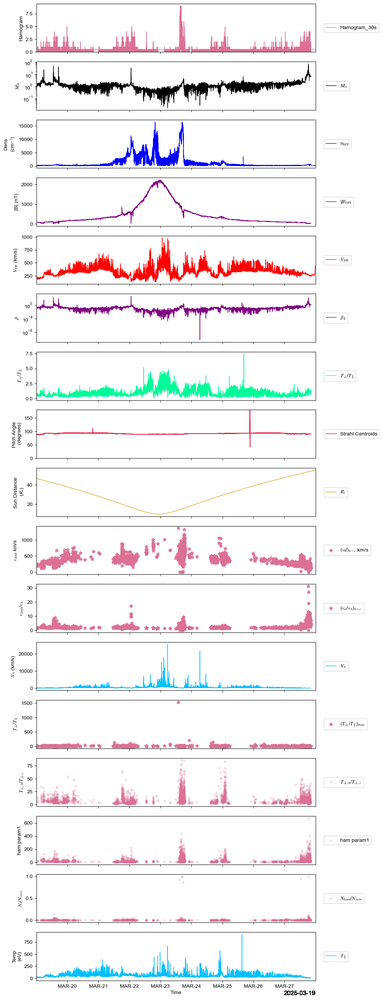

In [4]:


# Step 1: Group time ranges into a list
time_ranges = [
    ['2020-01-25 00:00','2020-02-02 23:59'], # E4
    ['2020-06-04 00:00','2020-06-10 23:59'], # E5
    ['2020-09-24 00:00','2020-10-01 23:59'], # E6
    ['2021-01-14 00:00','2021-01-20 23:59'], # E7
    ['2021-04-26 00:00','2021-05-02 23:59'], # E8
    ['2021-08-06 00:00','2021-08-12 23:59'], # E9
    ['2021-11-17 00:00','2021-11-24 23:59'], # E10
    ['2022-02-22 00:00','2022-02-28 23:59'], # E11
    ['2022-05-29 00:00','2022-06-04 23:59'], # E12
    ['2022-09-03 00:00','2022-09-09 23:59'], # E13
    ['2022-12-08 00:00','2022-12-14 23:59'], # E14
    ['2023-03-12 00:00','2023-03-20 23:59'], # E15
    ['2023-09-24 00:00','2023-09-30 23:59'], # E17
    ['2023-12-26 00:00','2024-01-02 23:59'], # E18
    ['2024-03-27 00:00','2024-04-03 23:59'], # E19
    ['2024-06-27 00:00','2024-07-03 23:59'], # E20
    ['2024-09-27 00:00','2024-10-03 23:59'], # E21
    ['2024-12-21 00:00','2024-12-27 23:59'], # E22
    ['2025-03-19 00:00','2025-03-27 23:59'], # E23
]

# Step 2: Initialize lists to collect data
ham_data, ham_time = [], []
amach_data, amach_time = [], []
vsw_data, vsw_time = [], []
beta_data, beta_time = [], []
anisotropy_data, anisotropy_time = [], []
bmag_data, bmag_time = [], []
epad_centroid_data, epad_centroid_time = [], []
density_data, density_time = [], []
sun_dist_rsun_data, sun_dist_rsun_time = [], []
ham_core_drift_data, ham_core_drift_time = [], [],
ham_core_drift_va_data, ham_core_drift_va_time = [], [],
valfven_data, valfven_time = [], []
ham_trat_data, ham_trat_time = [], []
ham_tperp_div_core_data, ham_tperp_div_core_time = [], []
ham_tperprat_driftva_hc_data, ham_tperprat_driftva_hc_time = [], []
ham_nham_div_ncore_data, ham_nham_div_ncore_time =  [], []
tpar_data, tpar_time = [], []


# Step 3: Loop through each time range and call plotbot
for tr in time_ranges:
    print(tr)
    plotbot(tr,
        ham.hamogram_30s, 1,
        proton.m_alfven, 2,
        proton.density, 3,
        proton.bmag, 4,
        proton.v_sw, 5,
        proton.beta_ppar, 6,
        proton.anisotropy, 7,
        epad.centroids, 8,
        proton.sun_dist_rsun, 9,
        ham.ham_core_drift, 10,
        ham.ham_core_drift_va, 11,
        proton.v_alfven, 12,
        ham.trat_ham,13,
        ham.Tperp_ham_div_core, 14,a
    beta_time.append(proton.beta_ppar.datetime_array)

    bmag_data.append(proton.bmag.data)
    bmag_time.append(proton.bmag.datetime_array)

    anisotropy_data.append(proton.anisotropy.data)
    anisotropy_time.append(proton.anisotropy.datetime_array)

    epad_centroid_data.append(epad.centroids.data)
    epad_centroid_time.append(epad.centroids.datetime_array)

    density_data.append(proton.density.data)
    density_time.append(proton.density.datetime_array)

    sun_dist_rsun_data.append(proton.sun_dist_rsun.data)
    sun_dist_rsun_time.append(proton.sun_dist_rsun.datetime_array)

    ham_core_drift_data.append(ham.ham_core_drift.data)
    ham_core_drift_time.append(ham.ham_core_drift.datetime_array)

    ham_core_drift_va_data.append(ham.ham_core_drift_va.data)
    ham_core_drift_va_time.append(ham.ham_core_drift_va.datetime_array)
    
    valfven_data.append(proton.v_alfven.data)
    valfven_time.append(proton.v_alfven.datetime_array)

    ham_trat_data.append(ham.trat_ham.data)
    ham_trat_time.append(ham.trat_ham.datetime_array)

    ham_tperp_div_core_data.append(ham.Tperp_ham_div_core.data)
    ham_tperp_div_core_time.append(ham.Tperp_ham_div_core.datetime_array)

    ham_tperprat_driftva_hc_data.append(ham.Tperprat_driftva_hc.data)
    ham_tperprat_driftva_hc_time.append(ham.Tperprat_driftva_hc.datetime_array)

    ham_nham_div_ncore_data.append(ham.Nham_div_Ncore.data)
    ham_nham_div_ncore_time.append(ham.Nham_div_Ncore.datetime_array)

    tpar_data.append(proton.t_par.data)
    tpar_time.append(proton.t_par.datetime_array)

    
# Step 4: Concatenate across all events
ham_data_all = np.concatenate(ham_data)
ham_time_all = np.concatenate(ham_time)

amach_data_all = np.concatenate(amach_data)
amach_time_all = np.concatenate(amach_time)

vsw_data_all = np.concatenate(vsw_data)
vsw_time_all = np.concatenate(vsw_time)

beta_data_all = np.concatenate(beta_data)
beta_time_all = np.concatenate(beta_time)

bmag_data_all = np.concatenate(bmag_data)
bmag_time_all = np.concatenate(bmag_time)

density_data_all = np.concatenate(density_data)
density_time_all = np.concatenate(density_time)

anisotropy_data_all = np.concatenate(anisotropy_data)
anisotropy_time_all = np.concatenate(anisotropy_time)

epad_centroid_data_all = np.concatenate(epad_centroid_data)
epad_centroid_time_all = np.concatenate(epad_centroid_time)

sun_dist_rsun_data_all = np.concatenate(sun_dist_rsun_data)
sun_dist_rsun_time_all = np.concatenate(sun_dist_rsun_time)

ham_core_drift_data_all = np.concatenate(ham_core_drift_data)
ham_core_drift_time_all = np.concatenate(ham_core_drift_time)

ham_core_drift_va_data_all = np.concatenate(ham_core_drift_va_data)
ham_core_drift_va_time_all = np.concatenate(ham_core_drift_va_time)

valfven_data_all = np.concatenate(valfven_data)
valfven_time_all = np.concatenate(valfven_time)

ham_trat_data_all = np.concatenate(ham_trat_data)
ham_trat_time_all = np.concatenate(ham_trat_time)

ham_tperp_div_core_data_all = np.concatenate(ham_tperp_div_core_data)
ham_tperp_div_core_time_all = np.concatenate(ham_tperp_div_core_time)

ham_tperprat_driftva_hc_data_all = np.concatenate(ham_tperprat_driftva_hc_data)
ham_tperprat_driftva_hc_time_all = np.concatenate(ham_tperprat_driftva_hc_time)

ham_nham_div_ncore_data_all = np.concatenate(ham_nham_div_ncore_data)
ham_nham_div_ncore_time_all = np.concatenate(ham_nham_div_ncore_time)

tpar_data_all = np.concatenate(tpar_data)
tpar_time_all = np.concatenate(tpar_time)


In [119]:
print((3826316/40)*3.5/(60*60)
      )

93.0007361111111


In [39]:
print(len(amach_time_all))
print(len(ham_data_all))

35075832
3826316


In [18]:
import pandas as pd
from pathlib import Path

date_list = [
    '2022-09-06','2022-09-07','2022-09-08','2022-09-09',                              #E13
    '2022-12-08','2022-12-09','2022-12-10','2022-12-11','2022-12-12','2022-12-13','2022-12-14',                              #E14
    '2023-03-12','2023-03-13','2023-03-14','2023-03-15','2023-03-16', '2023-03-17', '2023-03-18','2023-03-19','2023-03-20',  #E15
    '2023-06-18','2023-06-19','2023-06-20','2023-06-21','2023-06-22','2023-06-23','2023-06-24','2023-06-25',                #E16
    '2023-09-24','2023-09-25','2023-09-26', '2023-09-27','2023-09-28','2023-09-29','2023-09-30',  #E17
    '2023-12-26','2023-12-27','2023-12-28','2023-12-29','2023-12-30','2024-01-01','2024-01-02',                              #E18
    '2024-03-27','2024-03-28','2024-03-29','2024-03-30','2024-04-01','2024-04-02','2024-04-03',                 #E19
    '2024-06-27','2024-06-28','2024-06-29','2024-06-30','2024-07-01','2024-07-02','2024-07-03', #E20
    '2024-09-27','2024-09-28','2024-09-29','2024-09-30','2024-10-01','2024-10-02','2024-10-03', #E21
    '2024-12-21','2024-12-22','2024-12-23','2024-12-24','2024-12-25','2024-12-26','2024-12-27', #E22
    '2025-03-19','2025-03-20','2025-03-21','2025-03-22','2025-03-23','2025-03-24','2025-03-25','2025-03-26','2025-03-27' #E23
]

base_ham = Path("/Users/jlverniero/GitHub/Plotbot/psp_data/Hamstrings/v00")
base_wave = Path("/Users/jlverniero/GitHub/Plotbot/psp_data/WaveAnalysis/WavePower/v1.3/ds/spi")

tolerance = pd.Timedelta('500ms')  # ⏱ ±0.5 seconds

for date in date_list:
    yyyy, mm, dd = date.split("-")

    ham_path = base_ham / f"{date}_v00.csv"
    wave_path = base_wave / yyyy / mm / f"PSP_wavePower_{date}_ds_spi.csv"

    try:
        df_ham = pd.read_csv(ham_path)
        df_wave = pd.read_csv(wave_path)
    except FileNotFoundError as e:
        print(f"❌ File not found for {date}: {e}")
        continue
    except Exception as e:
        print(f"⚠️ Error reading files for {date}: {e}")
        continue

    # Parse timestamps from Unix seconds
    ham_times = pd.to_datetime(df_ham.iloc[:, 0], unit='s')
    amach_times = pd.to_datetime(df_wave.iloc[:, 0])

    # Fuzzy matching: find amach_times with no ham_time within ±0.5s
    missing_times = amach_times[~amach_times.apply(
        lambda t: ((ham_times - t).abs() <= tolerance).any()
    )]

    if not missing_times.empty:
        print(f"\n📅 {date}: {len(missing_times)} timestamps in wavePower not within ±0.5s of any hamstrings:")
        print(missing_times.to_string(index=False))
    else:
        print(f"✅ {date}: All timestamps match within ±0.5s.")





📅 2022-09-06: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-09-07 00:00:00.552

📅 2022-09-07: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-09-08 00:00:00.767

📅 2022-09-08: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-09-09 00:00:00.147

📅 2022-09-09: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-09-09 23:59:59.501
✅ 2022-12-08: All timestamps match within ±0.5s.
✅ 2022-12-09: All timestamps match within ±0.5s.

📅 2022-12-10: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-12-11 00:00:00.456

📅 2022-12-11: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-12-12 00:00:00.025

📅 2022-12-12: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-12-13 00:00:00.266

📅 2022-12-13: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-12-13 23:59:59.655

📅 2022-12-14: 1 timestamps in wavePower not within ±0.5s of any hamstrings:
2022-12-14 23:59:

KeyboardInterrupt: 

In [33]:
import pandas as pd

# Assume amach_times and ham_times are both pandas datetime Series or arrays
# If not already datetime, convert:
import numpy as np
import pandas as pd

# Make sure inputs are datetime-like
amach_times = pd.to_datetime(amach_times)
ham_times = pd.to_datetime(ham_times)
tolerance = pd.Timedelta('500ms')

# Convert to Series so we can apply
amach_series = amach_times.to_series()

# Use np.abs instead of .abs()
missing_times = amach_series[~amach_series.apply(
    lambda t: (np.abs(ham_times - t) <= tolerance).any()
)]



print(f"🔍 Found {len(missing_times)} unmatched amach_times out of {len(amach_times)} total.")
for t in missing_times:
    print(t)


KeyboardInterrupt: 

In [30]:
print(len(density_time_all))
print(len(ham_time_all))

35075832
3826316


In [27]:
print(density_time_all[0])
print(density_time_all[1])
print(ham_time_all[0])
print(ham_time_all[1])

2020-01-25T00:00:04.943605248
2020-01-25T00:00:11.934145664
2020-01-25T00:00:04.943000000
2020-01-25T00:00:11.934000000


In [6]:
print(ham_time_all[0])
print(ham_time_all[1])
print(amach_time_all[0])
print(amach_time_all[1])

2020-01-25T00:00:04.943000000
2020-01-25T00:00:11.934000000
2020-01-25T00:00:04.943605248
2020-01-25T00:00:11.934145664


In [7]:
print(ham_time_all[-1])
print(amach_time_all[-1])

2025-03-27T23:58:58.732000000
2025-03-27T23:55:56.978770304


In [13]:
import pandas as pd
from pathlib import Path

date_list = [
    '2020-01-25','2020-01-26','2020-01-27','2020-01-28','2020-01-29','2020-01-30','2020-01-31','2020-02-01','2020-02-02', #E4
    '2020-06-04','2020-06-05','2020-06-06','2020-06-07','2020-06-08','2020-06-09','2020-06-10', #E5
    '2020-09-24','2020-09-25','2020-09-26','2020-09-27','2020-09-28','2020-09-29','2020-09-30','2020-10-01',   #E6
    '2021-01-14','2021-01-15','2021-01-16','2021-01-17','2021-01-18','2021-01-19','2021-01-20',                               #E7
    '2021-04-26','2021-04-27','2021-04-28','2021-04-29','2021-04-30', '2021-05-01','2021-05-02',  #E8
    '2021-08-06','2021-08-07','2021-08-08','2021-08-09','2021-08-10','2021-08-11','2021-08-12',    #E9
    '2021-11-17','2021-11-18','2021-11-19','2021-11-20','2021-11-21','2021-11-22','2021-11-23','2021-11-24',                #E10
    '2022-02-22','2022-02-23','2022-02-24','2022-02-25','2022-02-26','2022-02-27','2022-02-28',                              #E11
    '2022-05-29','2022-05-30','2022-05-31','2022-06-01','2022-06-02', '2022-06-03','2022-06-04',                #E12
    '2022-09-03','2022-09-04','2022-09-05','2022-09-06','2022-09-07','2022-09-08','2022-09-09',                              #E13
    '2022-12-08','2022-12-09','2022-12-10','2022-12-11','2022-12-12','2022-12-13','2022-12-14',                              #E14
    '2023-03-12','2023-03-13','2023-03-14','2023-03-15','2023-03-16', '2023-03-17', '2023-03-18','2023-03-19','2023-03-20',  #E15
    '2023-06-18','2023-06-19','2023-06-20','2023-06-21','2023-06-22','2023-06-23','2023-06-24','2023-06-25',                #E16
    '2023-09-24','2023-09-25','2023-09-26', '2023-09-27','2023-09-28','2023-09-29','2023-09-30',  #E17
    '2023-12-26','2023-12-27','2023-12-28','2023-12-29','2023-12-30','2024-01-01','2024-01-02',                              #E18
    '2024-03-27','2024-03-28','2024-03-29','2024-03-30','2024-04-01','2024-04-02','2024-04-03',                 #E19
    '2024-06-27','2024-06-28','2024-06-29','2024-06-30','2024-07-01','2024-07-02','2024-07-03', #E20
    '2024-09-27','2024-09-28','2024-09-29','2024-09-30','2024-10-01','2024-10-02','2024-10-03', #E21
    '2024-12-21','2024-12-22','2024-12-23','2024-12-24','2024-12-25','2024-12-26','2024-12-27', #E22
    '2025-03-19','2025-03-20','2025-03-21','2025-03-22','2025-03-23','2025-03-24','2025-03-25','2025-03-26','2025-03-27' #E23
]


base_ham = Path("/Users/jlverniero/GitHub/Plotbot/psp_data/Hamstrings/v00")

# List to collect each day's dataframe
ham_dfs = []

for date in date_list:
    file_path = base_ham / f"{date}_v00.csv"

    try:
        df = pd.read_csv(file_path)
        df['date'] = date  # Optional: add source date as a column
        ham_dfs.append(df)
    except FileNotFoundError:
        print(f"❌ Skipped missing file for {date}")
    except Exception as e:
        print(f"⚠️ Error loading {date}: {e}")

# 🧬 Concatenate into one big ham
ham_all = pd.concat(ham_dfs, ignore_index=True)

print(f"🥓 Loaded {len(ham_all)} total rows from {len(ham_dfs)} ham files.")


🥓 Loaded 4075725 total rows from 149 ham files.


In [ ]:
print(len(amach_time_all))


35075832


In [21]:
import pandas as pd
from pathlib import Path

date_list = [
    '2020-01-25','2020-01-26','2020-01-27','2020-01-28','2020-01-29','2020-01-30','2020-01-31','2020-02-01','2020-02-02', #E4
    '2020-06-04','2020-06-05','2020-06-06','2020-06-07','2020-06-08','2020-06-09','2020-06-10', #E5
    '2020-09-24','2020-09-25','2020-09-26','2020-09-27','2020-09-28','2020-09-29','2020-09-30','2020-10-01',   #E6
    '2021-01-14','2021-01-15','2021-01-16','2021-01-17','2021-01-18','2021-01-19','2021-01-20',                               #E7
    '2021-04-26','2021-04-27','2021-04-28','2021-04-29','2021-04-30', '2021-05-01','2021-05-02',  #E8
    '2021-08-06','2021-08-07','2021-08-08','2021-08-09','2021-08-10','2021-08-11','2021-08-12',    #E9
    '2021-11-17','2021-11-18','2021-11-19','2021-11-20','2021-11-21','2021-11-22','2021-11-23','2021-11-24',                #E10
    '2022-02-22','2022-02-23','2022-02-24','2022-02-25','2022-02-26','2022-02-27','2022-02-28',                              #E11
    '2022-05-29','2022-05-30','2022-05-31','2022-06-01','2022-06-02', '2022-06-03','2022-06-04',                #E12
    '2022-09-03','2022-09-04','2022-09-05','2022-09-06','2022-09-07','2022-09-08','2022-09-09',                              #E13
    '2022-12-08','2022-12-09','2022-12-10','2022-12-11','2022-12-12','2022-12-13','2022-12-14',                              #E14
    '2023-03-12','2023-03-13','2023-03-14','2023-03-15','2023-03-16', '2023-03-17', '2023-03-18','2023-03-19','2023-03-20',  #E15
    '2023-06-18','2023-06-19','2023-06-20','2023-06-21','2023-06-22','2023-06-23','2023-06-24','2023-06-25',                #E16
    '2023-09-24','2023-09-25','2023-09-26', '2023-09-27','2023-09-28','2023-09-29','2023-09-30',  #E17
    '2023-12-26','2023-12-27','2023-12-28','2023-12-29','2023-12-30','2024-01-01','2024-01-02',                              #E18
    '2024-03-27','2024-03-28','2024-03-29','2024-03-30','2024-04-01','2024-04-02','2024-04-03',                 #E19
    '2024-06-27','2024-06-28','2024-06-29','2024-06-30','2024-07-01','2024-07-02','2024-07-03', #E20
    '2024-09-27','2024-09-28','2024-09-29','2024-09-30','2024-10-01','2024-10-02','2024-10-03', #E21
    '2024-12-21','2024-12-22','2024-12-23','2024-12-24','2024-12-25','2024-12-26','2024-12-27', #E22
    '2025-03-19','2025-03-20','2025-03-21','2025-03-22','2025-03-23','2025-03-24','2025-03-25','2025-03-26','2025-03-27' #E23
]


base_wave = '/Users/jlverniero/GitHub/Plotbot/psp_data/WaveAnalysis/WavePower/v1.3'
csv_dir = f'{base_wave}/ds/spi'

def concat_wave_power_csvs(csv_dir, date_list):
    dfs = []
    for date_str in date_list:
        # Construct file path, e.g. "…/2021/04/PSP_wavePower_2021-04-28_ds_spi.csv"
        date_path = Path(csv_dir) / date_str[:4] / date_str[5:7]
        csv_file = date_path / f"PSP_wavePower_{date_str}_ds_spi.csv"

        if not csv_file.exists():
            print(f"⚠️ CSV file not found for date {date_str}: {csv_file}")
            continue

        print(f"📂 Loading CSV for date {date_str}")
        df = pd.read_csv(csv_file, parse_dates=['epoch'])

        dfs.append(df)

    if not dfs:
        print("⚠️ No CSV files loaded, returning empty DataFrame")
        return pd.DataFrame()

    # Concatenate all dataframes vertically (stack rows)
    full_df = pd.concat(dfs, ignore_index=True)

    # Sort by epoch timestamp
    full_df = full_df.sort_values(by='epoch').reset_index(drop=True)

    return full_df


combined_df = concat_wave_power_csvs(csv_dir, date_list)
print(combined_df.head())

📂 Loading CSV for date 2020-01-25
📂 Loading CSV for date 2020-01-26
📂 Loading CSV for date 2020-01-27
📂 Loading CSV for date 2020-01-28
📂 Loading CSV for date 2020-01-29
📂 Loading CSV for date 2020-01-30
📂 Loading CSV for date 2020-01-31
📂 Loading CSV for date 2020-02-01
📂 Loading CSV for date 2020-02-02
📂 Loading CSV for date 2020-06-04
📂 Loading CSV for date 2020-06-05
📂 Loading CSV for date 2020-06-06
📂 Loading CSV for date 2020-06-07
📂 Loading CSV for date 2020-06-08
📂 Loading CSV for date 2020-06-09
📂 Loading CSV for date 2020-06-10
📂 Loading CSV for date 2020-09-24
📂 Loading CSV for date 2020-09-25
📂 Loading CSV for date 2020-09-26
📂 Loading CSV for date 2020-09-27
📂 Loading CSV for date 2020-09-28
📂 Loading CSV for date 2020-09-29
📂 Loading CSV for date 2020-09-30
📂 Loading CSV for date 2020-10-01
📂 Loading CSV for date 2021-01-14
📂 Loading CSV for date 2021-01-15
📂 Loading CSV for date 2021-01-16
📂 Loading CSV for date 2021-01-17
📂 Loading CSV for date 2021-01-18
📂 Loading CSV 

In [44]:

print(amach_time_all[0])
print(len(density_time_all))
print(len(combined_df))
print(len(ham_tperp_div_core_data_all))

2020-01-25T00:00:04.943605248
35075832
3915261
3826316


In [48]:
wavepow_LH = combined_df['wavePower_LH']
wavepow_RH = combined_df['wavePower_RH']
wavepow_time = combined_df['epoch']
wavepow_LH_up_data_all = upsample_to_match_halfsec(wavepow_time,wavepow_LH, ham_time_all)
wavepow_RH_up_data_all = upsample_to_match_halfsec(wavepow_time,wavepow_RH, ham_time_all)
wavepow_tot_up_data_all = wavepow_LH_up_data_all + wavepow_RH_up_data_all

In [49]:
print(len(wavepow_RH_up_data_all))

3826316


In [47]:
print(wavepow_time[0])
print(ham_time_all[0])

2020-01-25 00:00:04.943000
2020-01-25T00:00:04.943000000


In [43]:
amach_up_data_all = upsample_to_match_halfsec(amach_time_all,amach_data_all,ham_time_all)
beta_up_data_all = upsample_to_match_halfsec(beta_time_all,beta_data_all,ham_time_all)
vsw_up_data_all = upsample_to_match_halfsec(vsw_time_all,vsw_data_all,ham_time_all)
anisotropy_up_data_all = upsample_to_match_halfsec(anisotropy_time_all,anisotropy_data_all,ham_time_all)
bmag_up_data_all = upsample_to_match_halfsec(bmag_time_all,bmag_data_all,ham_time_all)
epad_centroid_up_data_all = upsample_to_match_halfsec(epad_centroid_time_all,epad_centroid_data_all,ham_time_all)
density_up_data_all = upsample_to_match_halfsec(density_time_all,density_data_all,ham_time_all)
sun_dist_rsun_up_data_all = upsample_to_match_halfsec(sun_dist_rsun_time_all, sun_dist_rsun_data_all, ham_time_all)
ham_core_drift_up_data_all = upsample_to_match_halfsec(ham_core_drift_time_all, ham_core_drift_data_all, ham_time_all)
ham_core_drift_va_up_data_all = upsample_to_match_halfsec(ham_core_drift_va_time_all, ham_core_drift_va_data_all, ham_time_all)
valfven_up_data_all = upsample_to_match_halfsec(valfven_time_all, valfven_data_all, ham_time_all)
ham_trat_up_data_all = upsample_to_match_halfsec(ham_trat_time_all, ham_trat_data_all, ham_time_all)
ham_tperp_div_core_up_data_all = upsample_to_match_halfsec(ham_tperp_div_core_time_all, ham_tperp_div_core_data_all, ham_time_all)
ham_tperprat_driftva_hc_up_data_all = upsample_to_match_halfsec(ham_tperprat_driftva_hc_time_all, ham_tperprat_driftva_hc_data_all, ham_time_all)
ham_nham_div_ncore_up_data_all = upsample_to_match_halfsec(ham_nham_div_ncore_time_all, ham_nham_div_ncore_data_all, ham_time_all)
tpar_up_data_all = upsample_to_match_halfsec(tpar_time_all, tpar_data_all, ham_time_all)


In [54]:
print(len(amach_up_data_all))
print(len(ham_data_all))

3826316
3826316


In [66]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors


from matplotlib import colors
# Define colors transitioning from navy blue to purple, ham, and white
palette = [
    (0, 0, 0),                # Black
    (0, 0, 0.5),             # Navy blue (lowest values)
    (0.2, 0.1, 0.6),         # Dark purple
    (0.5, 0.3, 0.7),         # Medium purple
    (0.75, 0.5, 0.8),        # Soft lavender-purple
    (0.85, 0.6, 0.6),        # Light ham pink
    (0.95, 0.75, 0.75),      # Very light ham pink
    (1, 0.92, 0.92),         # Pale pink-white
    (1, 1, 1),               # Pure white (highest values)
]

# Adjust the distribution to emphasize navy, purple, and ham
nodes = [
    0.0, 0.01, 0.3, 0.5, 0.6, 0.75, 0.85, 0.95, 1.0
]

# Create the custom colormap with non-linear spacing
cmap3 = colors.LinearSegmentedColormap.from_list("navy_to_purple_ham_white", list(zip(nodes, palette)), N=256)

def histoham(var, ham, varname='Variable', var_min = None, var_max = None, row_norm = None, col_norm = None):
    """
    Creates a column-normalized, log-scaled, dark-themed 2D histogram
    of HAM against any continuous variable, with large font sizes.

    Parameters:
    - var: 1D array-like of continuous variable (e.g., amach)
    - ham: 1D array-like of HAM counts (integer-like)
    - varname: string, name to display on x-axis
    """
    var = np.asarray(var, dtype=float)
    ham = np.asarray(ham, dtype=float)
    
    # Filter: finite values, ham > 1
    valid = np.isfinite(var) & np.isfinite(ham) & (ham > 1)
    var = var[valid]
    ham = ham[valid]

    if len(var) == 0 or len(ham) == 0:
        print("⚠️ No valid data to plot.")
        return

    # Get min and max
    if var_min is None:
        var_min = np.nanmin(var) * 0.95
    if var_max is None:
        var_max = np.nanmax(var) * 1.05

    if not np.isfinite(var_min) or var_min <= 0:
        print(f"⚠️ Adjusting var_min from {var_min} to 1e-4 for log binning")
        var_min = 1e-4

    if not np.isfinite(var_max) or var_max <= 0:
        print(f"⚠️ Invalid var_max: {var_max}")
        return

    # Now safe to define log bins
    x_bins = np.logspace(np.log10(var_min * 0.95), np.log10(var_max * 1.05), 40)
    y_bins = np.arange(2, int(np.nanmax(ham)) + 2)


    # 2D Histogram
    H, xedges, yedges = np.histogram2d(var, ham, bins=[x_bins, y_bins])

    # H is shape (len(x_bins)-1, len(y_bins)-1)
    # Normalize each column (each var bin = one column of HAM counts)
    #H_norm = H.T  # Transpose to get HAM vs VAR for easier column-wise op
    #H_norm = H

    # Normalize
    if row_norm:
        # Normalize each row (i.e., ham level over x-bins)
        H_norm = H.T  # Transpose so rows = ybins / HAM
        H_norm = H_norm / H_norm.sum(axis=1, keepdims=True)
        H_norm = np.nan_to_num(H_norm, nan=0.0)
    elif col_norm:
        # Normalize each column (i.e., each x-bin over HAM levels)
        H_norm = H / H.sum(axis=0, keepdims=True)
        H_norm = np.nan_to_num(H_norm, nan=0.0)
    else:
        H_norm = H

    # Ensure H_norm shape matches (len(yedges)-1, len(xedges)-1)
    if not row_norm:
        H_norm = H_norm.T



    # Transpose only ONCE at the end to match pcolormesh requirements
    # H.shape = (len(x_bins)-1, len(y_bins)-1) => H.T.shape = (len(y_bins)-1, len(x_bins)-1)
    H_norm = H_norm.T


    # Clean edges and histogram matrix before plotting
    xedges = np.nan_to_num(xedges, nan=0.0, posinf=0.0, neginf=0.0)
    yedges = np.nan_to_num(yedges, nan=0.0, posinf=0.0, neginf=0.0)
    H_norm = np.nan_to_num(H_norm, nan=0.0, posinf=0.0, neginf=0.0)

    # Plot
    plt.style.use('dark_background')
    fig, ax = plt.subplots(figsize=(10, 8))

  
    if row_norm:
        H_norm = H_norm.T
    mesh = ax.pcolormesh(
        xedges, yedges, H_norm,
        cmap=cmap3,
        norm=colors.LogNorm(vmin=1e-4, vmax=1)
    )

    # Colorbar
    cb = fig.colorbar(mesh, ax=ax)
    cb.ax.tick_params(labelsize=16, colors='white')

    ax.set_xscale('log')
    #import matplotlib.ticker as ticker
    #ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%g'))
    #from matplotlib.ticker import ScalarFormatter
   # ax.xaxis.set_major_formatter(ScalarFormatter())
    #ax.ticklabel_format(style='plain', axis='x')
    # After plotting and setting xscale/log scale:
    ax.tick_params(axis='x', labelsize=16)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_xlabel(varname, fontsize = 14, color = 'white')
    ax.set_ylabel('Hamogram (30s)', fontsize = 14, color = 'white')

    if row_norm:
        ax.set_title(f'Row-normalized hamogram (30s) vs {varname}', fontsize=14, color = 'white')
        cb.set_label('Fractional ham per row', fontsize = 14, color = 'white')
    elif col_norm:
        ax.set_title(f'Column-normalized hamogram (30s) vs {varname}', fontsize=14, color = 'white')
        cb.set_label('Fractional ham per column', fontsize = 14, color = 'white')
    else:
        ax.set_title(f'Unnormalized hamogram (30s) vs {varname}', fontsize=14, color = 'white')


    ax.tick_params(colors='white', labelsize=16)

    cb.ax.yaxis.set_tick_params(color='white')
    plt.setp(cb.ax.yaxis.get_ticklabels(), color='white')

    ax.grid(True, which='both', linestyle='--', alpha=0.4)

    ax.tick_params(axis='both', labelsize=16)
    ax.xaxis.offsetText.set_fontsize(16)
    cb.ax.tick_params(labelsize=16)
    plt.tight_layout()
    plt.show()




21-May-25 18:55:37: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/659581406.py:81: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



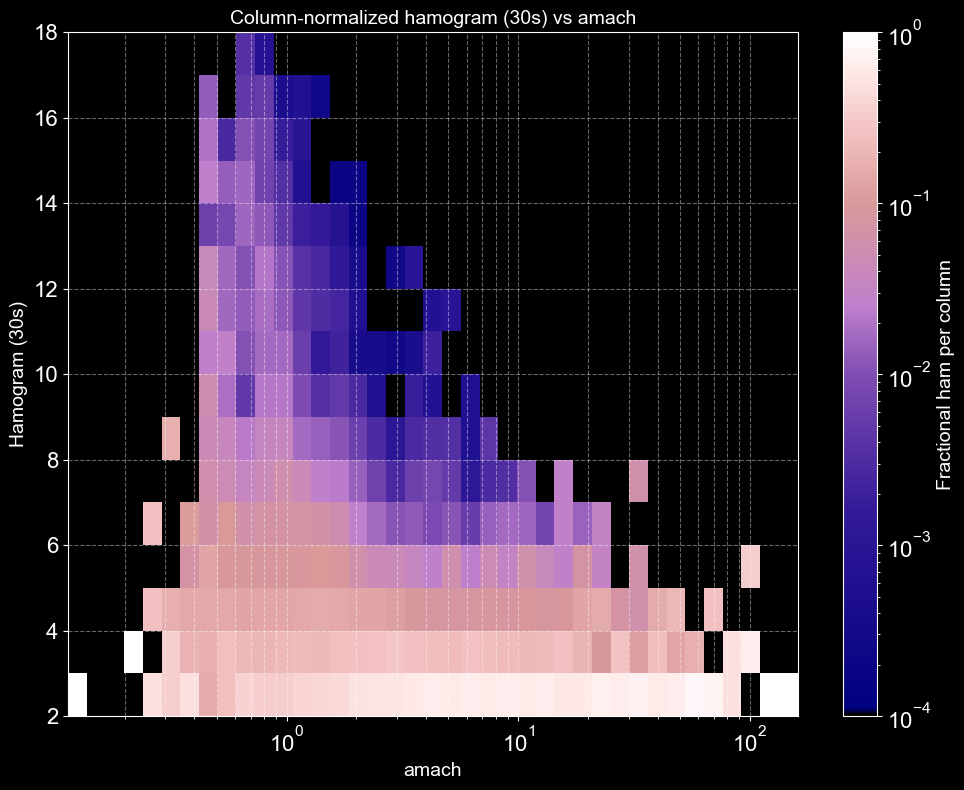

In [124]:
histoham(amach_up_data_all,ham_data_all, varname='amach')

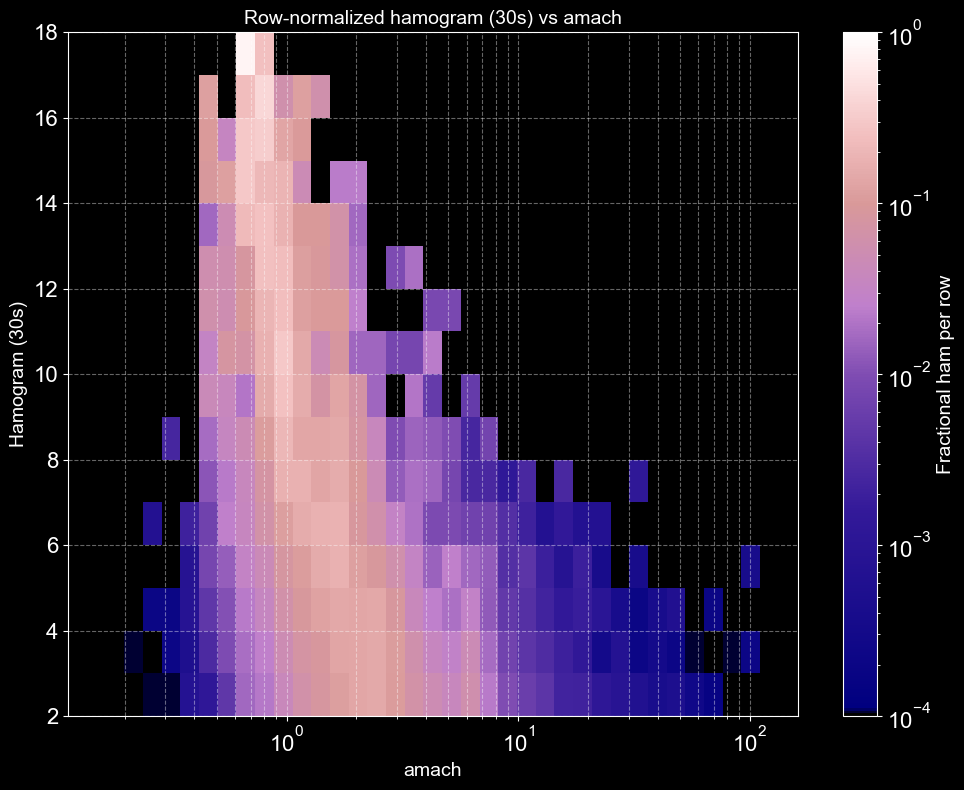

In [67]:
histoham(amach_up_data_all,ham_data_all, varname='amach', row_norm=True)

⚠️ Adjusting var_min from 0.0 to 1e-4 for log binning


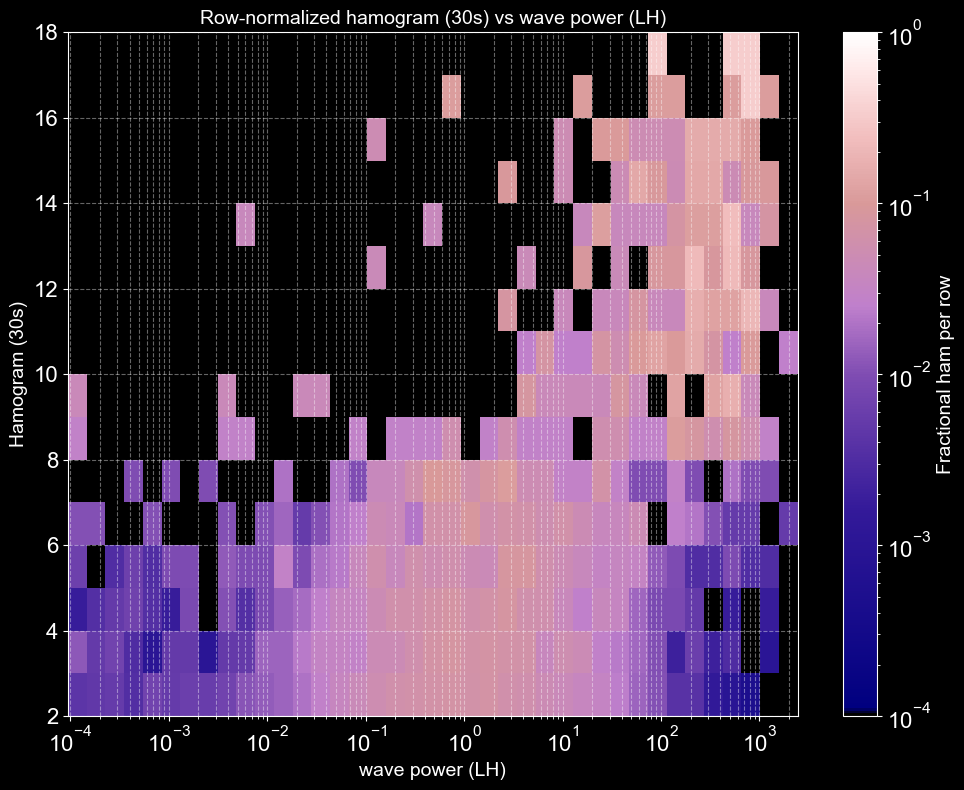

In [72]:
histoham(wavepow_LH_up_data_all, ham_data_all, varname='wave power (LH)', row_norm=True)

26-May-25 19:35:10: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/2963933071.py:81: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_norm.sum(axis=1, keepdims=True)



⚠️ Adjusting var_min from 0.0 to 1e-4 for log binning


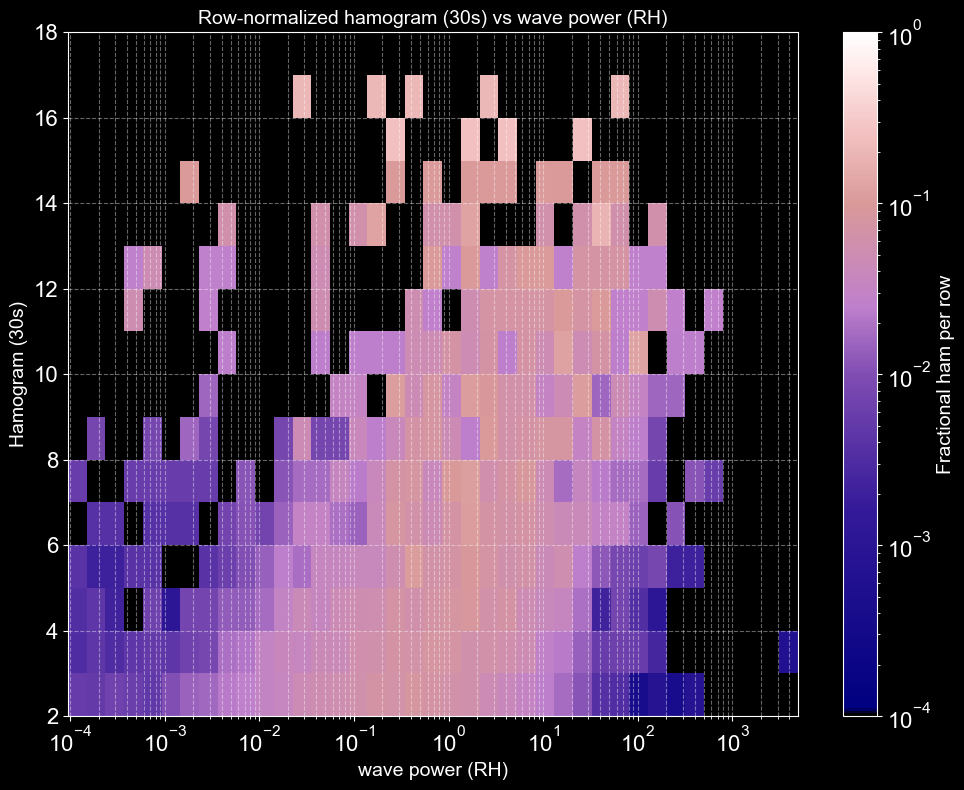

In [73]:
histoham(wavepow_RH_up_data_all, ham_data_all, varname='wave power (RH)', row_norm=True)

In [71]:
max(wavepow_LH_up_data_all)

40979.17668538615

⚠️ Adjusting var_min from 0.0 to 1e-4 for log binning


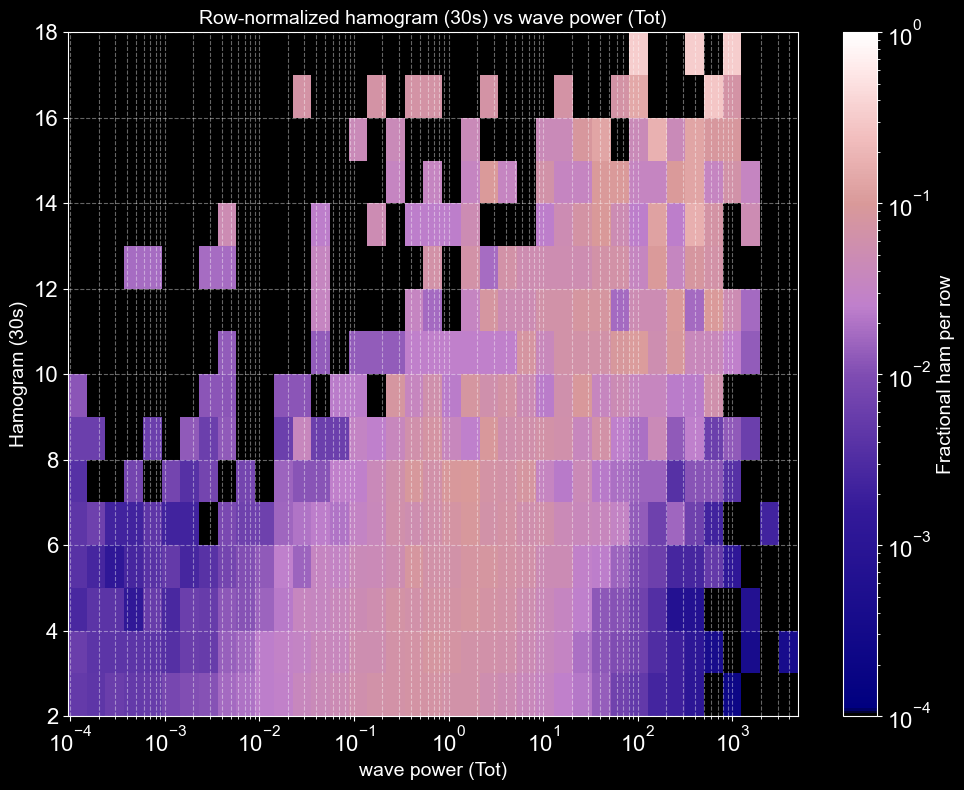

In [74]:
histoham(wavepow_tot_up_data_all, ham_data_all, varname='wave power (Tot)', row_norm=True)

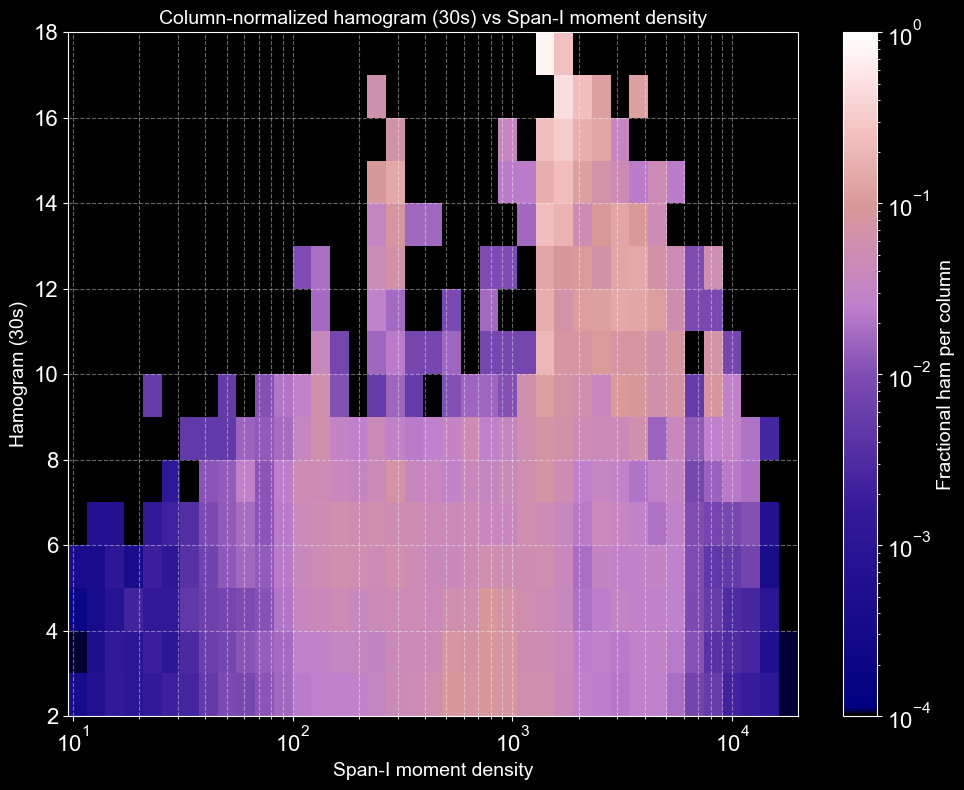

In [120]:

histoham(density_up_data_all,ham_data_all, varname='Span-I moment density', var_min = 10)

In [99]:
from matplotlib.colors import Normalize

def histohamvar(var, ham_var, hamvar_max , ham_varname = 'Ham Variable', varname='Variable', col_norm = None, bins = 40, cmap = cmap3):
    """
    Creates a column-normalized, log-scaled, dark-themed 2D histogram
    of HAM against any continuous variable, with large font sizes.

    Parameters:
    - var: 1D array-like of continuous variable (e.g., amach)
    - ham: 1D array-like of HAM counts (integer-like)
    - varname: string, name to display on x-axis
    """
    var = np.asarray(var, dtype=float)
    ham_var = np.asarray(ham_var, dtype=float)
    
    # Filter: finite values,
    valid = np.isfinite(var) & np.isfinite(ham_var)
    var = var[valid]
    ham_var = ham_var[valid]

    if len(var) == 0 or len(ham_var) == 0:
        print("⚠️ No valid data to plot.")
        return

    # Define bins
    x_bins = np.logspace(np.log10(np.nanmin(var)*0.95), np.log10(np.nanmax(var)*1.05), bins)
    y_bins = np.logspace(np.log10(np.nanmin(ham_var)*0.95), np.log10(hamvar_max), bins)

    # 2D Histogram
    H, xedges, yedges = np.histogram2d(var, ham_var, bins=[x_bins, y_bins])

    # H is shape (len(x_bins)-1, len(y_bins)-1)
    if col_norm is not None:
        # Normalize each column (each var bin = one column of HAM counts)
        H_norm = H.T  # Transpose to get HAM vs VAR for easier column-wise op
        H_colsum = H_norm.sum(axis=0, keepdims=True)
        H_norm = H_norm / H_colsum
        H_norm = np.nan_to_num(H_norm, nan=0.0)  # clean up any NaNs from div by 0
        norm = Normalize(vmin=0, vmax=1)  # linear scale
    else:
        H_norm = H.T
        max_val = np.nanmax(H_norm)
        norm = colors.LogNorm(vmin=1, vmax=max_val)
    # Plot
    plt.style.use('dark_background')
    fig, ax = plt.subplots(figsize=(10, 8))

    # After normalization
    nonzero = H_norm[H_norm > 0]
    vmin = max(np.percentile(nonzero, 1), 1e-4)
    vmax = np.percentile(nonzero, 99)

    mesh = ax.pcolormesh(
        xedges, yedges, H_norm,
        cmap=cmap3,
        norm=colors.LogNorm(vmin=vmin, vmax=vmax)
    )

    


    # Colorbar
    cb = fig.colorbar(mesh, ax=ax)
    if col_norm is not None:
        cb.set_label('Fractional ham per column', fontsize = 14, color = 'white')
        ax.set_title(f'Column-normalized {ham_varname} vs {varname}', fontsize=14, color = 'white')
    else:
        cb.set_label('Hamogram Occurances', fontsize = 14, color = 'white')
        ax.set_title(f'Unnormalized {ham_varname} vs {varname}', fontsize=14, color = 'white')

    cb.ax.tick_params(labelsize=16, colors='white')

    ax.set_xscale('log')
    #import matplotlib.ticker as ticker
    #ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%g'))
    #from matplotlib.ticker import ScalarFormatter
   # ax.xaxis.set_major_formatter(ScalarFormatter())
    #ax.ticklabel_format(style='plain', axis='x')
    # After plotting and setting xscale/log scale:
    ax.tick_params(axis='x', labelsize=16)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_xlabel(varname, fontsize = 14, color = 'white')
    ax.set_ylabel(ham_varname, fontsize = 14, color = 'white')

    ax.tick_params(colors='white', labelsize=16)

    cb.ax.yaxis.set_tick_params(color='white')
    plt.setp(cb.ax.yaxis.get_ticklabels(), color='white')

    ax.grid(True, which='both', linestyle='--', alpha=0.4)

    ax.tick_params(axis='both', labelsize=16)
    ax.xaxis.offsetText.set_fontsize(16)
    cb.ax.tick_params(labelsize=16)
    plt.tight_layout()
    plt.show()

    peak_ham_idx = np.argmax(H_norm, axis=0)  # max row index in each column
    peak_ham_val = y_bins[peak_ham_idx]       # convert to HAM values

    plt.figure()
    plt.plot(x_bins[:-1], peak_ham_val, marker='o')
    plt.xscale('log')
    plt.xlabel('AMach')
    plt.ylabel('HAM value with max density')
    plt.title('Most Frequent HAM per AMach Bin')
    plt.grid(True, which='both')
    plt.show()

    print("Max per column (should be ~1):", np.round(np.nanmax(H_norm, axis=0), 3))
    print("Global max (used for vmax):", np.round(np.nanmax(H_norm), 3))

In [103]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.cm as cm

def histohamvar_columnwise(var, ham_var,
                            hamvar_min=None, hamvar_max=None,
                            var_min=None, var_max=None,
                            bins=40,
                            cmap='plasma',
                            ham_varname='Ham Variable', varname='Variable'):
    """
    Create a per-column normalized 2D histogram of ham_var vs var.

    Parameters:
    - var: x-axis variable (e.g., AMach)
    - ham_var: y-axis variable (e.g., ham temperature)
    - hamvar_min: optional lower limit for ham_var bins (default: 95% of min)
    - hamvar_max: optional upper limit for ham_var bins (default: 105% of max)
    - bins: number of bins (default 40)
    - cmap: matplotlib colormap name
    - ham_varname: y-axis label
    - varname: x-axis label
    """
    var = np.asarray(var, dtype=float)
    ham_var = np.asarray(ham_var, dtype=float)
    
    valid = np.isfinite(var) & np.isfinite(ham_var)
    var = var[valid]
    ham_var = ham_var[valid]

    if len(var) == 0 or len(ham_var) == 0:
        print("⚠️ No valid data to plot.")
        return

    # Set bin limits
    if hamvar_min is None:
        hamvar_min = np.nanmin(ham_var) * 0.95
    if hamvar_max is None:
        hamvar_max = np.nanmax(ham_var) * 1.05

    if var_min is None:
        var_min = np.nanmin(var) * 0.95
    if var_max is None:
        var_max = np.nanmax(var) * 1.05

    # Define bins
    x_bins = np.logspace(np.log10(var_min), np.log10(var_max), bins)
    y_bins = np.logspace(np.log10(hamvar_min), np.log10(hamvar_max), bins)

    # 2D Histogram
    H, xedges, yedges = np.histogram2d(var, ham_var, bins=[x_bins, y_bins])
    H = H.T  # rows = ham_var bins, cols = var bins

    # Plot
    plt.style.use('dark_background')
    fig, ax = plt.subplots(figsize=(10, 8))
    cmap_obj = cm.get_cmap(cmap)

    # Normalize and plot per column
    for i in range(H.shape[1]):
        column = H[:, i]
        col_max = np.max(column)
        if col_max > 0:
            col_norm = column / col_max
            for j in range(H.shape[0]):
                val = col_norm[j]
                if val == 0:
                    continue
                x0, x1 = xedges[i], xedges[i+1]
                y0, y1 = yedges[j], yedges[j+1]
                color = cmap_obj(val)
                ax.fill_between([x0, x1], y0, y1, color=color, linewidth=0)

    # Axes formatting
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlabel(varname, fontsize=16, color='white')
    ax.set_ylabel(ham_varname, fontsize=16, color='white')
    ax.set_title(f'Per-column normalized {ham_varname} vs {varname}', fontsize=18, color='white')
    ax.tick_params(colors='white', labelsize=14)
    ax.grid(True, which='both', linestyle='--', alpha=0.4)

    # Colorbar
    sm = cm.ScalarMappable(cmap=cmap_obj, norm=mcolors.Normalize(vmin=0, vmax=1))
    sm.set_array([])
    cb = fig.colorbar(sm, ax=ax, pad=0.02)
    cb.set_label('Per-column normalized frequency', fontsize=14, color='white')
    cb.ax.tick_params(labelsize=12, colors='white')
    plt.setp(cb.ax.yaxis.get_ticklabels(), color='white')

    from collections import Counter
    counts = Counter(np.round(ham_var, 3))
    print("Top ham_var values:", counts.most_common(5))



    plt.tight_layout()
    plt.show()

    plt.figure()
    plt.hist(ham_var, bins=np.logspace(np.log10(hamvar_min), np.log10(hamvar_max), 100))
    plt.xscale('log')
    plt.title('Histogram of ham_var')
    plt.show()

    bin_idx = np.digitize([3.276], yedges) - 1
    print(f"Row index for 3.276: {bin_idx[0]}")
    print(f"Y-bin range: {yedges[bin_idx[0]]:.3g} to {yedges[bin_idx[0] + 1]:.3g}")




26-May-25 20:06:20: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/3744951614.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



Top ham_var values: [(0.0, 3220827), (0.001, 6357), (3.276, 6308), (0.002, 3465), (0.003, 2712)]


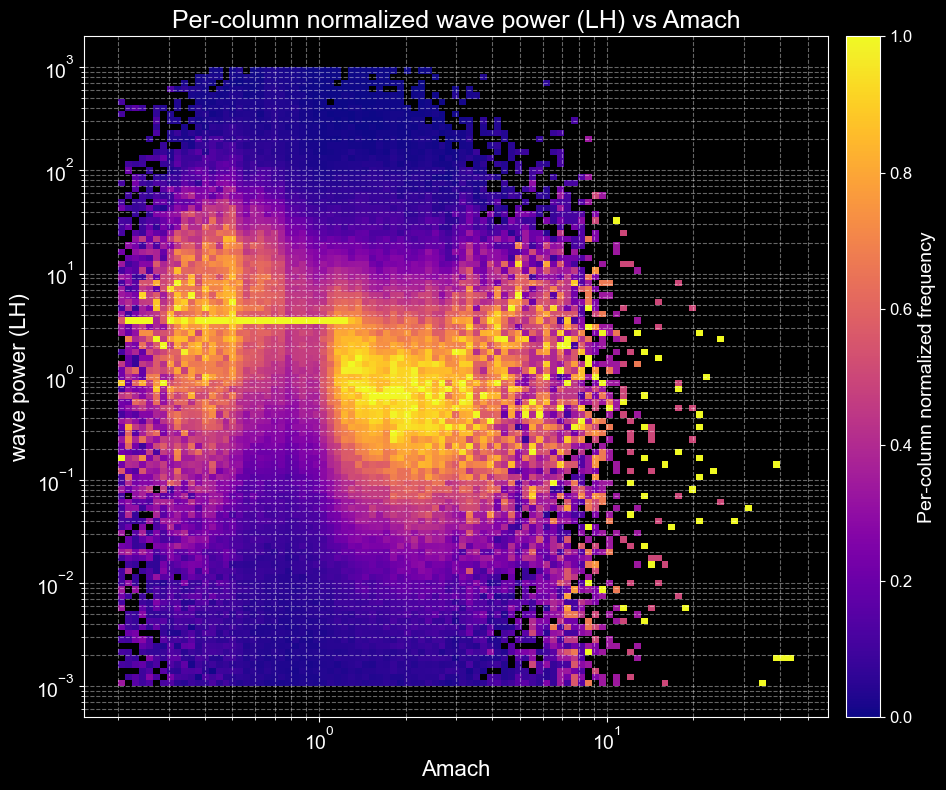

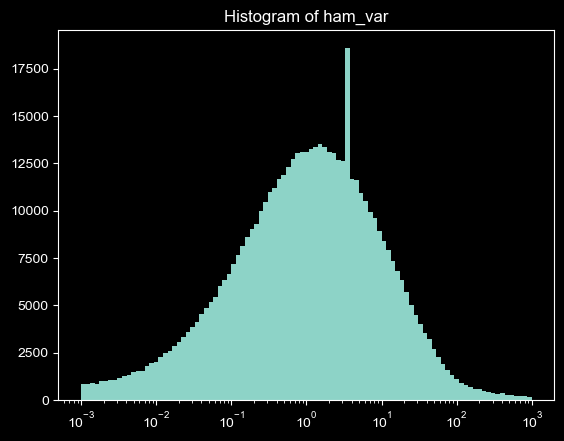

Row index for 3.276: 58
Y-bin range: 3.27 to 3.76


In [104]:
histohamvar_columnwise(amach_up_data_all,wavepow_LH_up_data_all,hamvar_min = 1e-3, hamvar_max = 1e3, var_min= .2, var_max= 50,ham_varname='wave power (LH)', bins = 100,varname = 'Amach')

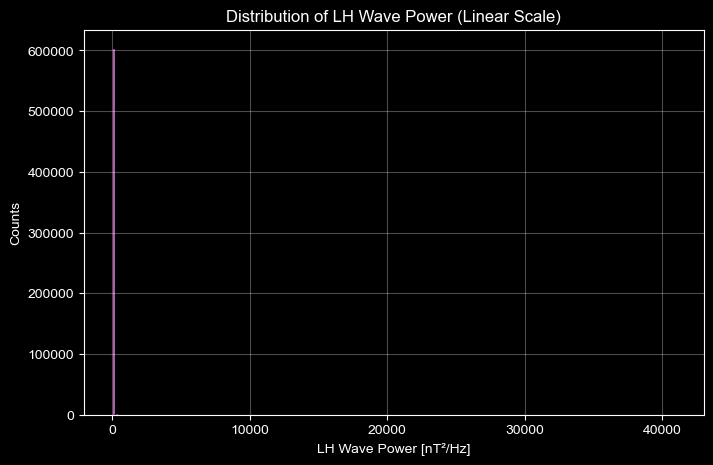

In [105]:
import matplotlib.pyplot as plt
import numpy as np

# Clean your array
wavepower = np.asarray(wavepow_LH, dtype=float)
wavepower = wavepower[np.isfinite(wavepower) & (wavepower > 0)]

plt.figure(figsize=(8, 5))
plt.hist(wavepower, bins=200, color='orchid', edgecolor='black')
plt.xlabel('LH Wave Power [nT²/Hz]')
plt.ylabel('Counts')
plt.title('Distribution of LH Wave Power (Linear Scale)')
plt.grid(True, alpha=0.3)
plt.show()


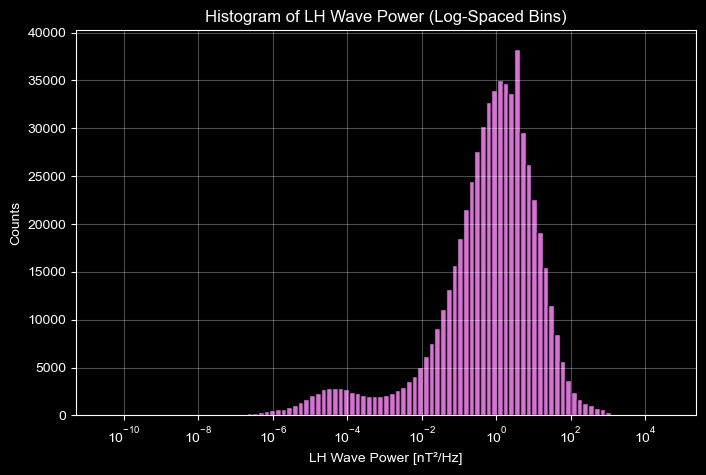

In [107]:
bins = np.logspace(np.log10(np.nanmin(wavepower)), np.log10(np.nanmax(wavepower)), 100)

plt.figure(figsize=(8, 5))
plt.hist(wavepower, bins=bins, color='orchid', edgecolor='black')
plt.xscale('log')
plt.xlabel('LH Wave Power [nT²/Hz]')
plt.ylabel('Counts')
plt.title('Histogram of LH Wave Power (Log-Spaced Bins)')
plt.grid(True, which='both', alpha=0.3)
plt.show()


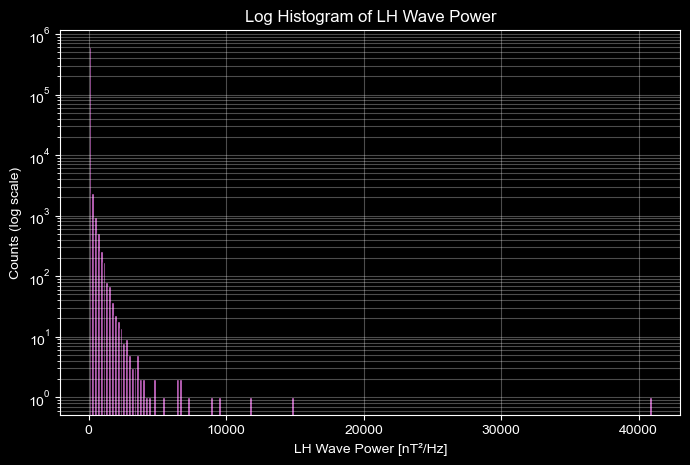

In [106]:
plt.figure(figsize=(8, 5))
plt.hist(wavepower, bins=200, color='orchid', edgecolor='black')
plt.yscale('log')
plt.xlabel('LH Wave Power [nT²/Hz]')
plt.ylabel('Counts (log scale)')
plt.title('Log Histogram of LH Wave Power')
plt.grid(True, which='both', alpha=0.3)
plt.show()


In [76]:

histohamvar(wavepow_LH_up_data_all,ham_trat_up_data_all, hamvar_max = 20, ham_varname='Ham Tperp/Tpar', varname = 'Wave Power (LH)',bins = 40, cmap = 'plasma', col_norm=True)

NameError: name 'histohamvar' is not defined

26-May-25 10:37:12: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



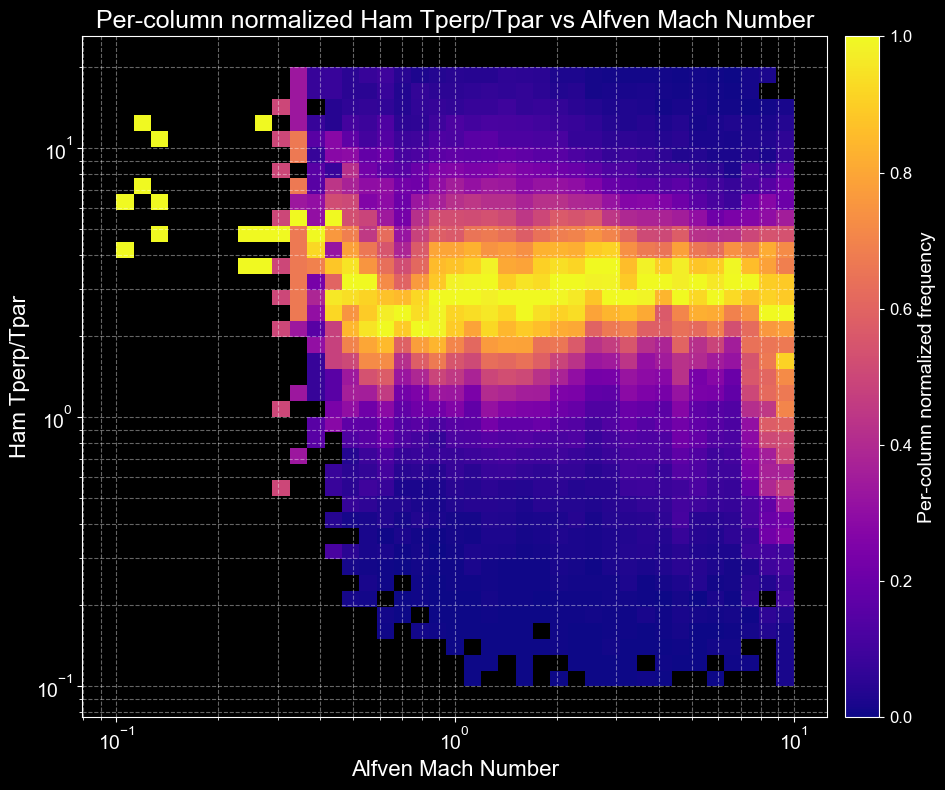

In [141]:
histohamvar_columnwise(amach_up_data_all,ham_trat_up_data_all, hamvar_min = .1, hamvar_max = 20, var_min = .1, var_max = 10,ham_varname='Ham Tperp/Tpar', varname = 'Alfven Mach Number')

26-May-25 19:38:46: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



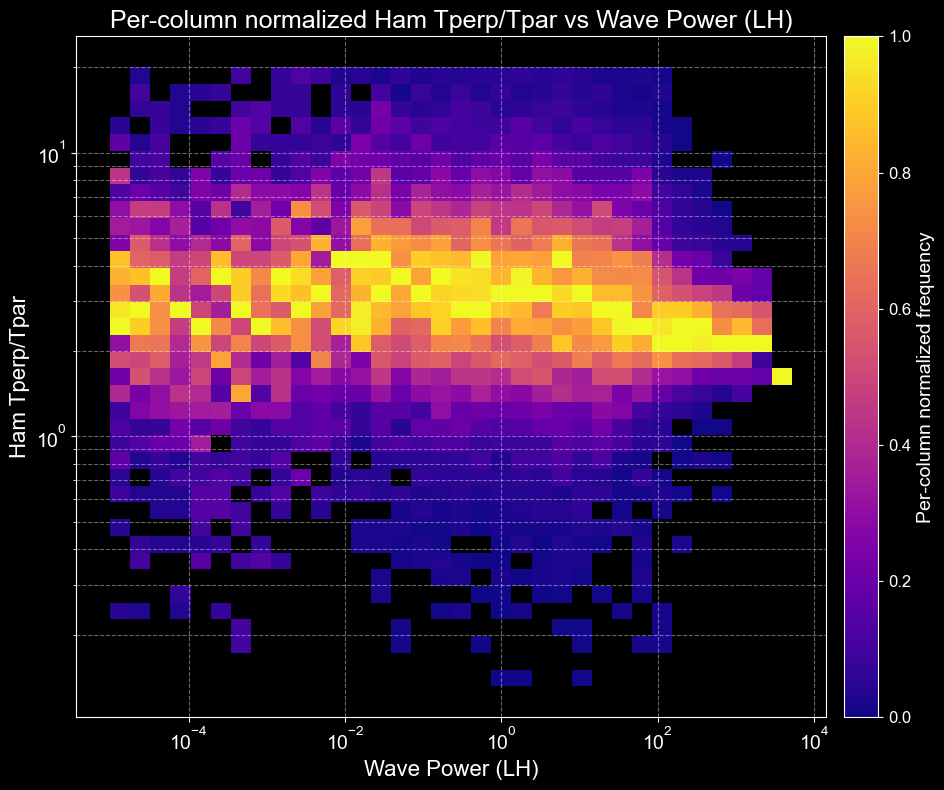

In [79]:
histohamvar_columnwise(wavepow_LH_up_data_all,ham_trat_up_data_all, hamvar_min = .1, hamvar_max = 20, var_min = 1e-5, var_max = 1e5, ham_varname='Ham Tperp/Tpar', varname = 'Wave Power (LH)')

26-May-25 10:53:14: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



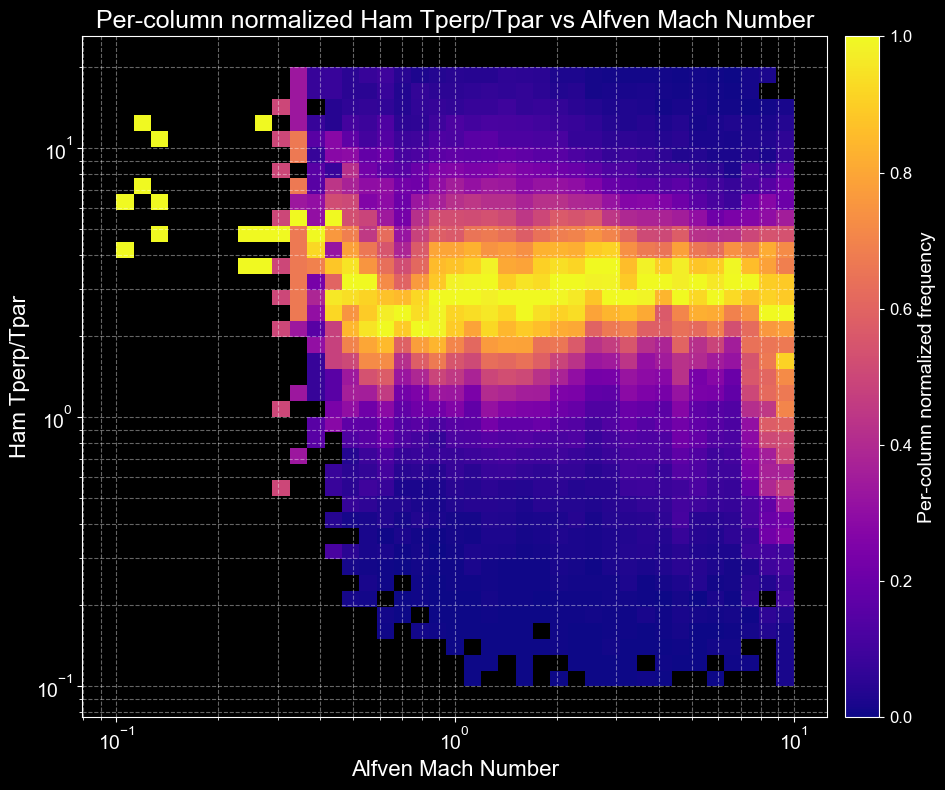

In [159]:
histohamvar_columnwise(amach_up_data_all,ham_trat_up_data_all, hamvar_min = .1, hamvar_max = 20, var_min = .1, var_max = 10,ham_varname='Ham Tperp/Tpar', varname = 'Alfven Mach Number',bins = 40)

27-May-25 00:29:07: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/3744951614.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



Top ham_var values: [(2.706, 48), (3.085, 46), (2.866, 45), (3.066, 43), (3.456, 43)]


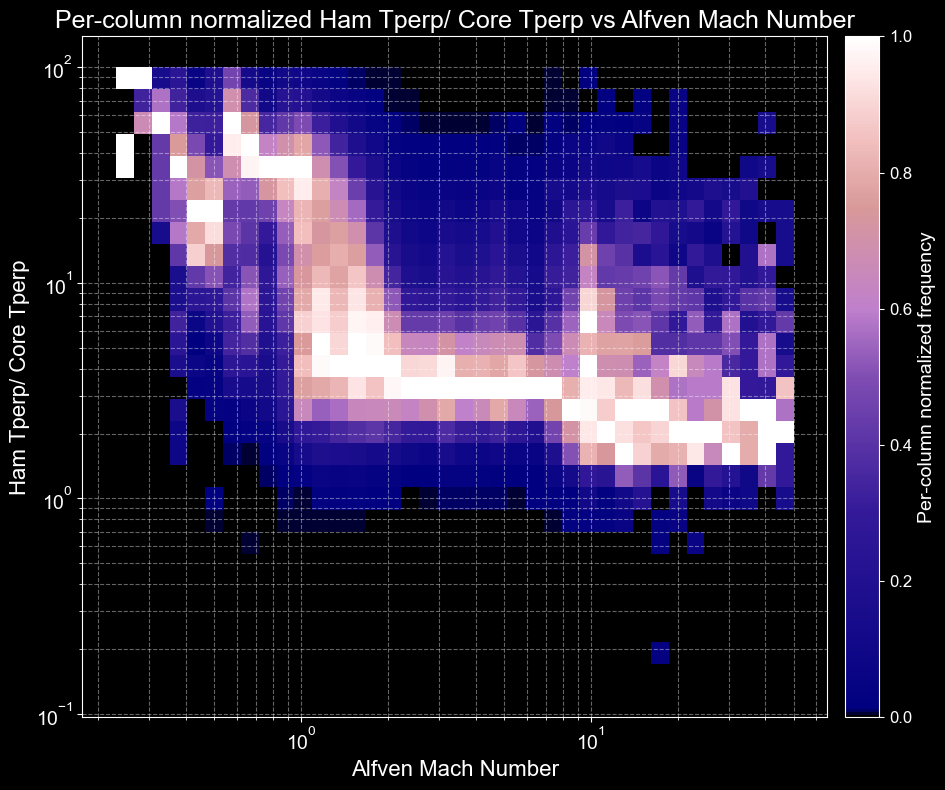

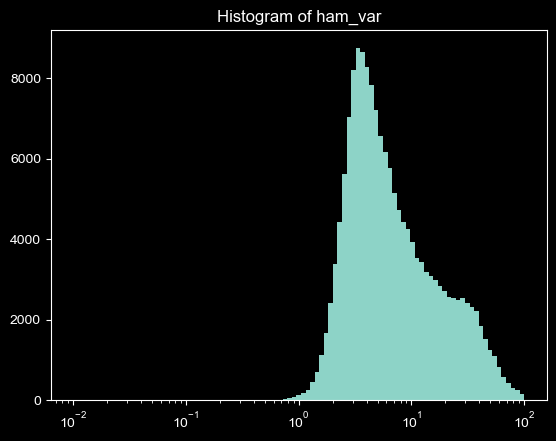

Row index for 3.276: 24
Y-bin range: 2.89 to 3.67


In [111]:
histohamvar_columnwise(amach_up_data_all,ham_tperp_div_core_up_data_all, hamvar_min = .01, hamvar_max = 100, var_min= .2, var_max = 50, ham_varname='Ham Tperp/ Core Tperp', varname = 'Alfven Mach Number', cmap = cmap3)

26-May-25 19:40:07: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



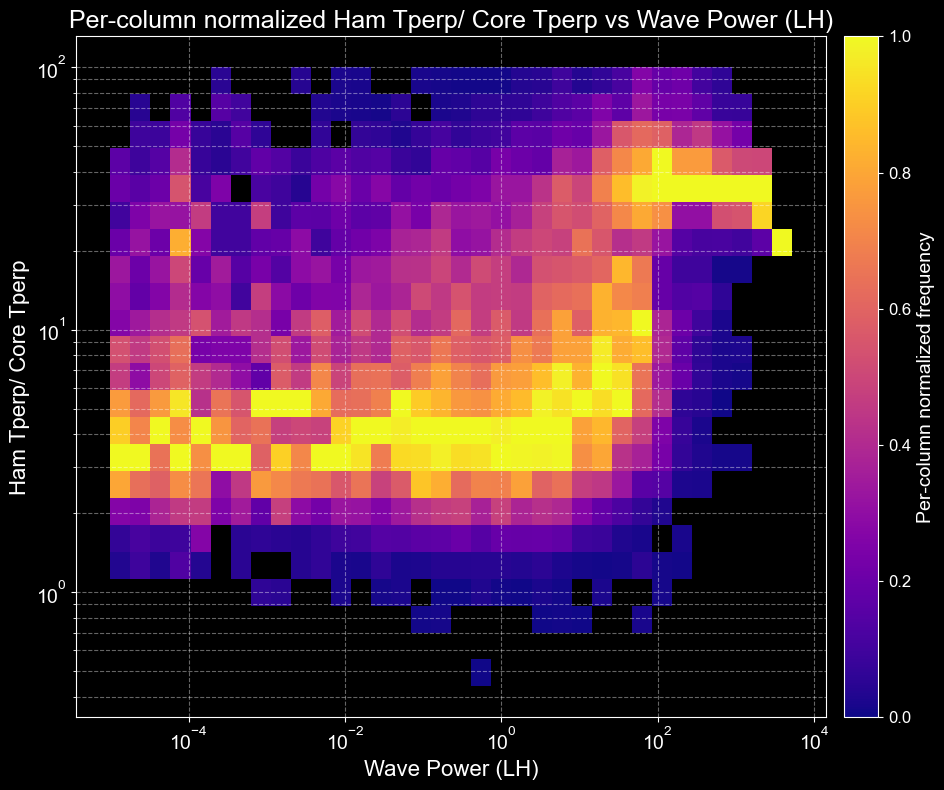

In [80]:
histohamvar_columnwise(wavepow_LH_up_data_all,ham_tperp_div_core_up_data_all, hamvar_min = .01, hamvar_max = 100, var_min= 1e-5, var_max = 1e5, ham_varname='Ham Tperp/ Core Tperp', varname = 'Wave Power (LH)')

27-May-25 00:27:48: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/3744951614.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



Top ham_var values: [(2.706, 48), (3.085, 46), (2.866, 45), (3.066, 43), (3.456, 43)]


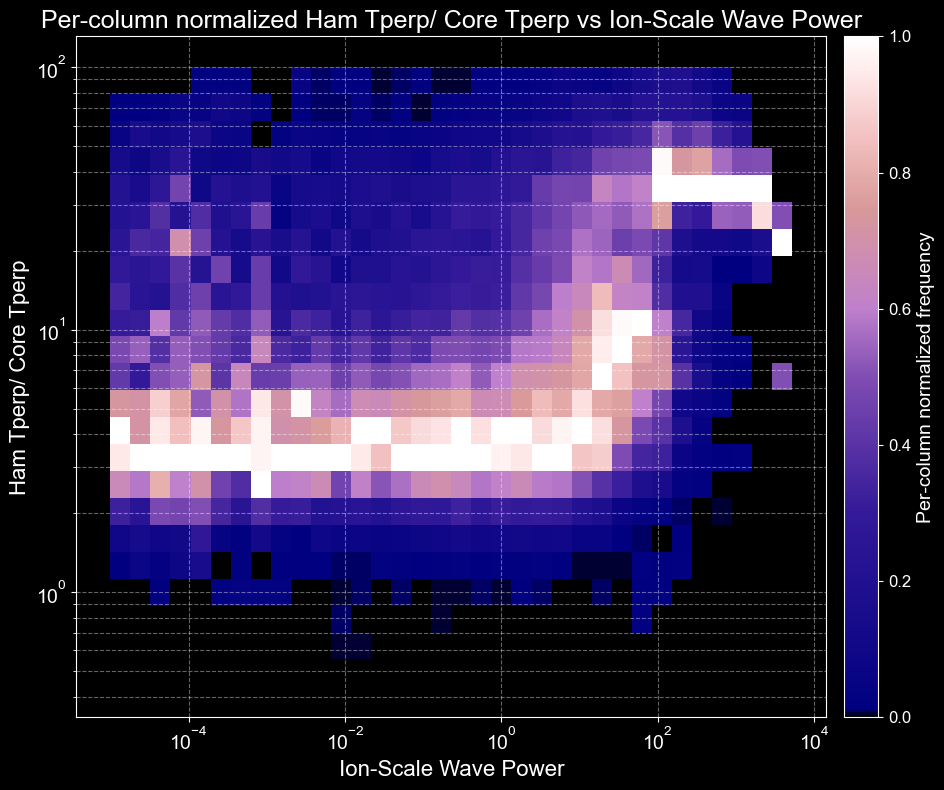

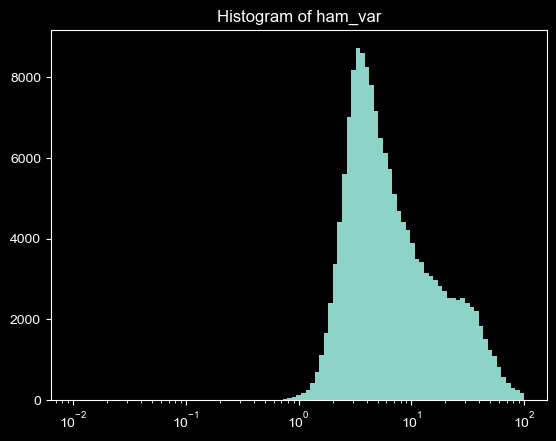

Row index for 3.276: 24
Y-bin range: 2.89 to 3.67


In [110]:
histohamvar_columnwise(wavepow_tot_up_data_all,ham_tperp_div_core_up_data_all, hamvar_min = .01, hamvar_max = 100, var_min= 1e-5, var_max = 1e5, ham_varname='Ham Tperp/ Core Tperp', varname = 'Ion-Scale Wave Power', cmap = cmap3)

26-May-25 19:58:51: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/1279414337.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



Top histogram bin counts: [1244. 1207. 1164. 1157. 1132.  995.  887.  820.  809.  696.]


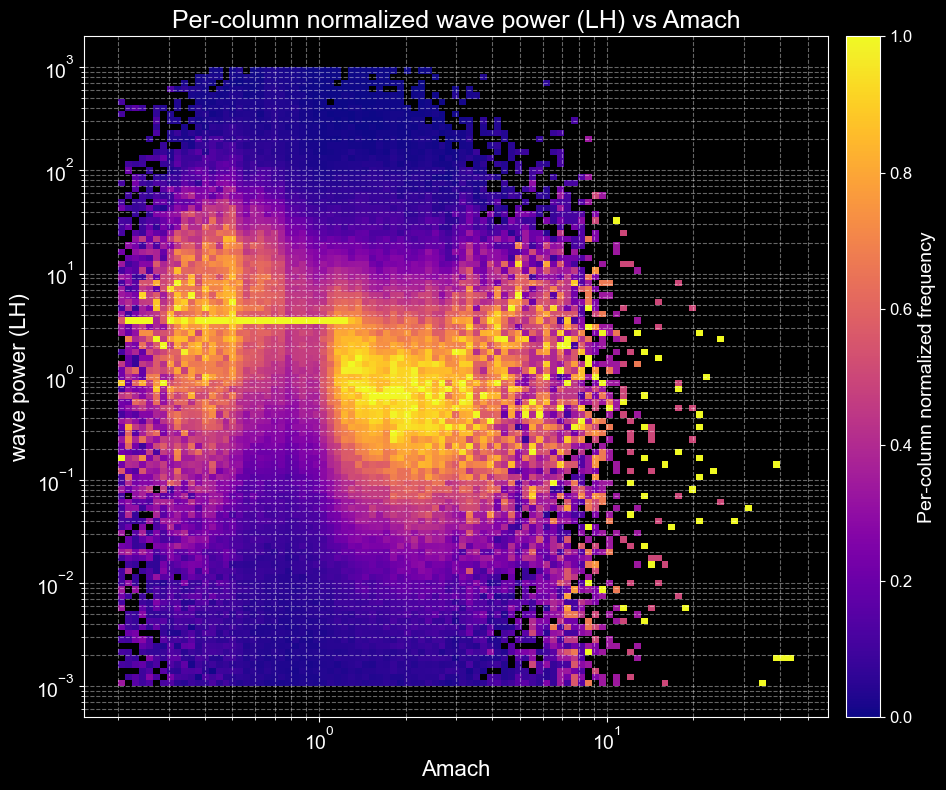

In [100]:
histohamvar_columnwise(amach_up_data_all,wavepow_LH_up_data_all,hamvar_min = 1e-3, hamvar_max = 1e3, var_min= .2, var_max= 50,ham_varname='wave power (LH)', bins = 100,varname = 'Amach')

26-May-25 19:51:30: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



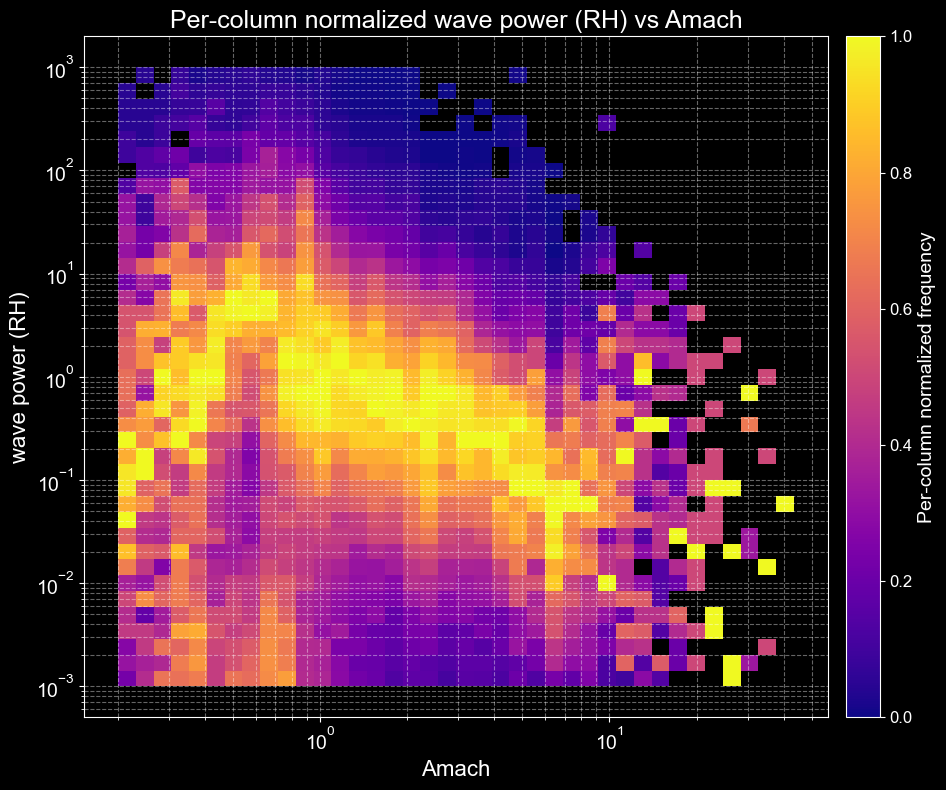

In [92]:
histohamvar_columnwise(amach_up_data_all,wavepow_RH_up_data_all,hamvar_min = 1e-3, hamvar_max = 1e3, var_min= .2, var_max= 50, ham_varname='wave power (RH)', varname = 'Amach')

27-May-25 00:42:02: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/3744951614.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



Top ham_var values: [(2.706, 48), (3.085, 46), (2.866, 45), (3.066, 43), (3.456, 43)]


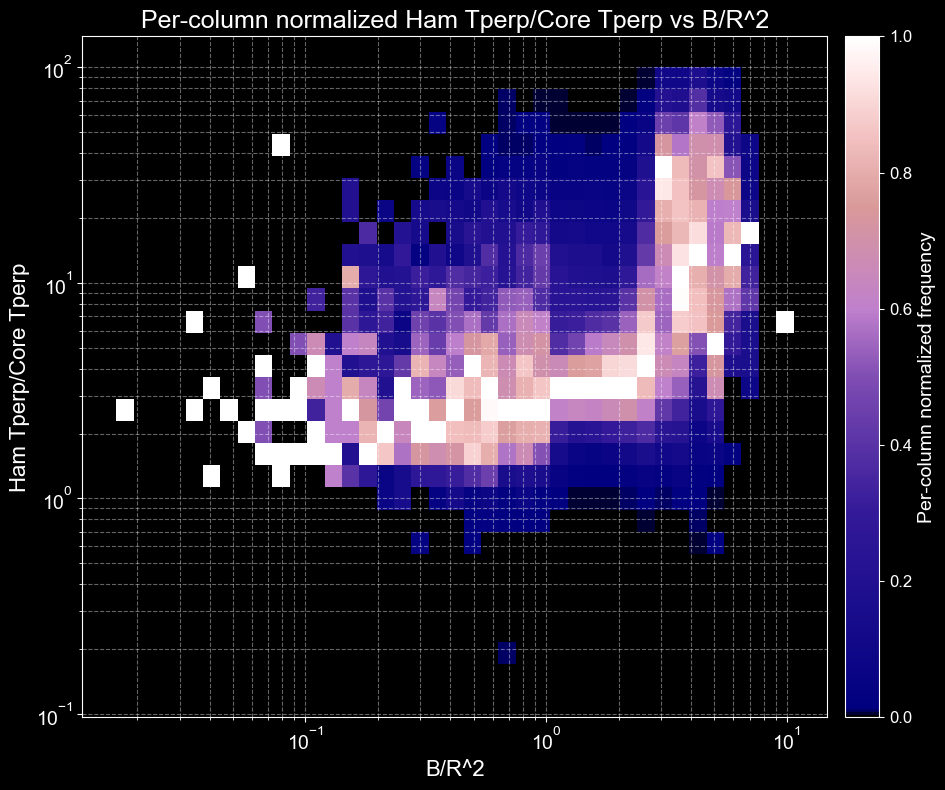

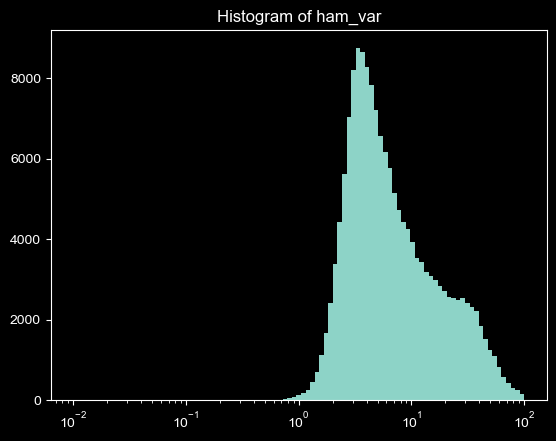

Row index for 3.276: 24
Y-bin range: 2.89 to 3.67


In [112]:
B_norm = bmag_up_data_all*((sun_dist_rsun_up_data_all/215)**2)
histohamvar_columnwise(B_norm,ham_tperp_div_core_up_data_all, hamvar_min = .01, hamvar_max = 100, ham_varname='Ham Tperp/Core Tperp', varname = 'B/R^2', cmap = cmap3)

26-May-25 19:52:11: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_24528/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



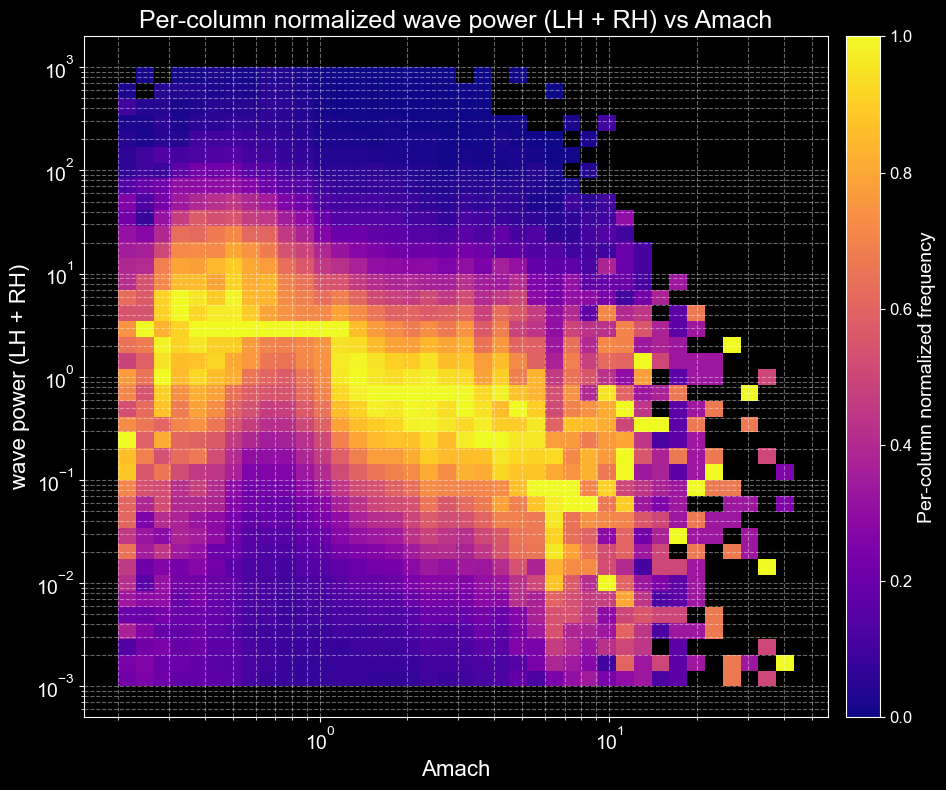

In [93]:
histohamvar_columnwise(amach_up_data_all,wavepow_tot_up_data_all,hamvar_min = 1e-3, hamvar_max = 1e3, var_min= .2, var_max= 50, ham_varname='wave power (LH + RH)', varname = 'Amach')

21-May-25 19:13:26: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



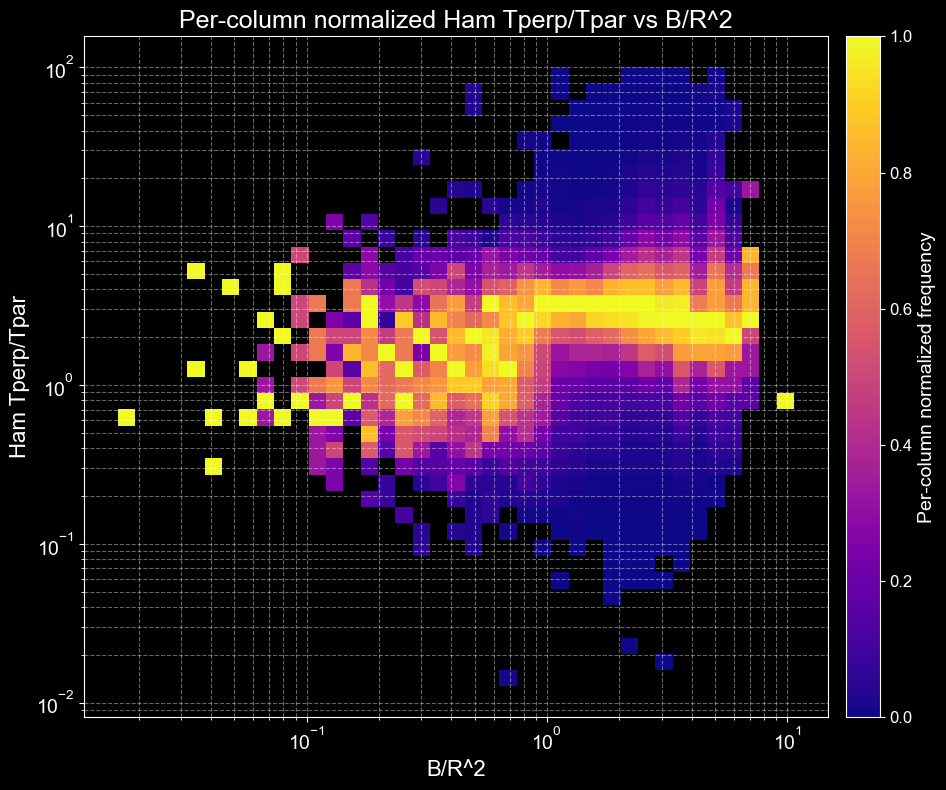

In [137]:
B_norm = bmag_up_data_all*((sun_dist_rsun_up_data_all/215)**2)
histohamvar_columnwise(B_norm,ham_trat_data_all, hamvar_min = .01, hamvar_max = 100, ham_varname='Ham Tperp/Tpar', varname = 'B/R^2')

21-May-25 19:05:28: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/1377540890.py:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



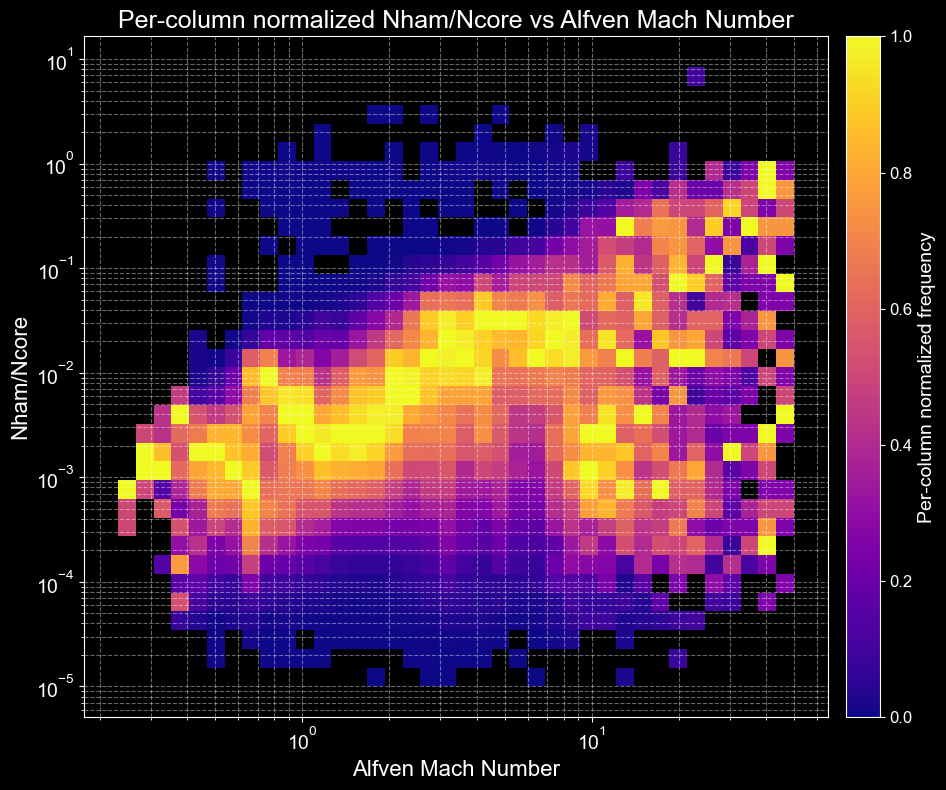

In [134]:
histohamvar_columnwise(amach_up_data_all,ham_nham_div_ncore_up_data_all, cmap = 'plasma',hamvar_min = 1e-5, hamvar_max = 100,var_min = .2, var_max = 50, ham_varname='Nham/Ncore', varname = 'Alfven Mach Number')

21-May-25 16:57:48: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/351256013.py:54: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_obj = cm.get_cmap(cmap)



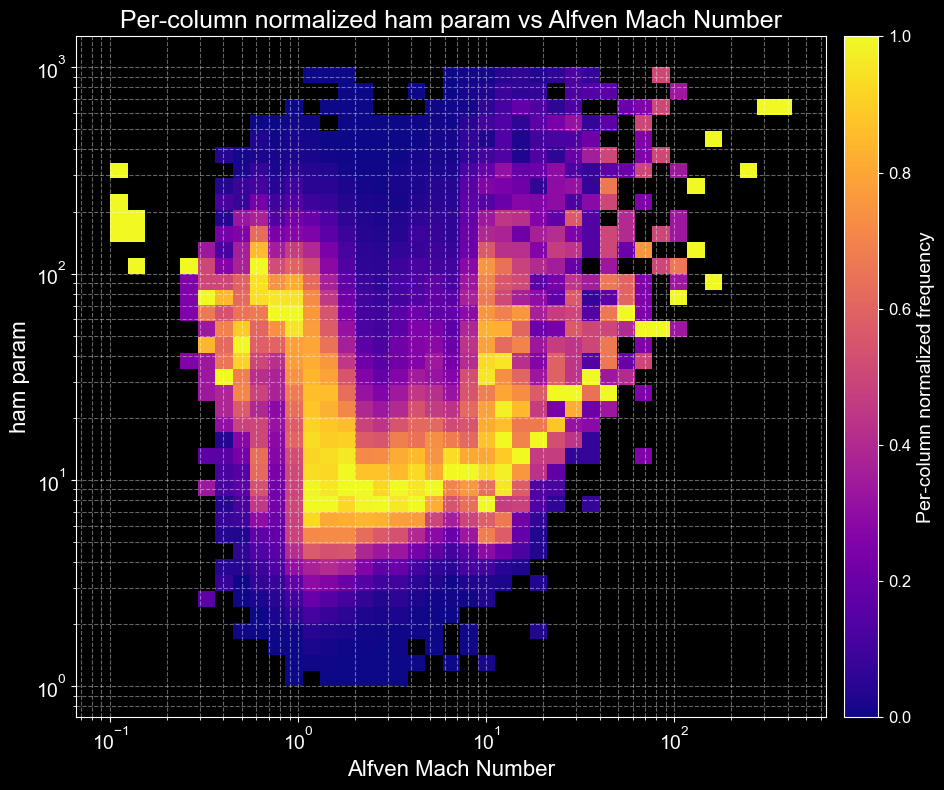

In [55]:
histohamvar_columnwise(amach_up_data_all,ham_tperprat_driftva_hc_up_data_all, hamvar_min= 1, hamvar_max= 1e3, ham_varname='ham param', varname = 'Alfven Mach Number')

In [168]:
print(len(combined_df['epoch']))
print(len(ham_data_all))
print(len(anisotropy_up_data_all))

3915261
3826316
3826316


In [162]:
import matplotlib.pyplot as plt

def plot_wave_power(df):
    plt.figure(figsize=(12, 6))

    # If your columns are renamed per date, adjust this to plot all LH and RH columns
    # For example, select all columns containing 'wavePower_LH'
    lh_cols = [col for col in df.columns if 'wavePower_LH' in col]
    rh_cols = [col for col in df.columns if 'wavePower_RH' in col]

    # Plot all LH wave powers (if multiple dates)
    for col in lh_cols:
        plt.plot(df['epoch'], df[col], label=col, alpha=0.7)

    # Plot all RH wave powers (optional)
    for col in rh_cols:
        plt.plot(df['epoch'], df[col], linestyle='--', label=col, alpha=0.7)

    plt.xlabel('Time (UTC)')
    plt.ylabel('Wave Power')
    plt.title('Wave Power vs Time')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


21-May-25 16:24:41: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/387687321.py:34: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



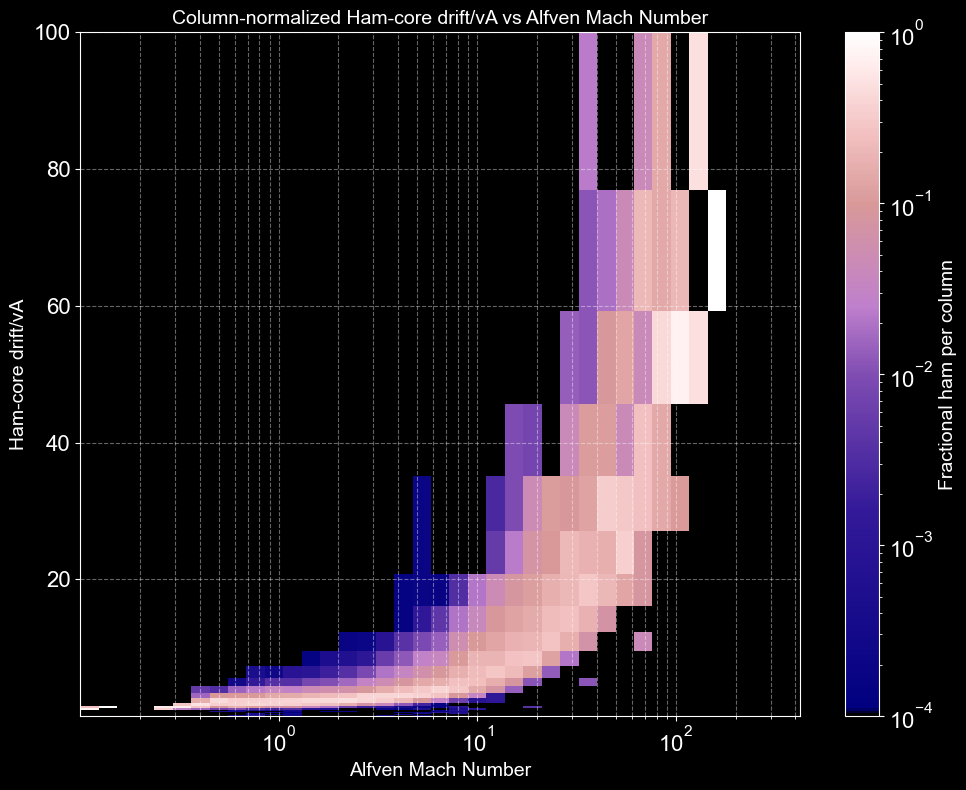

In [ ]:
histohamvar(amach_up_data_all,ham_tperp_div_core_data_all hamvar_max = 100, ham_varname='Tperp Ham/Tperp Core', varname = 'Alfven Mach Number')

21-May-25 17:28:11: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/2125078752.py:61: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



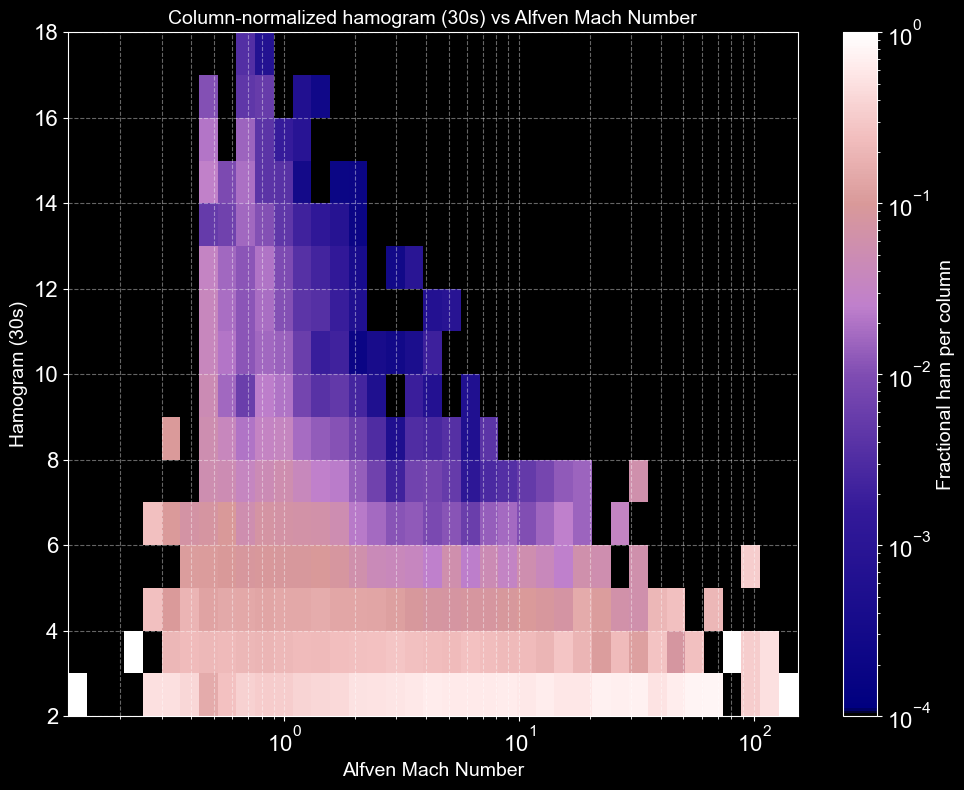

In [63]:

histoham(amach_up_data_all, ham_data_all, varname= 'Alfven Mach Number')

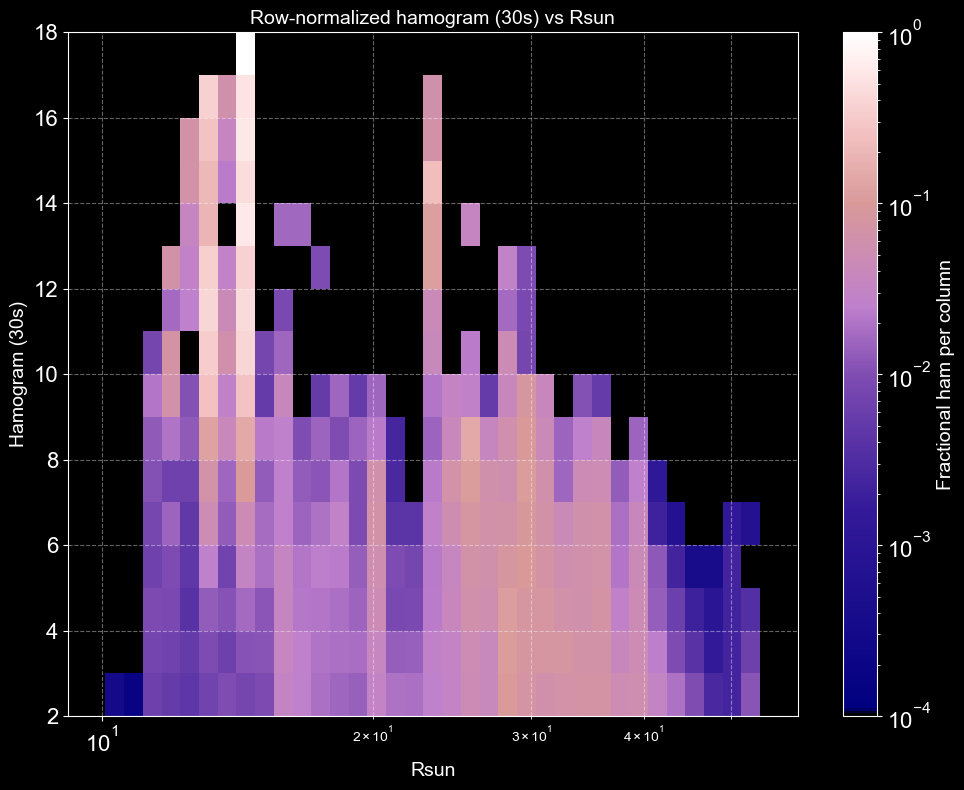

In [127]:

histoham(sun_dist_rsun_up_data_all, ham_data_all, varname= 'Rsun', row_norm=True)

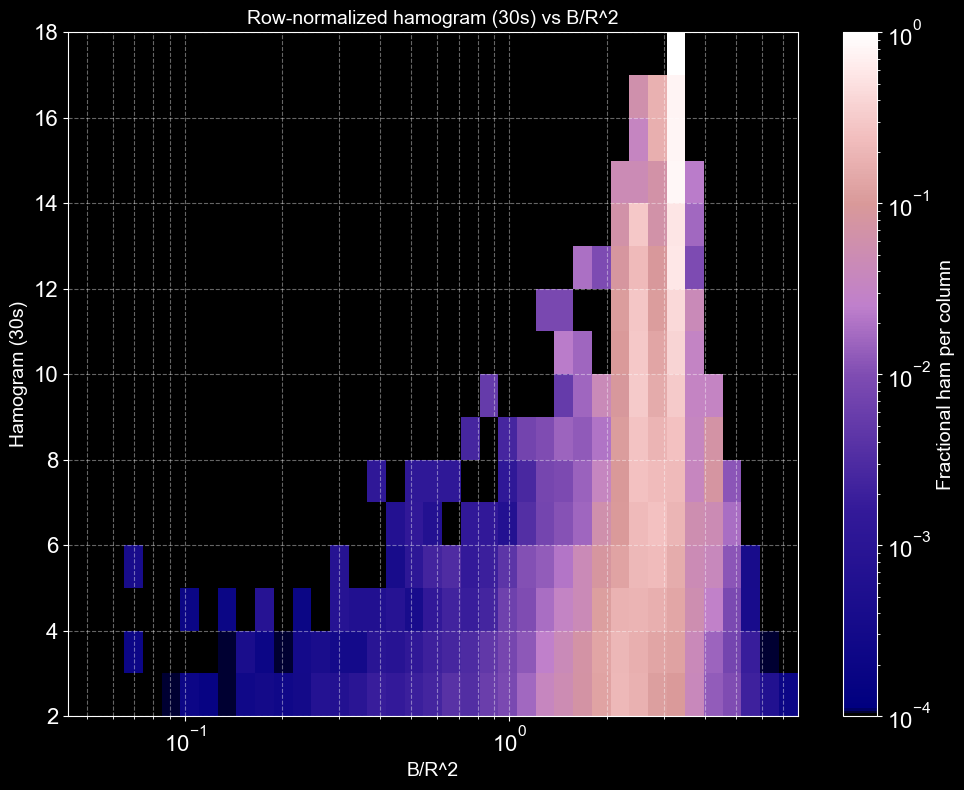

In [129]:
B_norm = bmag_up_data_all*((sun_dist_rsun_up_data_all/215)**2)


histoham(B_norm, ham_data_all, varname= 'B/R^2', row_norm=True)

In [82]:
print(density_up_data_all)

[118.14715576 118.28095245 110.02931976 ...          nan          nan
          nan]


21-May-25 18:45:10: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/2161490642.py:76: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



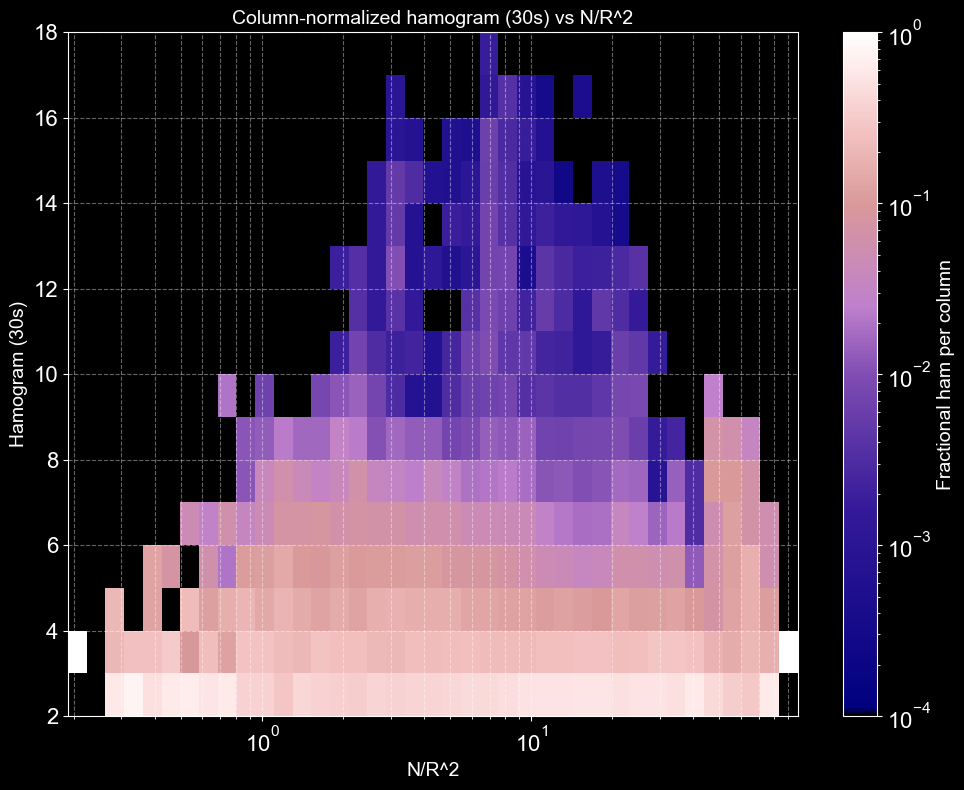

In [116]:
N_norm = density_up_data_all*((sun_dist_rsun_up_data_all/215)**2)


histoham(N_norm, ham_data_all, var_min=.2, varname= 'N/R^2')

21-May-25 18:46:52: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/2161490642.py:76: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



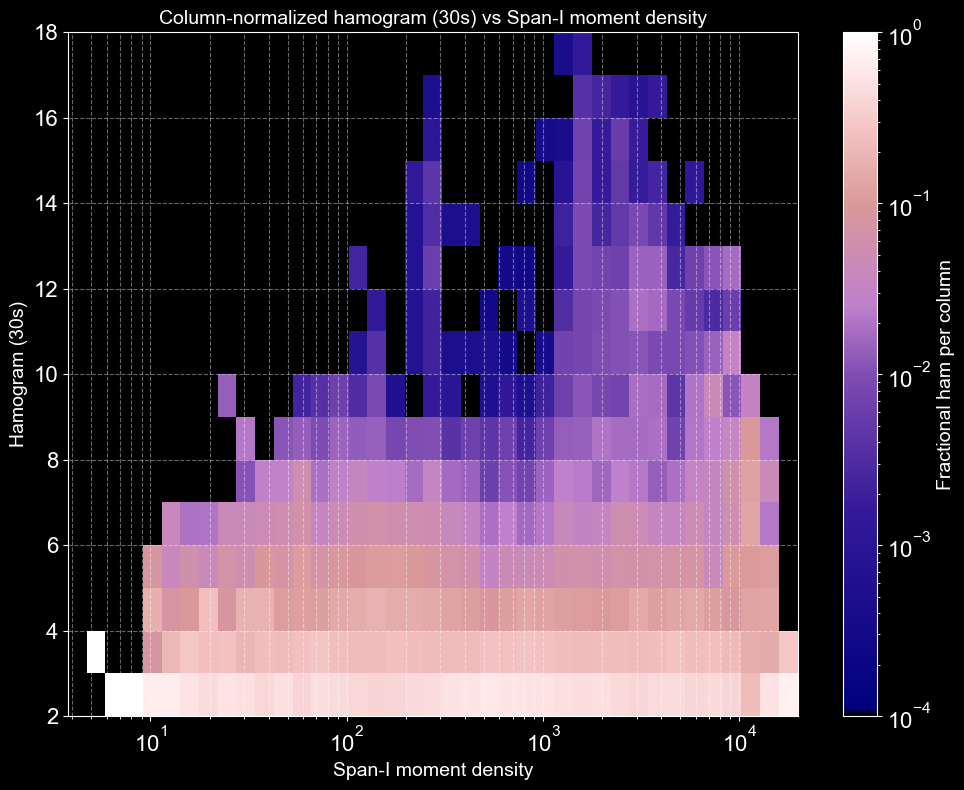

In [118]:
histoham(density_up_data_all, ham_data_all, var_min=4, varname= 'Span-I moment density')

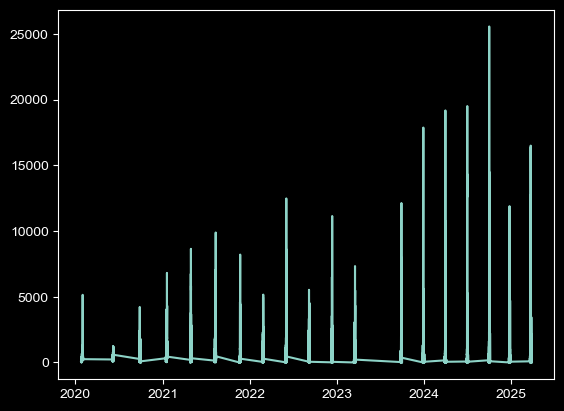

In [86]:
plt.plot(ham_time_all, density_up_data_all)

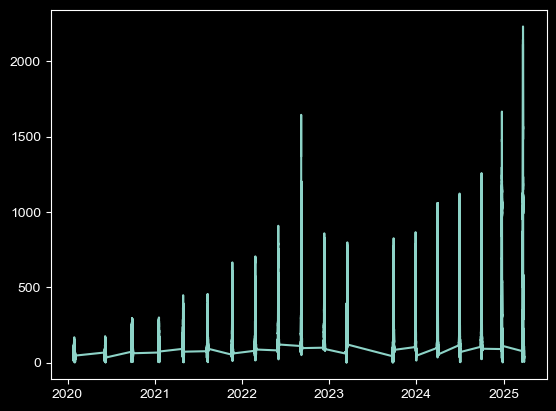

In [91]:
plt.plot(ham_time_all, bmag_up_data_all)

In [76]:
print(density_up_data_all[0:5])
print(bmag_up_data_all[0:5])

[59.6972084  58.76125717 58.8023262  59.21021271 58.33440018]
[59.6972084  58.76125717 58.8023262  59.21021271 58.33440018]


21-May-25 17:53:26: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85942/2125078752.py:61: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



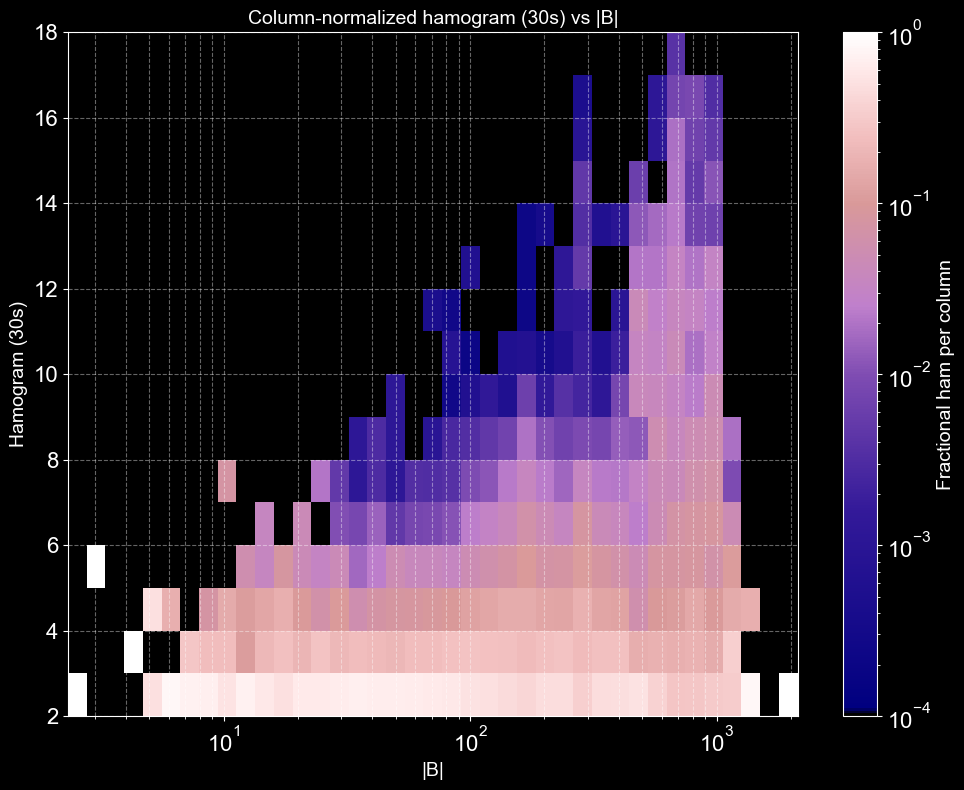

In [70]:
histoham(bmag_up_data_all, ham_data_all, varname= '|B|')

Error parsing/validating input time range for spi_sf00_l3_mom: Input trange elements must be strings or datetime/timestamp objects


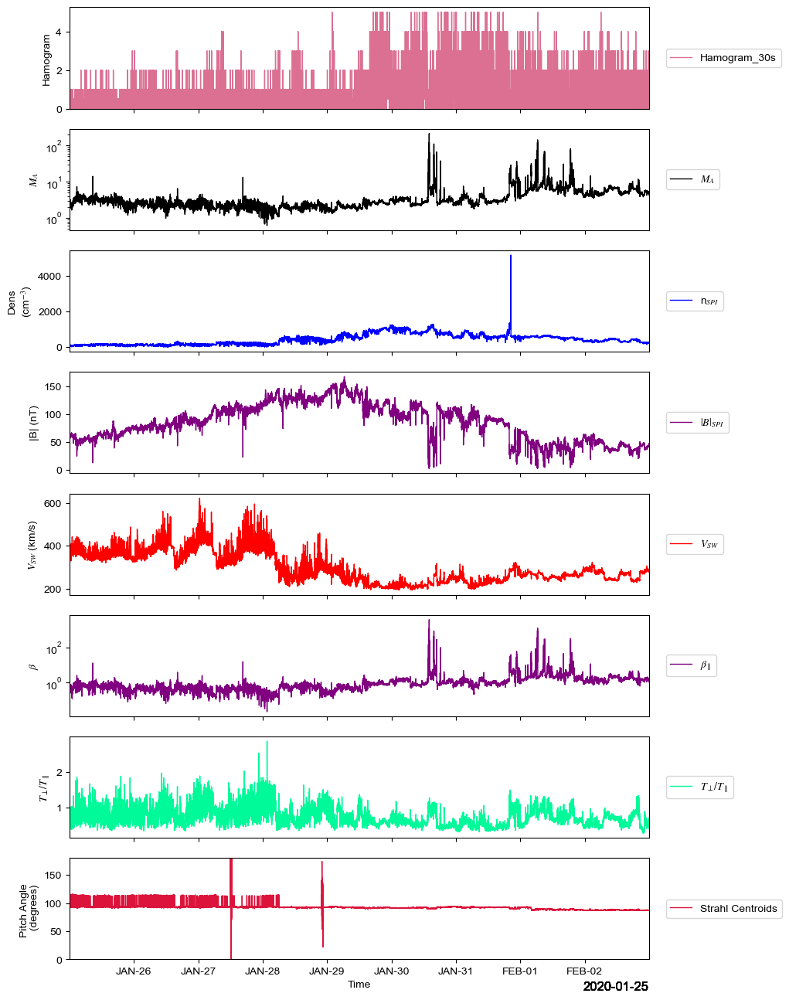

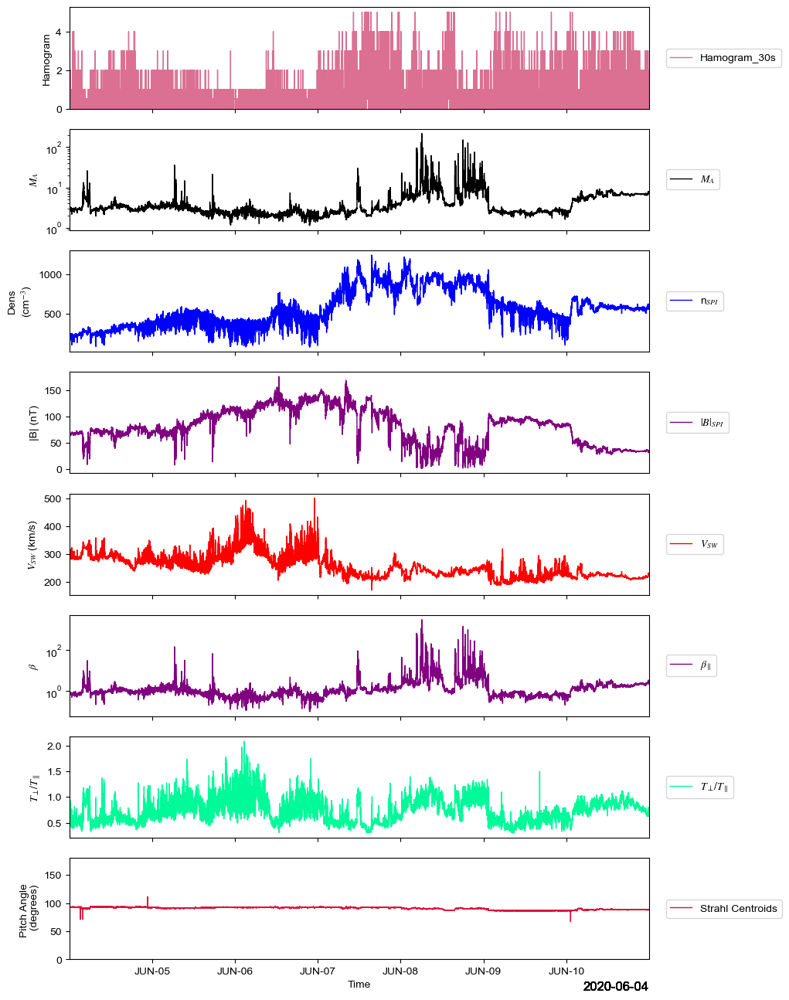

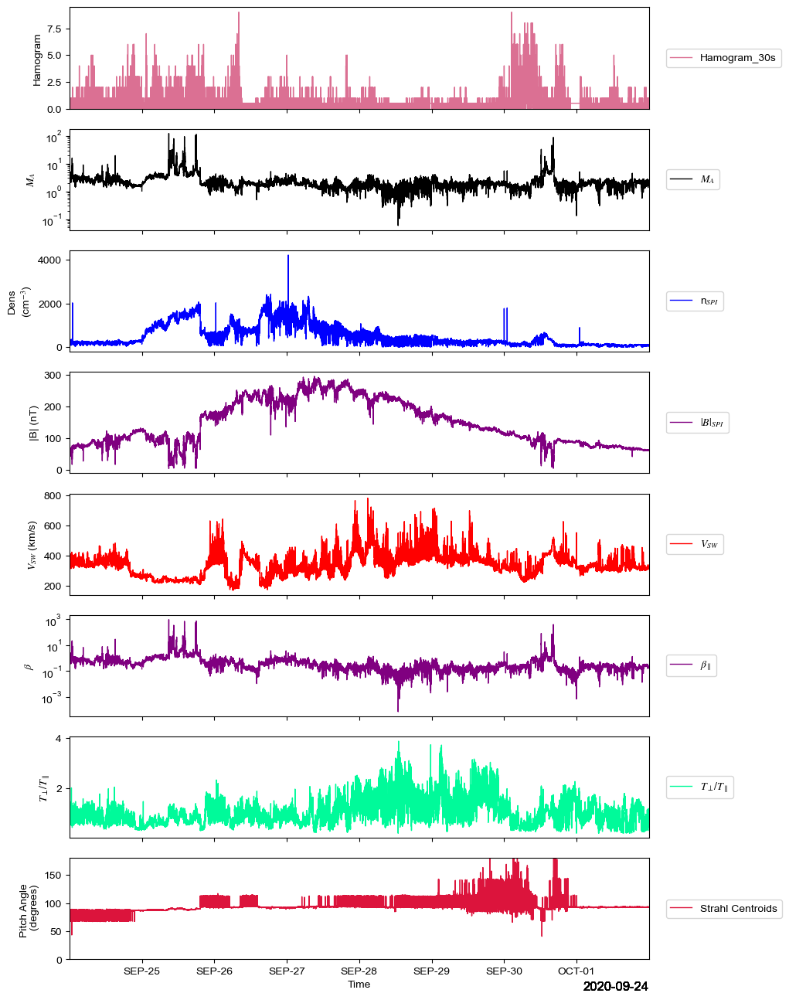

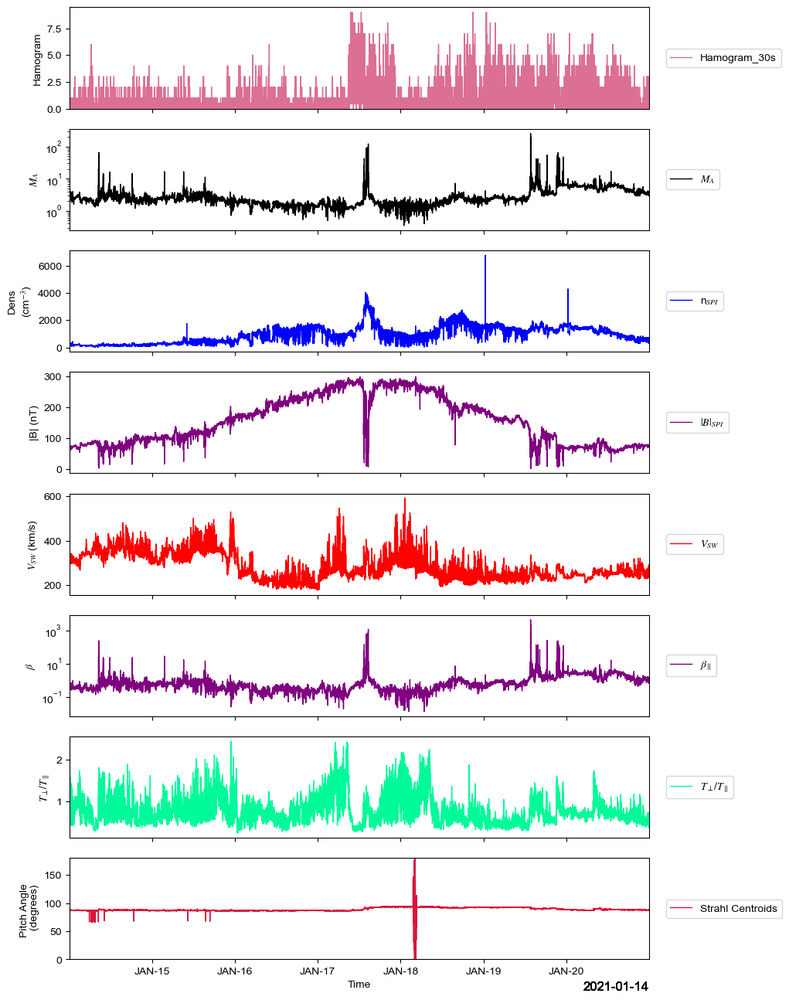

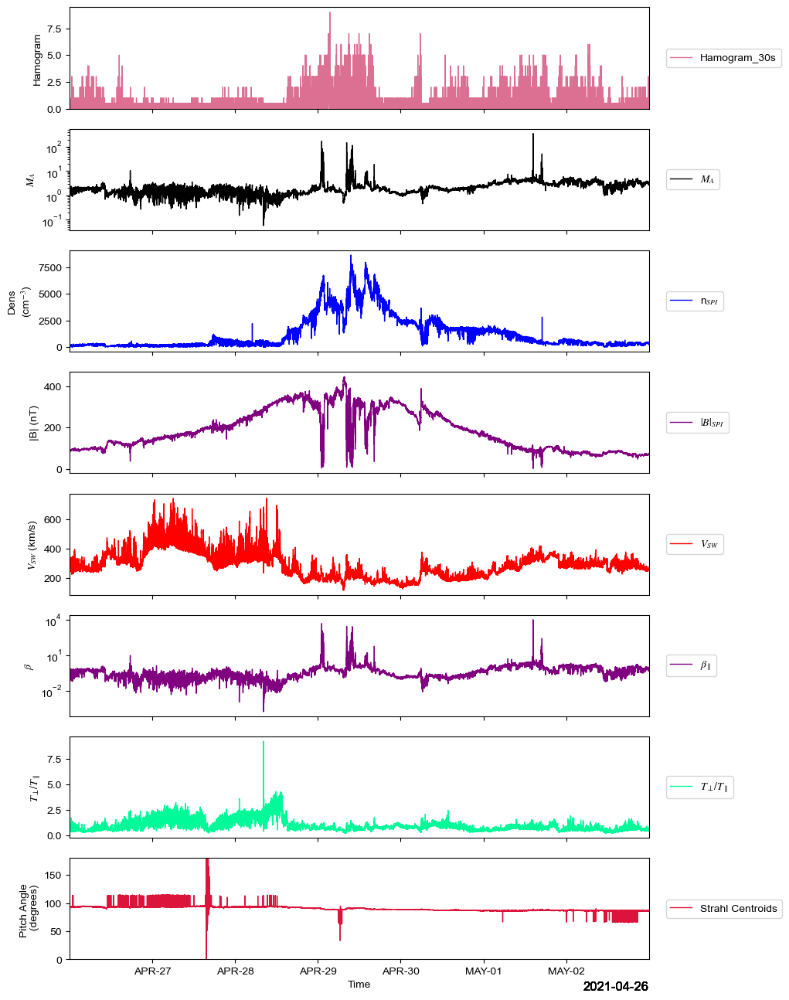

...

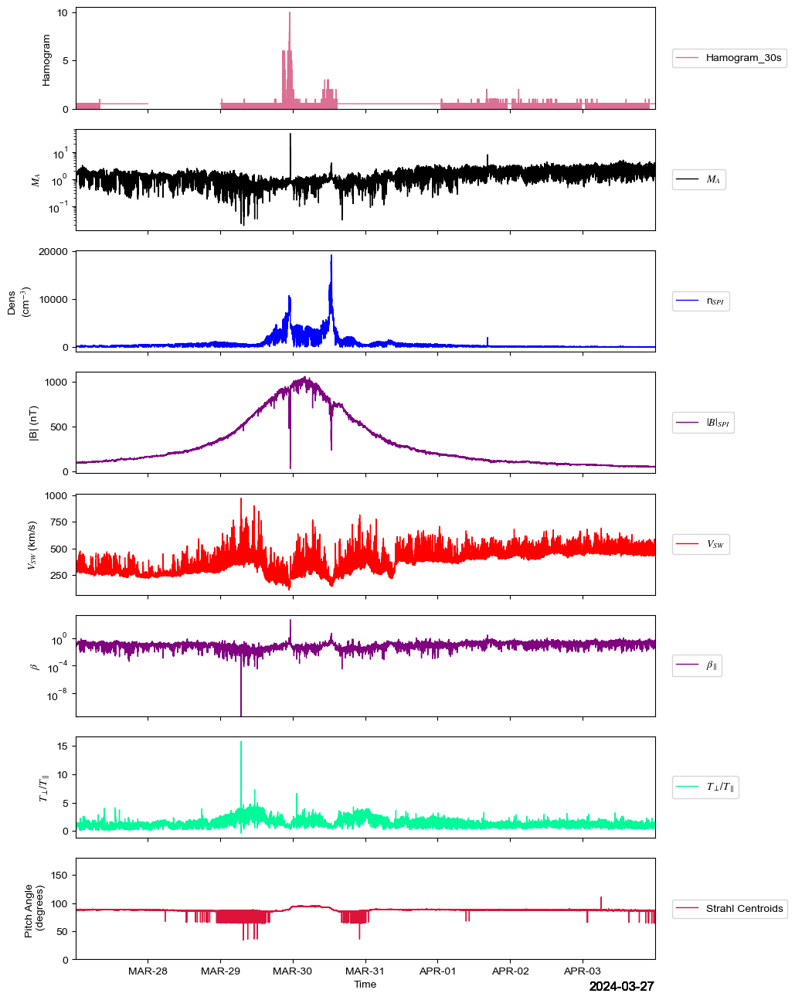

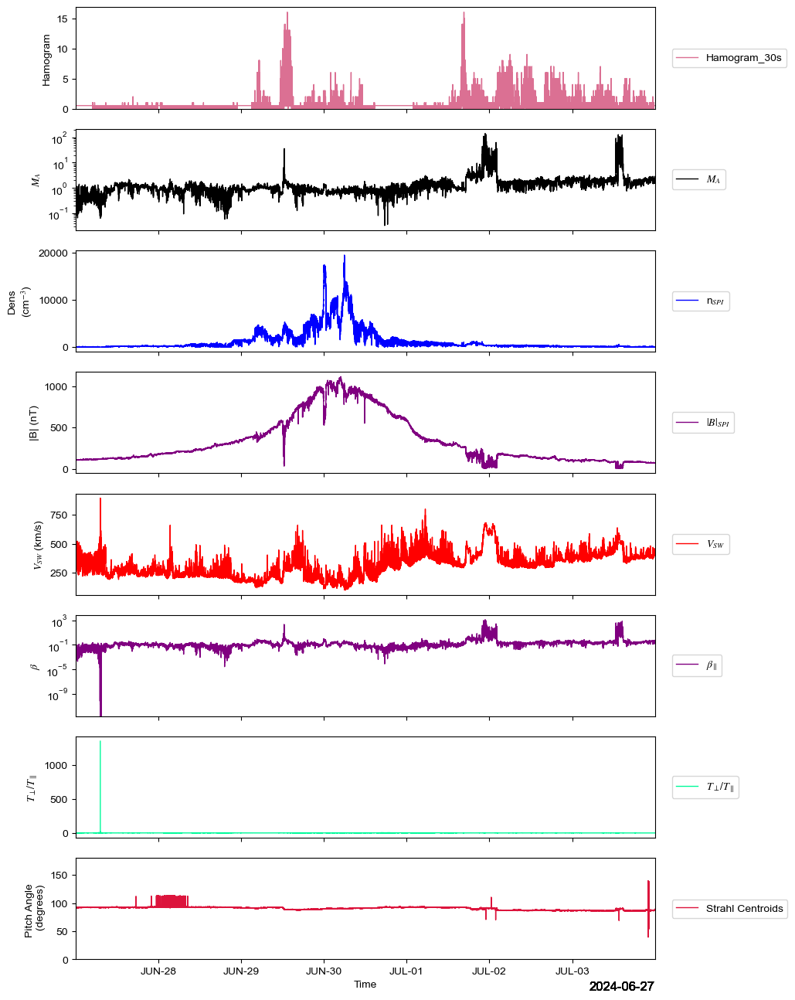

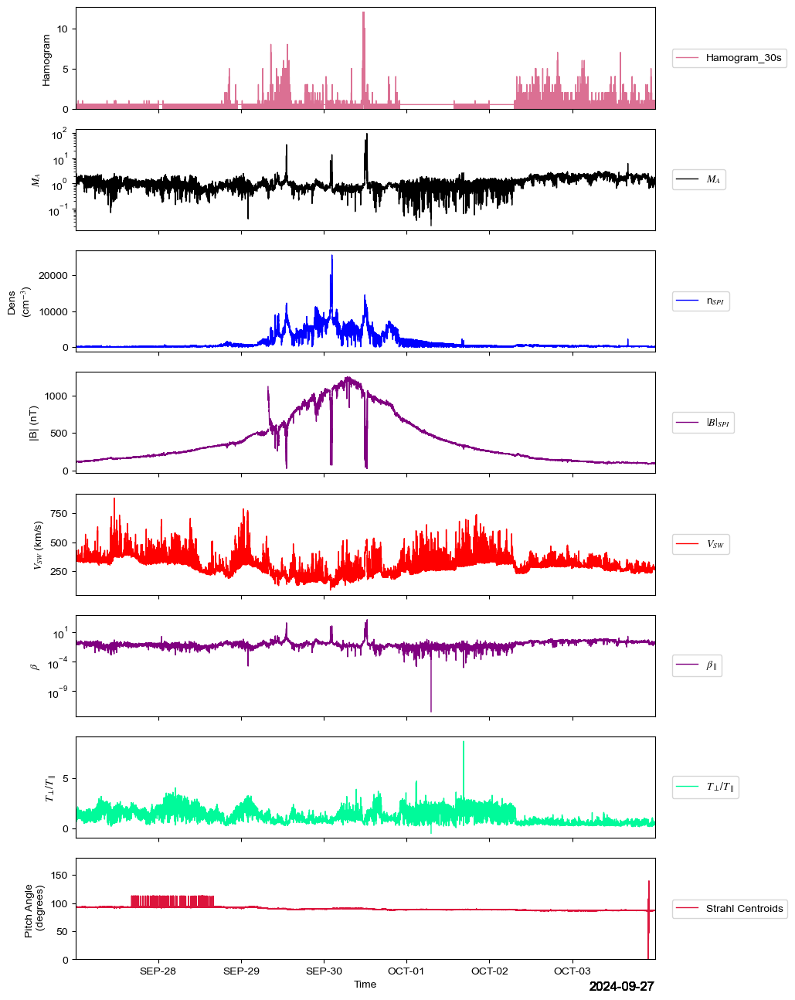

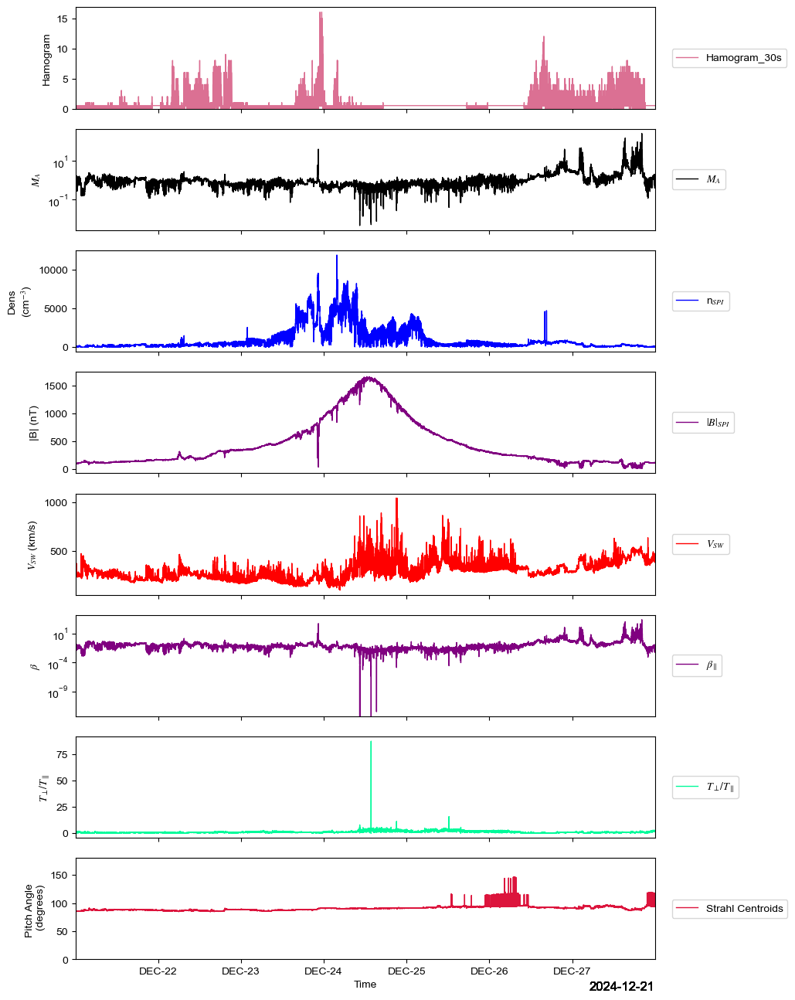

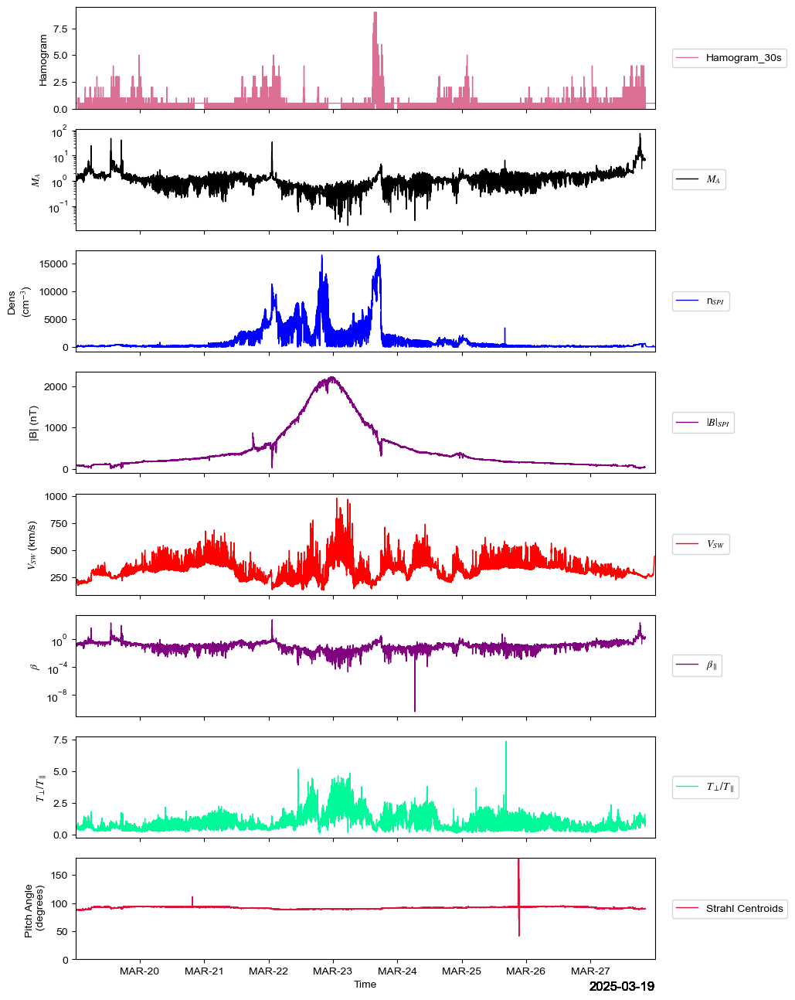

In [ ]:


# Step 1: Group time ranges into a list
time_ranges = [
    ['2020-01-25/00:00','2020-02-02/23:59'], # E4
    ['2020-06-04/00:00','2020-06-10/23:59'], # E5
    ['2020-09-24/00:00','2020-10-01/23:59'], # E6
    ['2021-01-14/00:00','2021-01-20/23:59'], # E7
    ['2021-04-26/00:00','2021-05-02/23:59'], # E8
    ['2021-08-06/00:00','2021-08-12/23:59'], # E9
    ['2021-11-17/00:00','2021-11-24/23:59'], # E10
    ['2022-02-22/00:00','2022-02-28/23:59'], # E11
    ['2022-05-29/00:00','2022-06-04/23:59'], # E12
    ['2022-09-03/00:00','2022-09-09/23:59'], # E13
    ['2022-12-08/00:00','2022-12-14/23:59'], # E14
    ['2023-03-12/00:00','2023-03-20/23:59'], # E15
    ['2023-09-24/00:00','2023-09-30/23:59'], # E17
    ['2023-12-26/00:00','2024-01-02/23:59'], # E18
    ['2024-03-27/00:00','2024-04-03/23:59'], # E19
    ['2024-06-27/00:00','2024-07-03/23:59'], # E20
    ['2024-09-27/00:00','2024-10-03/23:59'], # E21
    ['2024-12-21/00:00','2024-12-27/23:59'], # E22
    ['2025-03-19/00:00','2025-03-27/23:59'], # E23
]

# Step 2: Initialize lists to collect data
ham_data, ham_time = [], []
alfven_data, alfven_time = [], []
vsw_data, vsw_time = [], []
beta_data, beta_time = [], []
anisotropy_data, anisotropy_time = [], []
bmag_data, bmag_time = [], []
epad_centroid_data, epad_centroid_time = [], []
density_data, density_time = [], []
sun_dist_rsun_data, sun_dist_rsun_time = [], []
valfven_data, valfven_time = [], []
ham_trat_data, ham_trat_time = [], []
ham_tperp_div_core_data, ham_tperp_div_core_time = [], []
ham_tperprat_driftva_hc_data, ham_tperprat_driftva_hc_time = [], []
ham_nham_div_ncore_data, ham_nham_div_ncore_time =  [], []

# Step 3: Loop through each time range and call plotbot
for tr in time_ranges:
    plotbot(tr,
        ham.hamogram_30s, 1,
        proton.m_alfven, 2,
        proton.density, 3,
        proton.bmag, 4,
        proton.v_sw, 5,
        proton.beta_ppar, 6,
        proton.anisotropy, 7,
        epad.centroids, 8,
        proton.sun_dist_rsun, 9,
        ham.ham_core_drift, 10,
        proton.v_alfven, 11,
        ham.trat_ham,12,
        ham.Tperp_ham_div_core, 13,
        ham.Tperprat_driftva_hc, 14,
        ham.Nham_div_Ncore, 15)

    # Append data and time from each run
    ham_data.append(ham.hamogram_30s.data)
    ham_time.append(ham.hamogram_30s.datetime_array)

    alfven_data.append(proton.m_alfven.data)
    alfven_time.append(proton.m_alfven.datetime_array)

    vsw_data.append(proton.v_sw.data)
    vsw_time.append(proton.v_sw.datetime_array)

    beta_data.append(proton.beta_ppar.data)
    beta_time.append(proton.beta_ppar.datetime_array)

    bmag_data.append(proton.bmag.data)
    bmag_time.append(proton.bmag.datetime_array)

    anisotropy_data.append(proton.anisotropy.data)
    anisotropy_time.append(proton.anisotropy.datetime_array)

    epad_centroid_data.append(epad.centroids.data)
    epad_centroid_time.append(epad.centroids.datetime_array)

    density_data.append(proton.density.data)
    density_time.append(proton.density.datetime_array)

# Step 4: Concatenate across all events
ham_data_all = np.concatenate(ham_data)
ham_time_all = np.concatenate(ham_time)

alfven_data_all = np.concatenate(alfven_data)
alfven_time_all = np.concatenate(alfven_time)

vsw_data_all = np.concatenate(vsw_data)
vsw_time_all = np.concatenate(vsw_time)

beta_data_all = np.concatenate(beta_data)
beta_time_all = np.concatenate(beta_time)

bmag_data_all = np.concatenate(bmag_data)
bmag_time_all = np.concatenate(bmag_time)

density_data_all = np.concatenate(bmag_data)
density_time_all = np.concatenate(bmag_time)

anisotropy_data_all = np.concatenate(anisotropy_data)
anisotropy_time_all = np.concatenate(anisotropy_time)

epad_centroid_data_all = np.concatenate(epad_centroid_data)
epad_centroid_time_all = np.concatenate(epad_centroid_time)


In [ ]:
time_ranges = [
    ['2020-01-25/00:00','2020-02-02/23:59'], # E4
    ['2020-06-04/00:00','2020-06-10/23:59'], # E5
    ['2020-09-24/00:00','2020-10-01/23:59'], # E6
    ['2021-01-14/00:00','2021-01-20/23:59'], # E7
    ['2021-04-26/00:00','2021-05-02/23:59'], # E8
    ['2021-08-06/00:00','2021-08-12/23:59'], # E9
    ['2021-11-17/00:00','2021-11-24/23:59'], # E10
    ['2022-02-22/00:00','2022-02-28/23:59'], # E11
    ['2022-05-29/00:00','2022-06-04/23:59'], # E12
    ['2022-09-03/00:00','2022-09-09/23:59'], # E13
    ['2022-12-08/00:00','2022-12-14/23:59'], # E14
    ['2023-03-12/00:00','2023-03-20/23:59'], # E15
    ['2023-09-24/00:00','2023-09-30/23:59'], # E17
    ['2023-12-26/00:00','2024-01-02/23:59'], # E18
    ['2024-03-27/00:00','2024-04-03/23:59'], # E19
    ['2024-06-27/00:00','2024-07-03/23:59'], # E20
    ['2024-09-27/00:00','2024-10-03/23:59'], # E21
    ['2024-12-21/00:00','2024-12-27/23:59'], # E22
    ['2025-03-19/00:00','2025-03-27/23:59'], # E23
]

In [ ]:


# Step 1: Group time ranges into a list
time_ranges = [
    ['2020-01-25/00:00','2020-02-02/23:59'], # E4
    ['2020-06-04/00:00','2020-06-10/23:59'], # E5
    ['2020-09-24/00:00','2020-10-01/23:59'], # E6
    ['2021-01-14/00:00','2021-01-20/23:59'], # E7
    ['2021-04-26/00:00','2021-05-02/23:59'], # E8
    ['2021-08-06/00:00','2021-08-12/23:59'], # E9
    ['2021-11-17/00:00','2021-11-24/23:59'], # E10
    ['2022-02-22/00:00','2022-02-28/23:59'], # E11
    ['2022-05-29/00:00','2022-06-04/23:59'], # E12
    ['2022-09-03/00:00','2022-09-09/23:59'], # E13
    ['2022-12-08/00:00','2022-12-14/23:59'], # E14
    ['2023-03-12/00:00','2023-03-20/23:59'], # E15
    ['2023-09-24/00:00','2023-09-30/23:59'], # E17
    ['2023-12-26/00:00','2024-01-02/23:59'], # E18
    ['2024-03-27/00:00','2024-04-03/23:59'], # E19
    ['2024-06-27/00:00','2024-07-03/23:59'], # E20
    ['2024-09-27/00:00','2024-10-03/23:59'], # E21
    ['2024-12-21/00:00','2024-12-27/23:59'], # E22
    ['2025-03-19/00:00','2025-03-27/23:59'], # E23
]

vars = [var1, 
# Step 2: Initialize lists to collect data
var1_data, var1_time = [], []


# Step 3: Loop through each time range and call plotbot
for tr in time_ranges:
    plotbot(tr,
        plotbotvar1, 1,
     )

    # Append data and time from each run
    var1_data.append(plotbotvar1.data)
    var2_time.append(plotbotvar1.datetimearray)


# Step 4: Concatenate across all events
var1_data_all = np.concatenate(var1_data)
var1_time_all = np.concatenate(var1_time)



Error parsing/validating input time range for spi_sf00_l3_mom: Input trange elements must be strings or datetime/timestamp objects


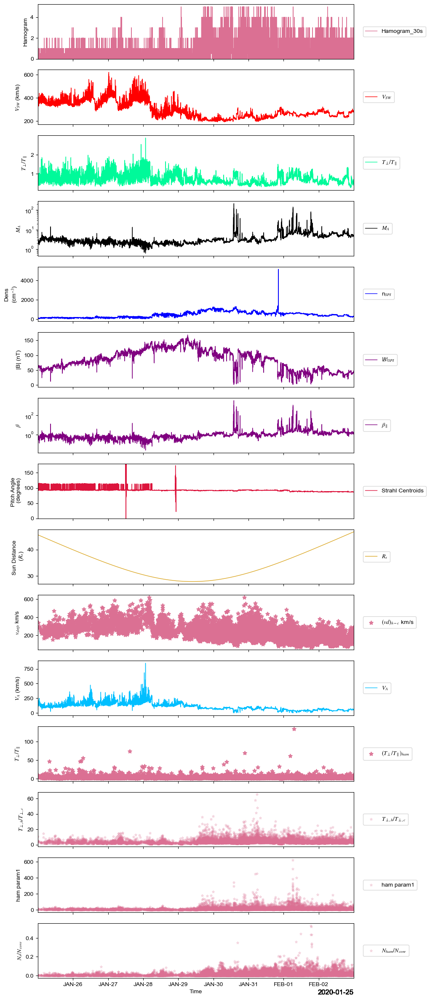

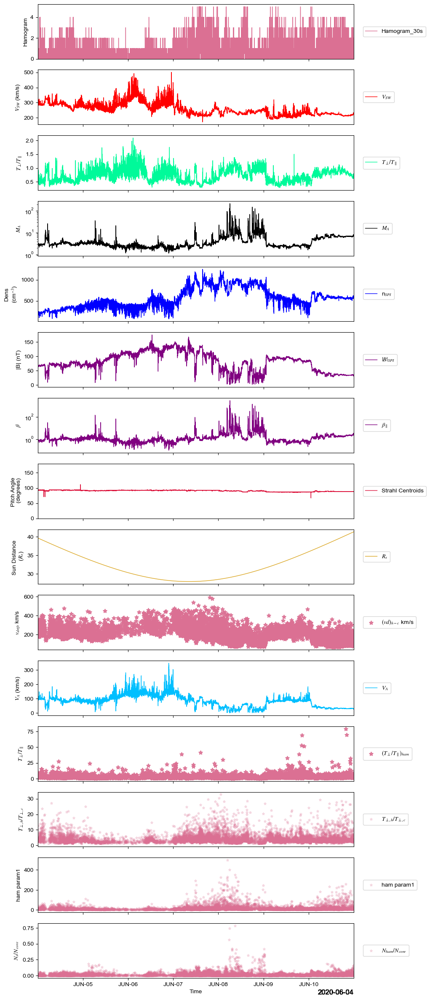

⚠️ Could not concatenate hamogram_30s: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate v_sw: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate anisotropy: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate amach: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate density: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate bmag: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate beta_ppar: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate epad_centroids: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate sun_dist_rs: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate ham_core_drift: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate valfven: zero-dimensional arrays cannot be concatenated
⚠️ Could not concatenate trat_ham: zero-dimensional arrays cannot be concatenated
⚠️ Coul

In [8]:
import numpy as np

# Step 1: Time ranges
time_ranges = [
    ['2020-01-25/00:00','2020-02-02/23:59'], # E4
    ['2020-06-04/00:00','2020-06-10/23:59'], # E5
]

# Step 2: Variables to load and their names
plotbot_vars = [ham.hamogram_30s, proton.v_sw, proton.anisotropy, proton.m_alfven, proton.density, proton.bmag, 
                proton.beta_ppar, epad.centroids, proton.sun_dist_rsun, ham.ham_core_drift, proton.v_alfven, ham.trat_ham, 
                ham.Tperp_ham_div_core, ham.Tperprat_driftva_hc, ham.Nham_div_Ncore]
varnames = ['hamogram_30s', 'v_sw', 'anisotropy', 'amach', 'density', 'bmag', 
            'beta_ppar', 'epad_centroids', 'sun_dist_rs', 'ham_core_drift', 'valfven', 'trat_ham',
            'tperp_ham_div_core', 'tperprat_driftva_hc', 'nham_div_ncore']

# Step 3: Init data collectors
var_data = [[] for _ in varnames]
var_time = [[] for _ in varnames]

# Step 4: Loop through time ranges
for tr in time_ranges:
    plotbot_args = [tr]
    for i, var in enumerate(plotbot_vars):
        plotbot_args += [var, i + 1]
    plotbot(*plotbot_args)

    for i, var in enumerate(plotbot_vars):
        var_data[i].append(var.data)
        var_time[i].append(var.datetime_array)

# Step 5: Concatenate and assign to globals
for name, dlist, tlist in zip(varnames, var_data, var_time):
    try:
        globals()[f"{name}_data"] = np.concatenate(dlist)
        globals()[f"{name}_time"] = np.concatenate(tlist)
    except Exception as e:
        print(f"⚠️ Could not concatenate {name}: {e}")
        globals()[f"{name}_data"] = np.array([])
        globals()[f"{name}_time"] = np.array([])

# Reference time
ref_time = hamogram_30s_time

# Variable base names
varnames = ['hamogram_30s', 'v_sw', 'anisotropy']

# Apply upsample function
for name in varnames:
    try:
        t = globals()[f"{name}_time"]
        d = globals()[f"{name}_data"]
        upsampled = upsample_to_match_halfsec(t, d, ref_time)
        globals()[f"{name}_up_data"] = upsampled
    except Exception as e:
        print(f"⚠️ Could not upsample {name}: {e}")
        globals()[f"{name}_up_data"] = np.full(len(ref_time), np.nan)






In [7]:
anisotropy_data

NameError: name 'anisotropy_data' is not defined

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors


from matplotlib import colors
# Define colors transitioning from navy blue to purple, ham, and white
palette = [
    (0, 0, 0),                # Black
    (0, 0, 0.5),             # Navy blue (lowest values)
    (0.2, 0.1, 0.6),         # Dark purple
    (0.5, 0.3, 0.7),         # Medium purple
    (0.75, 0.5, 0.8),        # Soft lavender-purple
    (0.85, 0.6, 0.6),        # Light ham pink
    (0.95, 0.75, 0.75),      # Very light ham pink
    (1, 0.92, 0.92),         # Pale pink-white
    (1, 1, 1),               # Pure white (highest values)
]

# Adjust the distribution to emphasize navy, purple, and ham
nodes = [
    0.0, 0.01, 0.3, 0.5, 0.6, 0.75, 0.85, 0.95, 1.0
]

# Create the custom colormap with non-linear spacing
cmap3 = colors.LinearSegmentedColormap.from_list("navy_to_purple_ham_white", list(zip(nodes, palette)), N=256)

def histoham(var, ham, varname='Variable'):
    """
    Creates a column-normalized, log-scaled, dark-themed 2D histogram
    of HAM against any continuous variable, with large font sizes.

    Parameters:
    - var: 1D array-like of continuous variable (e.g., amach)
    - ham: 1D array-like of HAM counts (integer-like)
    - varname: string, name to display on x-axis
    """
    var = np.asarray(var, dtype=float)
    ham = np.asarray(ham, dtype=float)
    
    # Filter: finite values, ham > 1
    valid = np.isfinite(var) & np.isfinite(ham) & (ham > 1)
    var = var[valid]
    ham = ham[valid]

    if len(var) == 0 or len(ham) == 0:
        print("⚠️ No valid data to plot.")
        return

    # Define bins
    x_bins = np.logspace(np.log10(np.nanmin(var)*0.95), np.log10(np.nanmax(var)*1.05), 40)
    y_bins = np.arange(2, int(np.nanmax(ham)) + 2)

    # 2D Histogram
    H, xedges, yedges = np.histogram2d(var, ham, bins=[x_bins, y_bins])

    # H is shape (len(x_bins)-1, len(y_bins)-1)
    # Normalize each column (each var bin = one column of HAM counts)
    H_norm = H.T  # Transpose to get HAM vs VAR for easier column-wise op
    H_colsum = H_norm.sum(axis=0, keepdims=True)
    H_norm = H_norm / H_colsum
    H_norm = np.nan_to_num(H_norm, nan=0.0)  # clean up any NaNs from div by 0

    # Plot
    plt.style.use('dark_background')
    fig, ax = plt.subplots(figsize=(10, 8))

    mesh = ax.pcolormesh(
        xedges, yedges, H_norm,
        cmap=cmap3,
        norm=colors.LogNorm(vmin=1e-4, vmax=1)
    )

    # Colorbar
    cb = fig.colorbar(mesh, ax=ax)
    cb.set_label('Fractional ham per column', fontsize = 14, color = 'white')
    cb.ax.tick_params(labelsize=16, colors='white')

    ax.set_xscale('log')
    #import matplotlib.ticker as ticker
    #ax.xaxis.set_major_formatter(ticker.FormatStrFormatter('%g'))
    #from matplotlib.ticker import ScalarFormatter
   # ax.xaxis.set_major_formatter(ScalarFormatter())
    #ax.ticklabel_format(style='plain', axis='x')
    # After plotting and setting xscale/log scale:
    ax.tick_params(axis='x', labelsize=16)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_xlabel(varname, fontsize = 14, color = 'white')
    ax.set_ylabel('Hamogram (30s)', fontsize = 14, color = 'white')
    ax.set_title(f'Column-normalized hamogram (30s) vs {varname}', fontsize=14, color = 'white')

    ax.tick_params(colors='white', labelsize=16)

    cb.ax.yaxis.set_tick_params(color='white')
    plt.setp(cb.ax.yaxis.get_ticklabels(), color='white')

    ax.grid(True, which='both', linestyle='--', alpha=0.4)

    ax.tick_params(axis='both', labelsize=16)
    ax.xaxis.offsetText.set_fontsize(16)
    cb.ax.tick_params(labelsize=16)
    plt.tight_layout()
    plt.show()



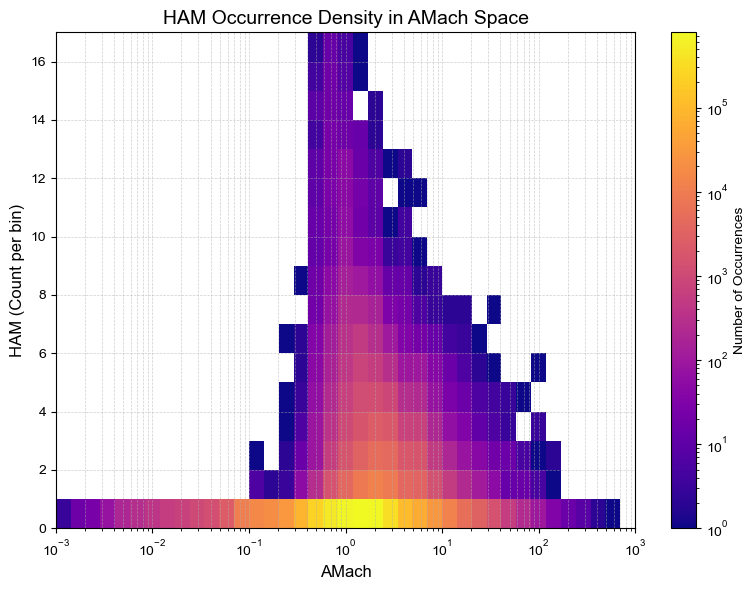

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Variables
x = ham_data_all.astype(float)  # vertical axis (counts)
y = amach_up_data_all.astype(float)  # horizontal axis (mach space)

# Remove NaNs/Infs
valid_mask = np.isfinite(x) & np.isfinite(y)
x = x[valid_mask]
y = y[valid_mask]

# Make 2D histogram: how often a given ham count occurs at a given amach
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    y, x,
    #bins=[np.logspace(np.log10(0.001), np.log10(10), 40), np.arange(0, np.nanmax(x)+1)],
    bins=[np.logspace(np.log10(0.001), np.log10(1000), 40), np.arange(0, np.nanmax(x)+1)],

    cmap='plasma',
    norm=colors.LogNorm()
)

# Decorations
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('AMach', fontsize=12)
plt.ylabel('HAM (Count per bin)', fontsize=12)
plt.title('HAM Occurrence Density in AMach Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


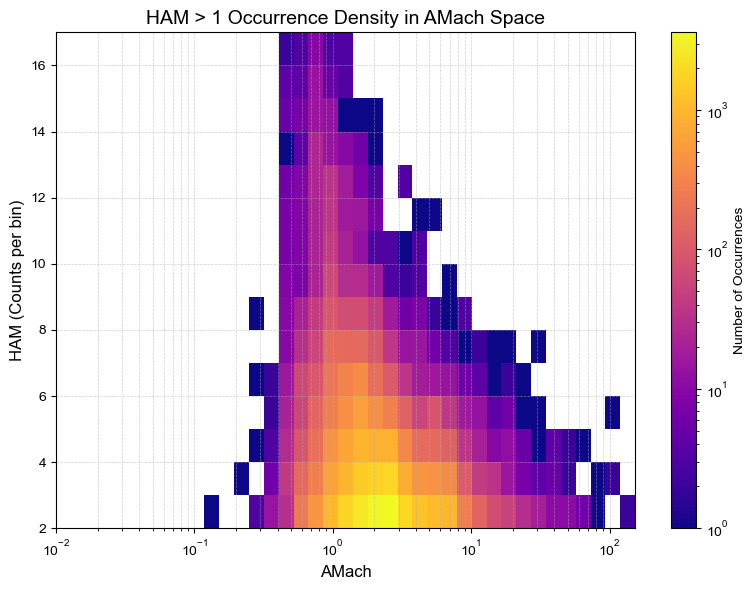

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
amach = amach_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(amach) & (ham > 1)
ham_filtered = ham[valid_mask]
amach_filtered = amach[valid_mask]

# Define bins
amach_bins = np.logspace(np.log10(0.01), np.log10(np.nanmax(amach_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    amach_filtered, ham_filtered,
    bins=[amach_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('AMach', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in AMach Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


In [7]:
from matplotlib import colors
# Define colors transitioning from navy blue to purple, ham, and white
palette = [
    (0, 0, 0),                # Black
    (0, 0, 0.5),             # Navy blue (lowest values)
    (0.2, 0.1, 0.6),         # Dark purple
    (0.5, 0.3, 0.7),         # Medium purple
    (0.75, 0.5, 0.8),        # Soft lavender-purple
    (0.85, 0.6, 0.6),        # Light ham pink
    (0.95, 0.75, 0.75),      # Very light ham pink
    (1, 0.92, 0.92),         # Pale pink-white
    (1, 1, 1),               # Pure white (highest values)
]

# Adjust the distribution to emphasize navy, purple, and ham
nodes = [
    0.0, 0.01, 0.3, 0.5, 0.6, 0.75, 0.85, 0.95, 1.0
]

# Create the custom colormap with non-linear spacing
cmap3 = colors.LinearSegmentedColormap.from_list("navy_to_purple_ham_white", list(zip(nodes, palette)), N=256)

<Figure size 800x600 with 0 Axes>

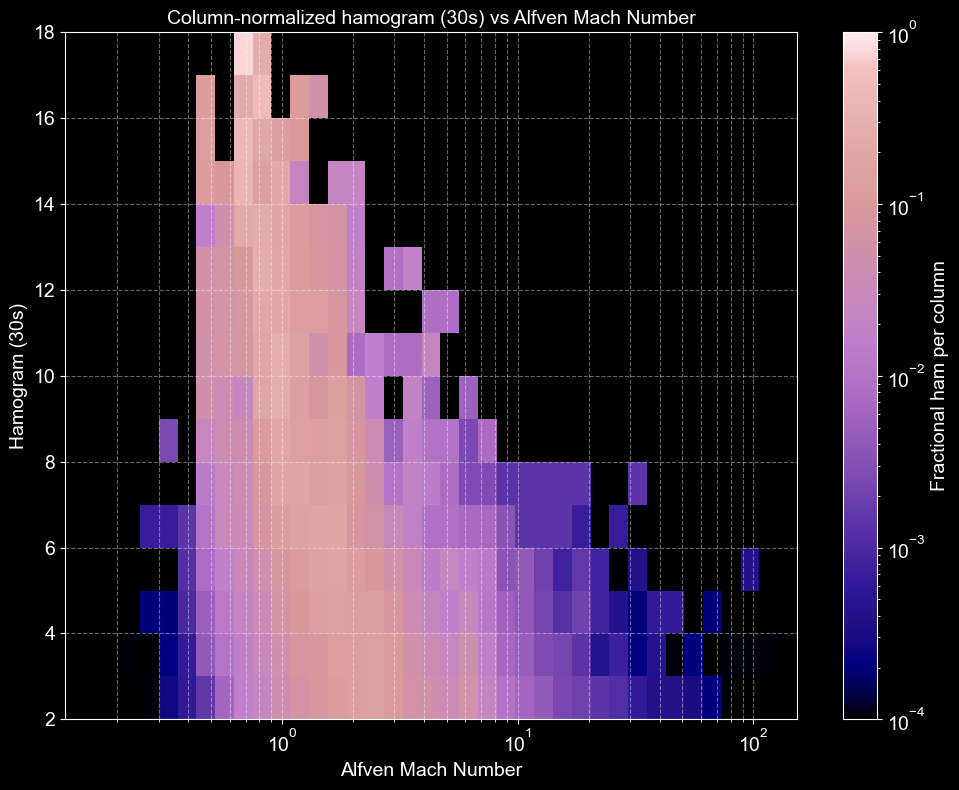

In [38]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Prep data
ham = ham_data_all.astype(float)
amach = amach_up_data_all.astype(float)
valid_mask = np.isfinite(ham) & np.isfinite(amach) & (ham > 1)
ham = ham[valid_mask]
amach = amach[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(amach)*.95), np.log10(np.nanmax(amach)*1.05), 40)
y_bins = np.arange(2, np.nanmax(ham)+2)

# Histogram
H, xedges, yedges = np.histogram2d(amach, ham, bins=[x_bins, y_bins])

# Normalize each column (axis=0 = AMach bins)
H_colsum = np.sum(H, axis=0)
H_norm = H / H_colsum[np.newaxis, :]
H_norm = np.nan_to_num(H_norm, nan=1e-6)  # avoid zero log

# Plot with black background
plt.style.use('dark_background')  # sets dark mode

# Plot with log scale on colorbar
plt.figure(figsize=(8, 6))
fig, ax = plt.subplots(figsize=(10, 8))
mesh = ax.pcolormesh(
    xedges, yedges, H_norm.T,
    cmap=cmap_ham_ultra,
    norm=colors.LogNorm(vmin=1e-4, vmax=1)
)

cb = plt.colorbar(mesh, ax = ax)
cb.set_label('Fractional ham per column', fontsize = 14)
cb.ax.tick_params(labelsize=14, colors='white')

ax.set_xscale('log')
ax.set_xlabel('Alfven Mach Number', fontsize = 14)
ax.set_ylabel('Hamogram (30s)', fontsize = 14)
ax.set_title('Column-normalized hamogram (30s) vs Alfven Mach Number', fontsize=14)
ax.tick_params(colors='white', labelsize=14)
cb.ax.yaxis.set_tick_params(color='white')
plt.setp(cb.ax.yaxis.get_ticklabels(), color='white')

ax.grid(True, which='both', linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()


21-May-25 14:37:37: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_84134/3078778215.py:23: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



<Figure size 800x600 with 0 Axes>

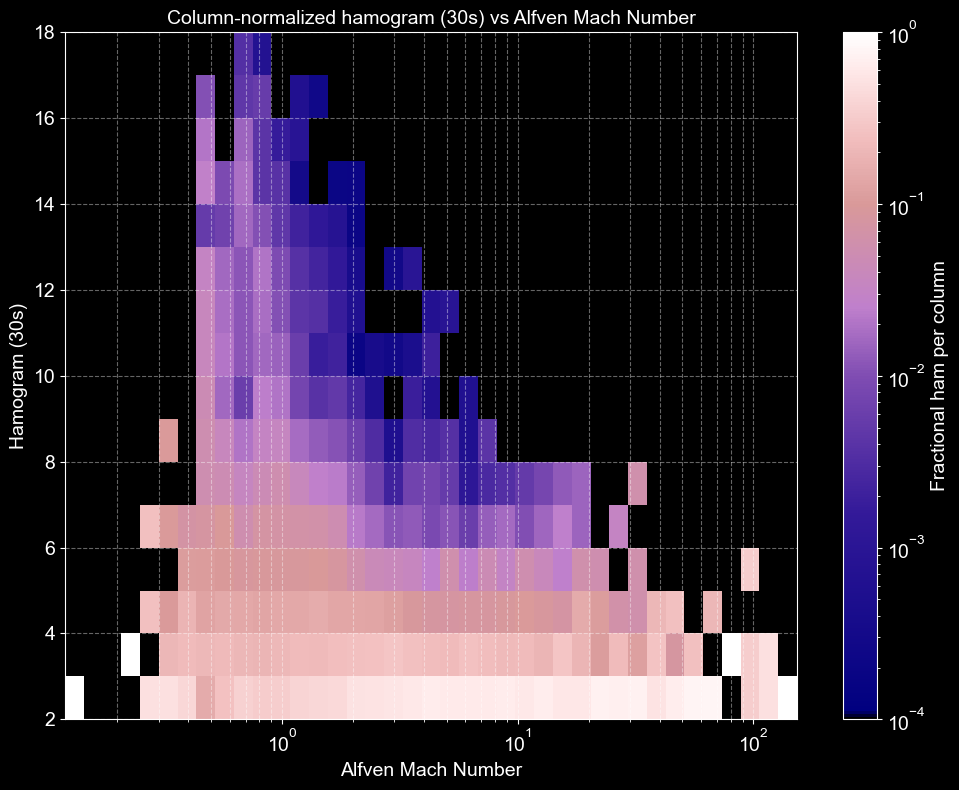

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Prep data
ham = ham_data_all.astype(float)
amach = amach_up_data_all.astype(float)
valid_mask = np.isfinite(ham) & np.isfinite(amach) & (ham > 1)
ham = ham[valid_mask]
amach = amach[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(amach)*.95), np.log10(np.nanmax(amach)*1.05), 40)
y_bins = np.arange(2, np.nanmax(ham)+2)

# Histogram
H, xedges, yedges = np.histogram2d(amach, ham, bins=[x_bins, y_bins])

# H is shape (len(x_bins)-1, len(y_bins)-1)
# Normalize each column (each var bin = one column of HAM counts)
H_norm = H.T  # Transpose to get HAM vs VAR for easier column-wise op
H_colsum = H_norm.sum(axis=0, keepdims=True)
H_norm = H_norm / H_colsum
H_norm = np.nan_to_num(H_norm, nan=0.0)  # clean up any NaNs from div by 0

# Plot with black background
plt.style.use('dark_background')  # sets dark mode

# Plot with log scale on colorbar
plt.figure(figsize=(8, 6))
fig, ax = plt.subplots(figsize=(10, 8))
mesh = ax.pcolormesh(
    xedges, yedges, H_norm,
    cmap=cmap3,
    norm=colors.LogNorm(vmin=1e-4, vmax=1)
)

cb = plt.colorbar(mesh, ax = ax)
cb.set_label('Fractional ham per column', fontsize = 14)
cb.ax.tick_params(labelsize=14, colors='white')

ax.set_xscale('log')
ax.set_xlabel('Alfven Mach Number', fontsize = 14)
ax.set_ylabel('Hamogram (30s)', fontsize = 14)
ax.set_title('Column-normalized hamogram (30s) vs Alfven Mach Number', fontsize=14)
ax.tick_params(colors='white', labelsize=14)
cb.ax.yaxis.set_tick_params(color='white')
plt.setp(cb.ax.yaxis.get_ticklabels(), color='white')

ax.grid(True, which='both', linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()


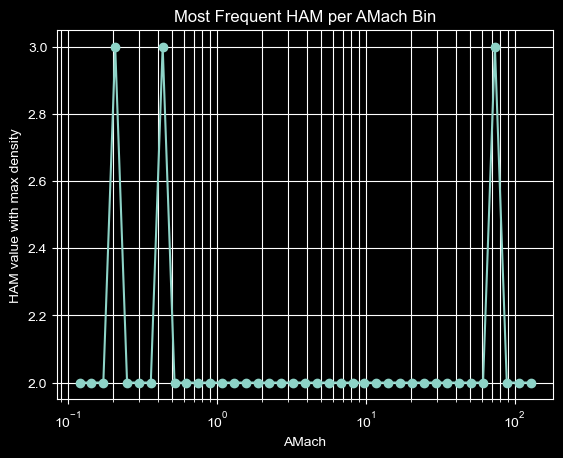

In [10]:
peak_ham_idx = np.argmax(H_norm, axis=0)  # max row index in each column
peak_ham_val = y_bins[peak_ham_idx]       # convert to HAM values

plt.figure()
plt.plot(x_bins[:-1], peak_ham_val, marker='o')
plt.xscale('log')
plt.xlabel('AMach')
plt.ylabel('HAM value with max density')
plt.title('Most Frequent HAM per AMach Bin')
plt.grid(True, which='both')
plt.show()

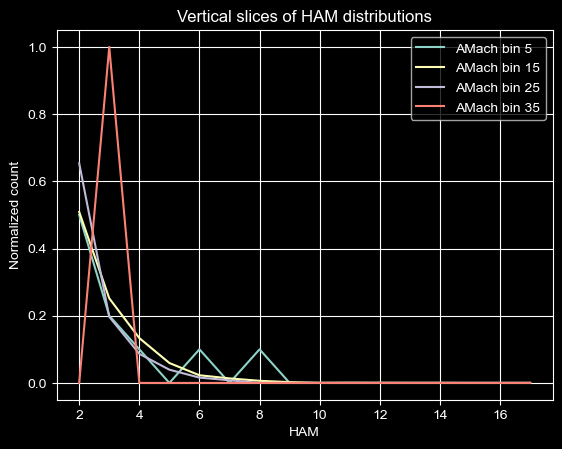

In [11]:
import matplotlib.pyplot as plt

# Select a few columns (amach bins) to examine
sample_cols = [5, 15, 25, 35]  # choose indices manually or with np.linspace

plt.figure()
for col in sample_cols:
    plt.plot(y_bins[:-1], H_norm[:, col], label=f'AMach bin {col}')

plt.xlabel('HAM')
plt.ylabel('Normalized count')
plt.legend()
plt.title('Vertical slices of HAM distributions')
plt.grid(True)
plt.show()


21-May-25 15:21:30: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_85064/1631846957.py:61: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



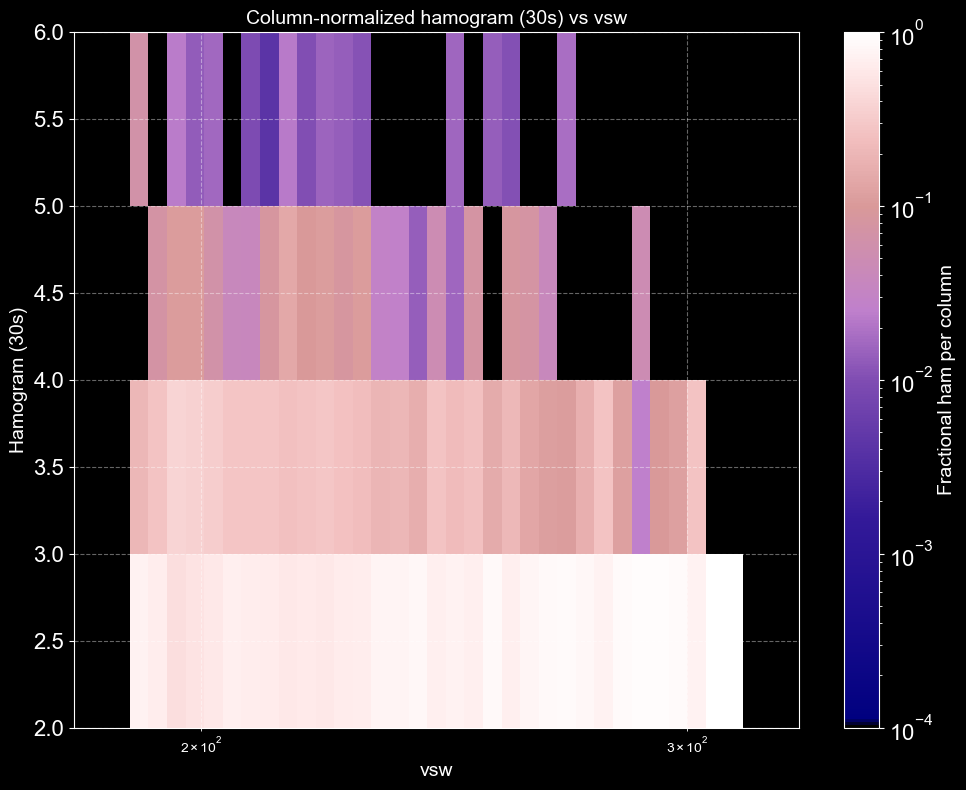

In [23]:
histoham(v_sw_up_data, hamogram_30s_data, varname= 'vsw')

21-May-25 14:45:15: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_84134/3699425960.py:38: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



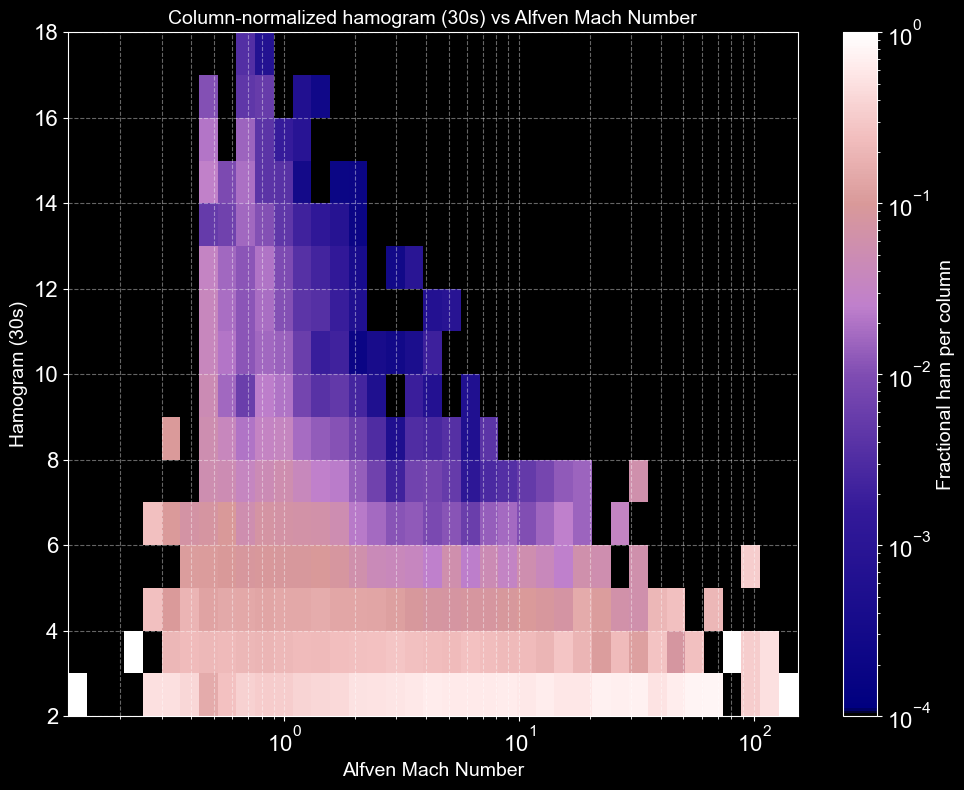

In [13]:
histoham(amach_up_data_all, ham_data_all, varname= 'Alfven Mach Number')

21-May-25 14:45:19: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_84134/3699425960.py:38: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



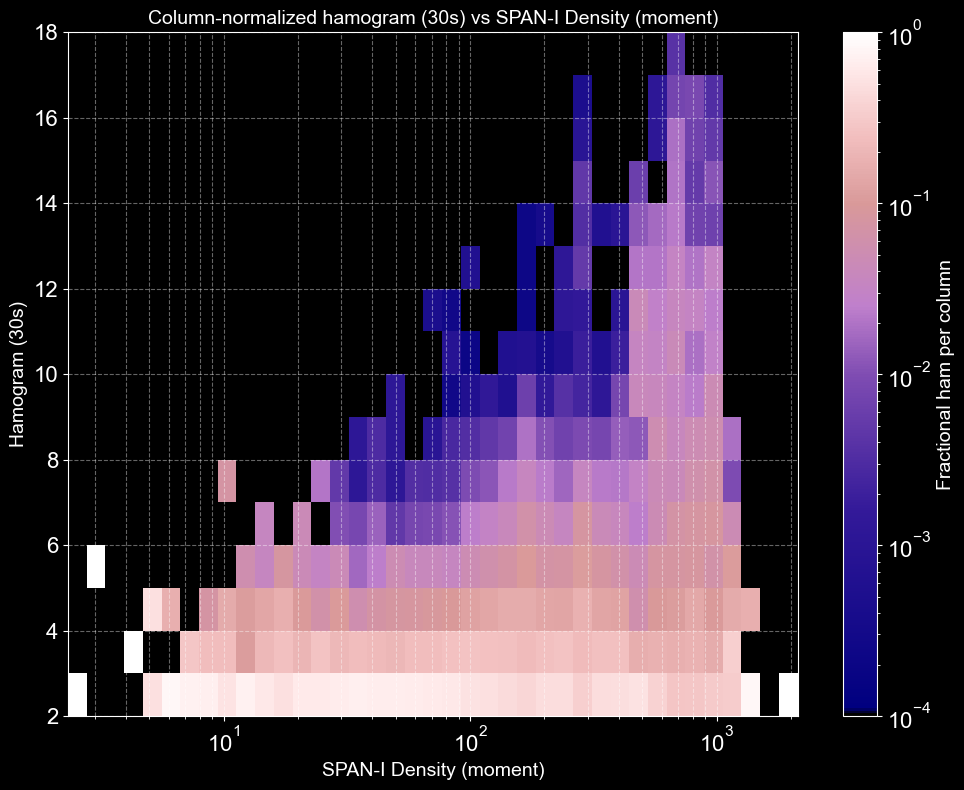

In [14]:
histoham(density_up_data_all, ham_data_all, varname= 'SPAN-I Density (moment)')

21-May-25 14:45:31: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_84134/3699425960.py:38: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



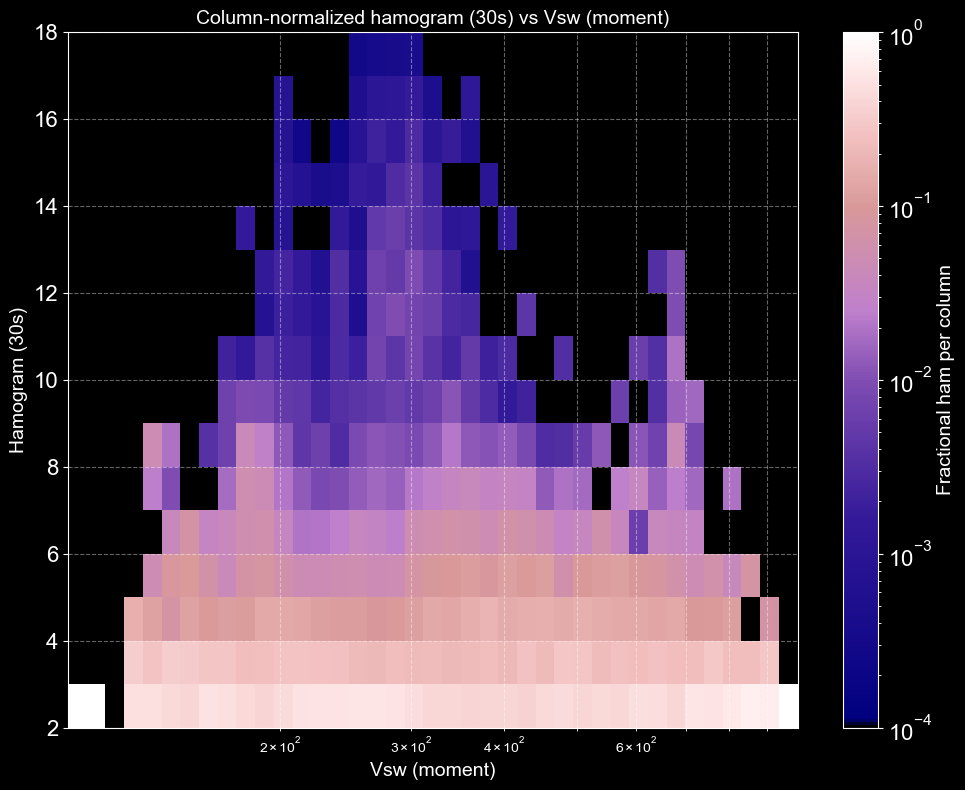

In [15]:
histoham(vsw_up_data_all, ham_data_all, varname= 'Vsw (moment)')

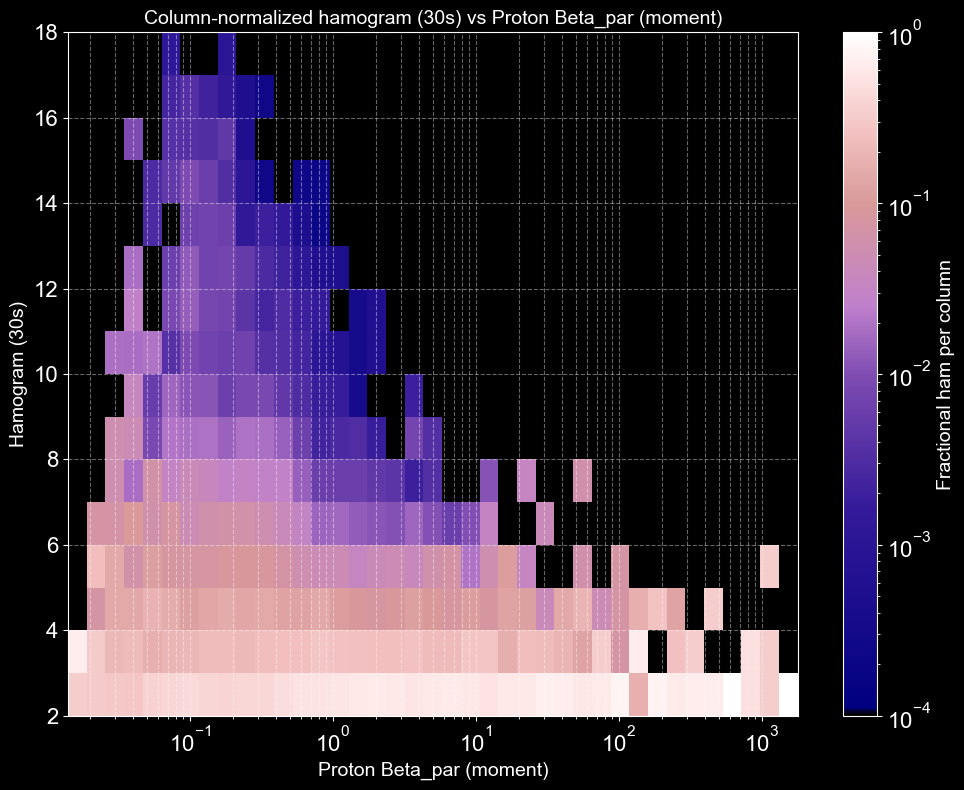

In [16]:
histoham(beta_up_data_all, ham_data_all, varname= 'Proton Beta_par (moment)')

21-May-25 14:45:51: /var/folders/zr/xl1pb9_s66d726l_t9b7jvf80000gn/T/ipykernel_84134/3699425960.py:38: RuntimeWarning: invalid value encountered in divide
  H_norm = H_norm / H_colsum



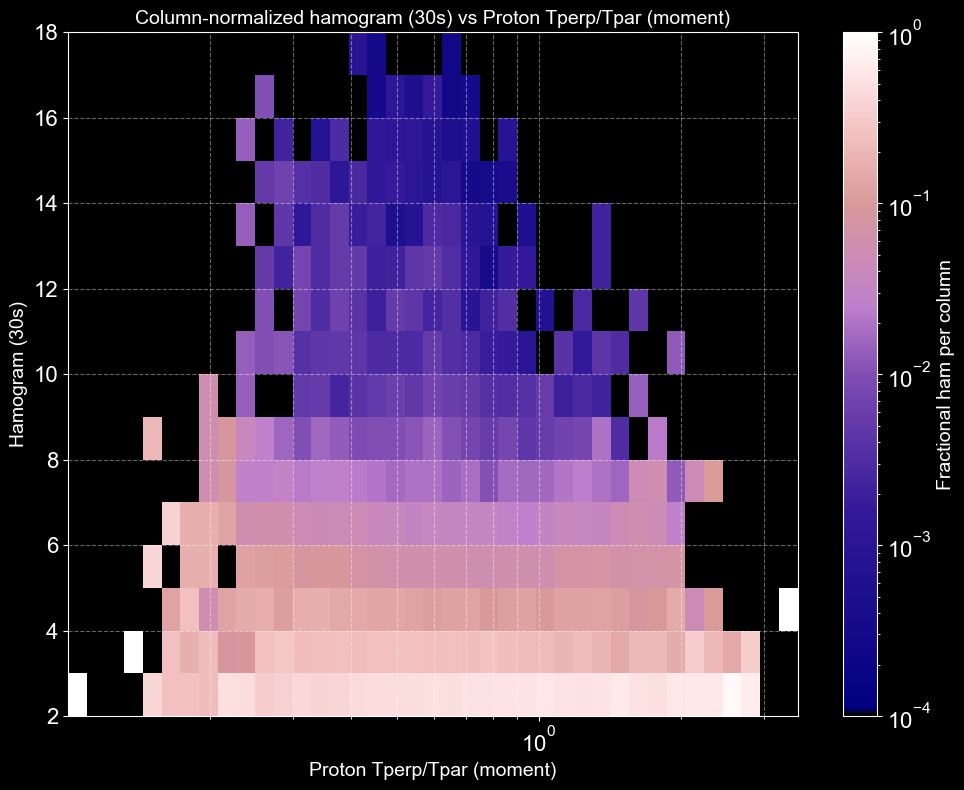

In [17]:
histoham(anisotropy_up_data_all, ham_data_all, varname= 'Proton Tperp/Tpar (moment)')

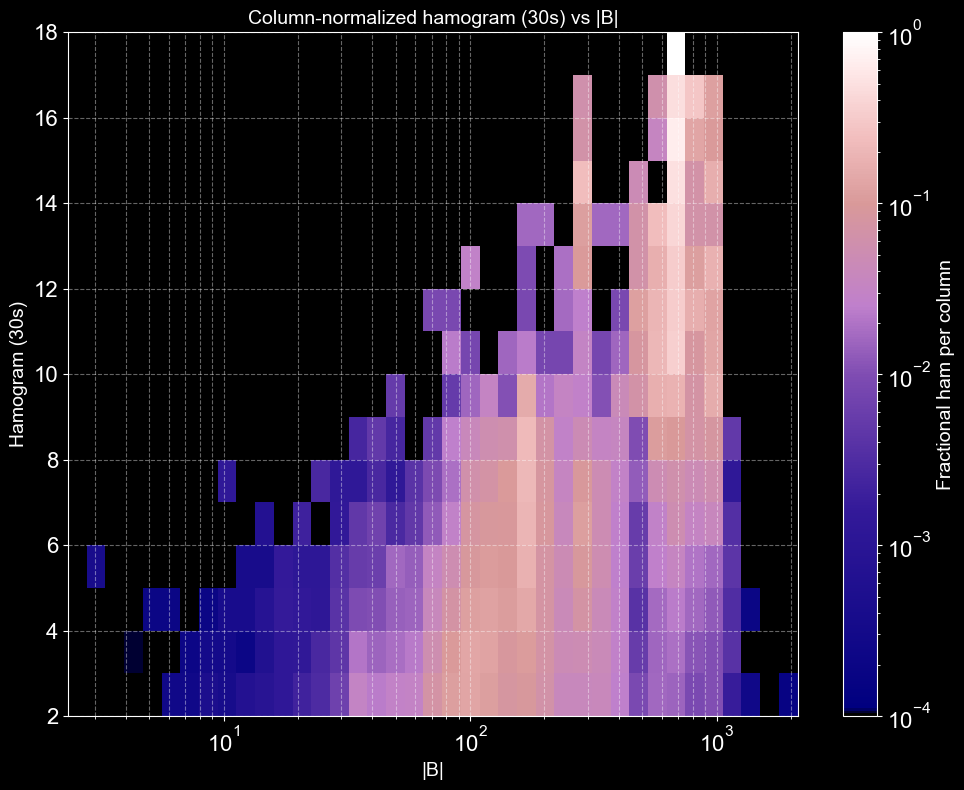

In [66]:
histoham(bmag_up_data_all, ham_data_all, varname= '|B|')

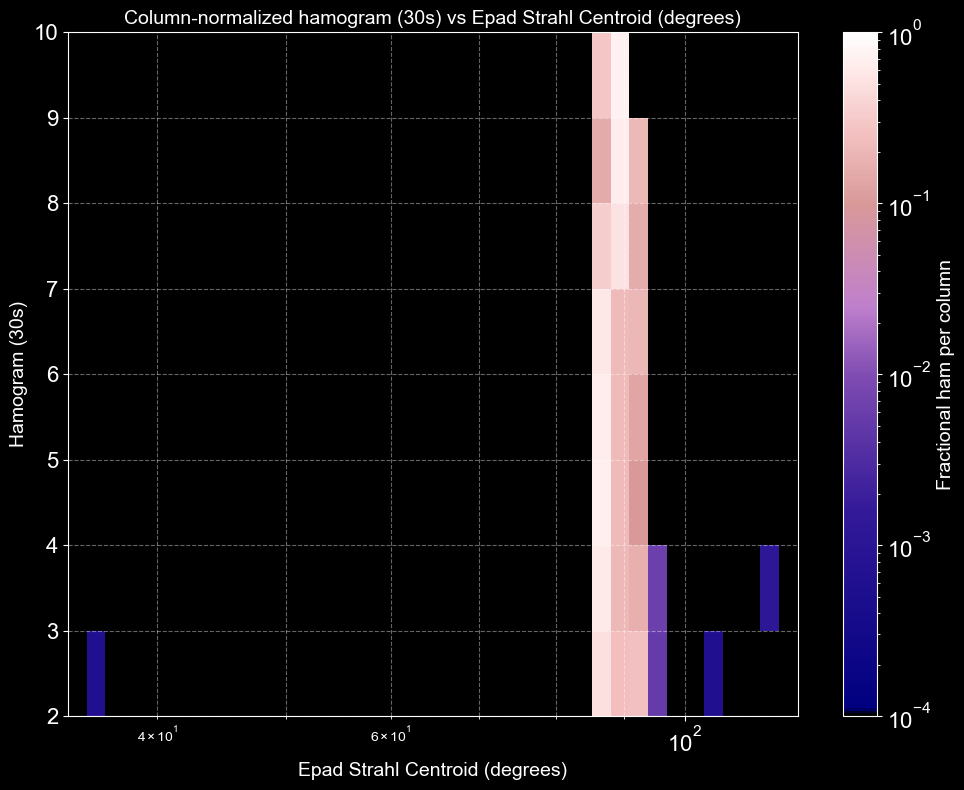

In [68]:
histoham(epad_centroid_up_data_all, ham_data_all, varname= 'Epad Strahl Centroid (degrees)')

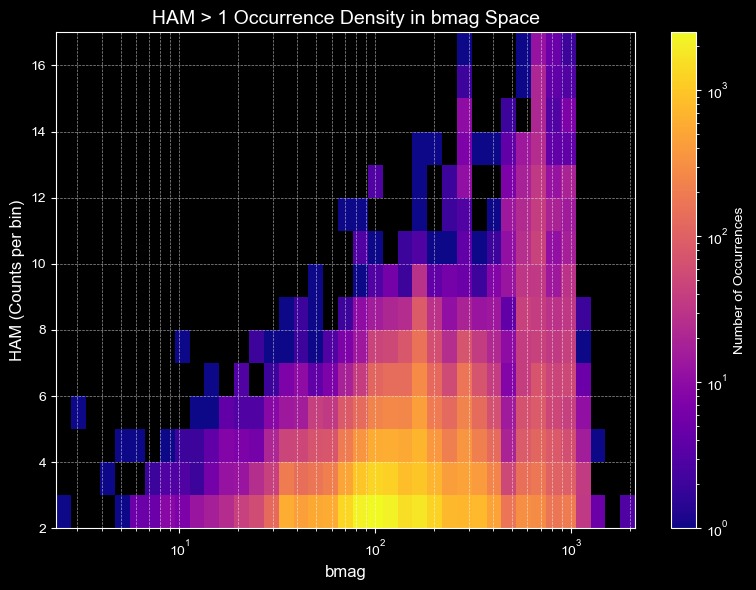

In [160]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
xvar = bmag_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(xvar) & (ham > 1)
ham_filtered = ham[valid_mask]
xvar_filtered = xvar[valid_mask]

# Define bins
xvar_bins = np.logspace(np.log10(np.nanmin(xvar_filtered)*.95), np.log10(np.nanmax(xvar_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    xvar_filtered, ham_filtered,
    bins=[xvar_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('bmag', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in bmag Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


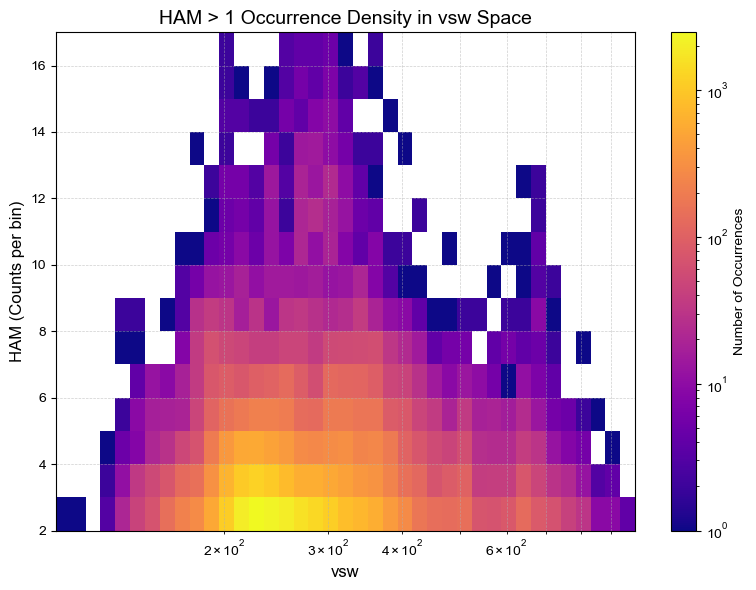

In [29]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
xvar = vsw_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(xvar) & (ham > 1)
ham_filtered = ham[valid_mask]
xvar_filtered = xvar[valid_mask]

# Define bins
xvar_bins = np.logspace(np.log10(np.nanmin(xvar_filtered)*.95), np.log10(np.nanmax(xvar_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    xvar_filtered, ham_filtered,
    bins=[xvar_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('vsw', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in vsw Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


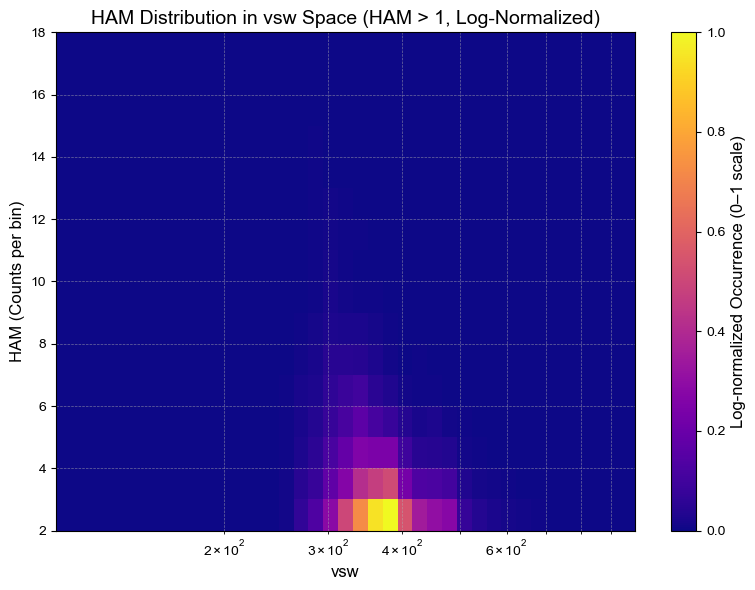

In [38]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = vsw_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (yvar_ > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(xvar)*.95), np.log10(np.nanmax(xvar)*1.05), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Apply log transform safely (avoid log(0) with small offset)
H_log = np.log10(H + 1e-3)  # Add small value to avoid -inf
H_log -= np.nanmin(H_log)  # Shift min to 0
H_log /= np.nanmax(H_log)  # Normalize max to 1

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Log-normalized Occurrence (0–1 scale)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('vsw', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('HAM Distribution in vsw Space (HAM > 1, Log-Normalized)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


NameError: name 'H_norm' is not defined

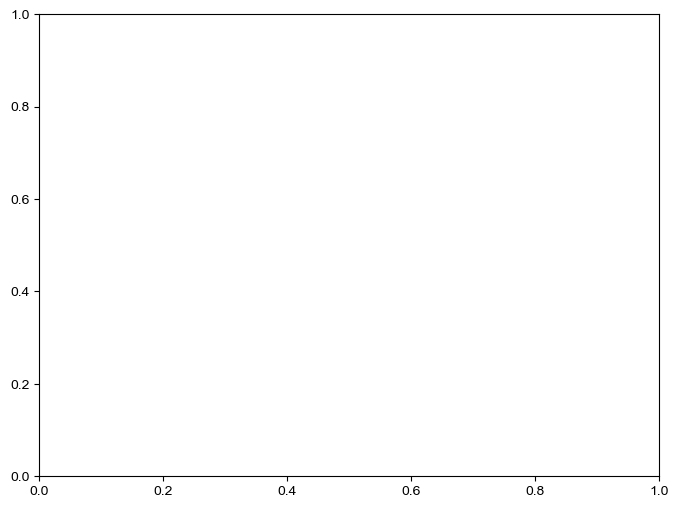

In [9]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = bmag_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (yvar_ > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(xvar)*.95), np.log10(np.nanmax(xvar)*1.05), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Apply log transform safely (avoid log(0) with small offset)
H_log = np.log10(H + 1e-3)  # Add small value to avoid -inf
H_log -= np.nanmin(H_log)  # Shift min to 0
H_log /= np.nanmax(H_log)  # Normalize max to 1

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Log-normalized Occurrence (0–1 scale)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('bmag', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('HAM Distribution in bmag Space (HAM > 1, Log-Normalized)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


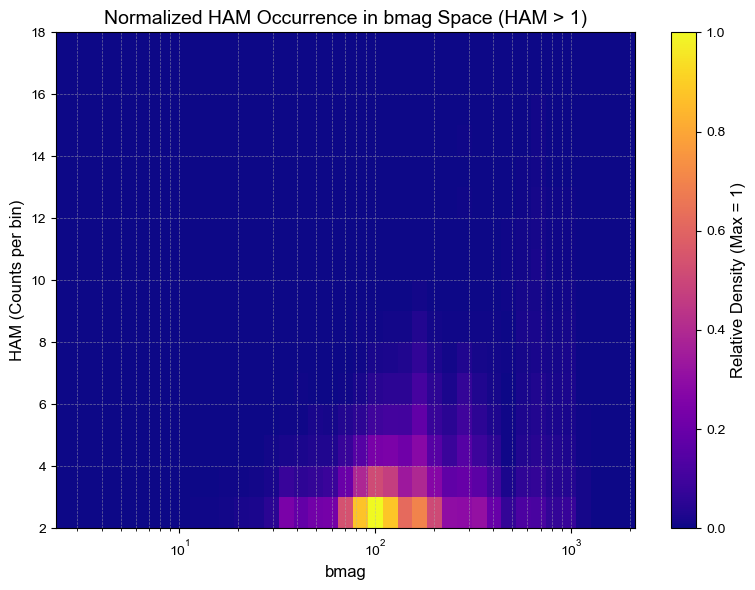

In [11]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = bmag_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (ham > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(xvar)*.95), np.log10(np.nanmax(xvar)*1.05), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Normalize to [0, 1]
H_norm = H / np.nanmax(H)

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Relative Density (Max = 1)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('bmag', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('Normalized HAM Occurrence in bmag Space (HAM > 1)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


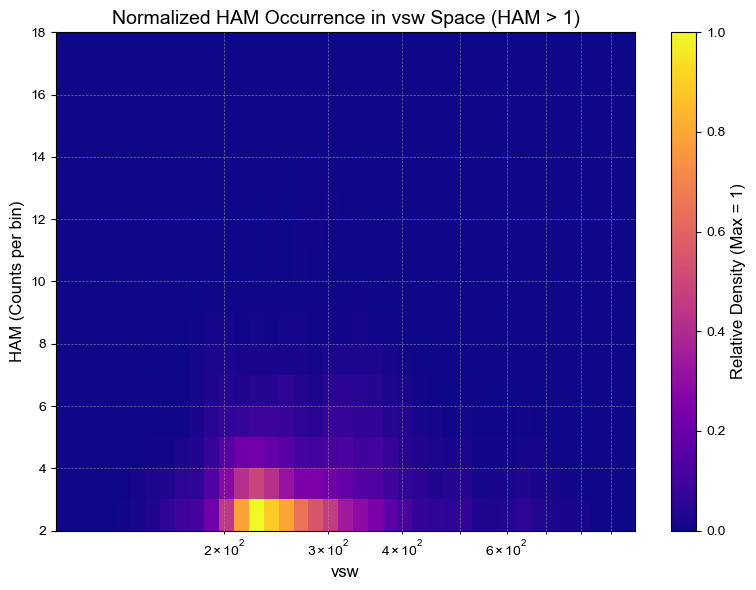

In [39]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = vsw_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (ham > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(xvar)*.95), np.log10(np.nanmax(xvar)*1.05), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Normalize to [0, 1]
H_norm = H / np.nanmax(H)

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Relative Density (Max = 1)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('vsw', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('Normalized HAM Occurrence in vsw Space (HAM > 1)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


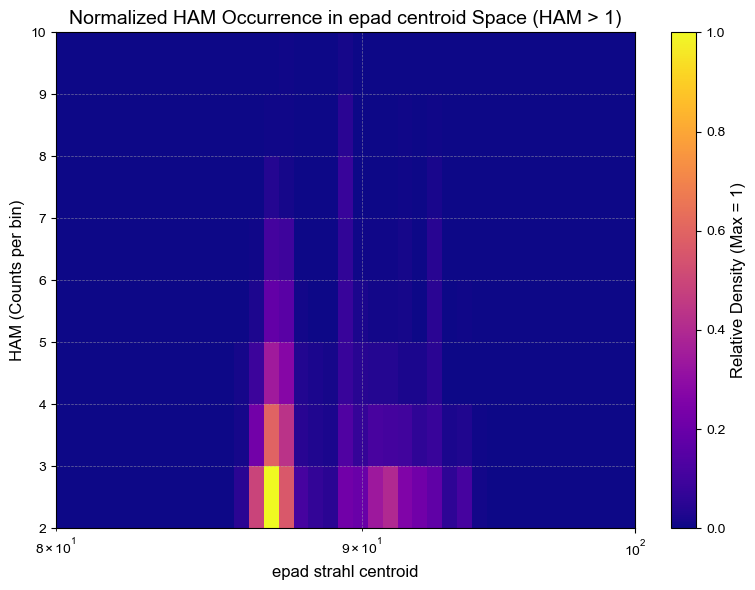

In [15]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = epad_centroid_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (ham > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(8e1), np.log10(1e2), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Normalize to [0, 1]
H_norm = H / np.nanmax(H)

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Relative Density (Max = 1)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('epad strahl centroid', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('Normalized HAM Occurrence in epad centroid Space (HAM > 1)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


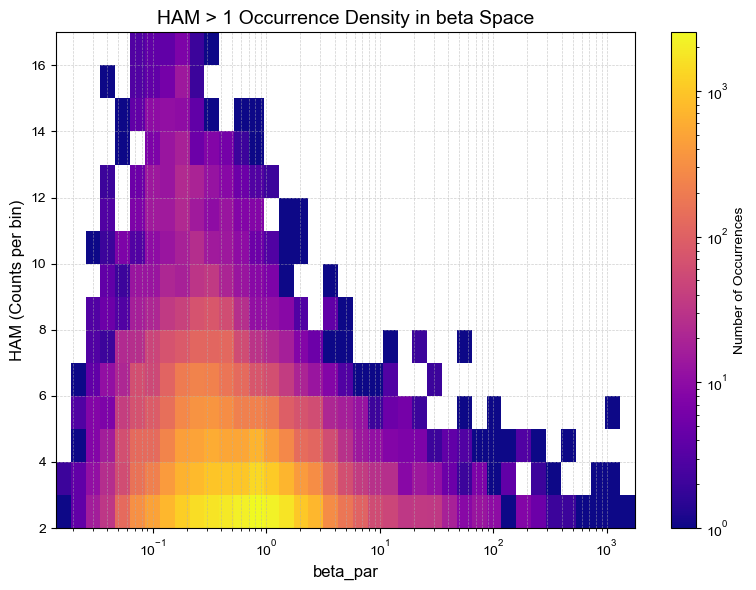

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
xvar = beta_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(xvar) & (ham > 1)
ham_filtered = ham[valid_mask]
xvar_filtered = xvar[valid_mask]

# Define bins
xvar_bins = np.logspace(np.log10(np.nanmin(xvar_filtered)*.95), np.log10(np.nanmax(xvar_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    xvar_filtered, ham_filtered,
    bins=[xvar_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('beta_par', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in beta Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


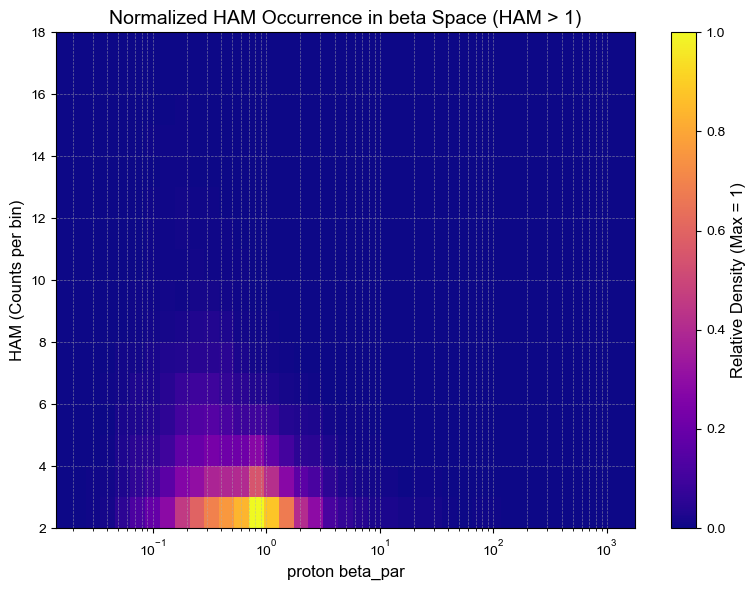

In [16]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = beta_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (ham > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(xvar)*.95), np.log10(np.nanmax(xvar)*1.05), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Normalize to [0, 1]
H_norm = H / np.nanmax(H)

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Relative Density (Max = 1)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('proton beta_par', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('Normalized HAM Occurrence in beta Space (HAM > 1)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


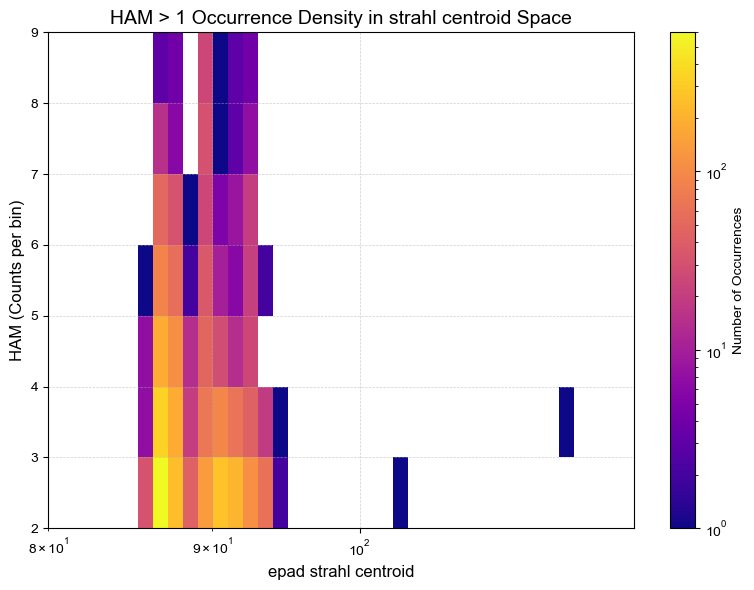

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
xvar = epad_centroid_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(xvar) & (ham > 1)
ham_filtered = ham[valid_mask]
xvar_filtered = xvar[valid_mask]

# Define bins
xvar_bins = np.logspace(np.log10(8e1), np.log10(np.nanmax(xvar_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    xvar_filtered, ham_filtered,
    bins=[xvar_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('epad strahl centroid', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in strahl centroid Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


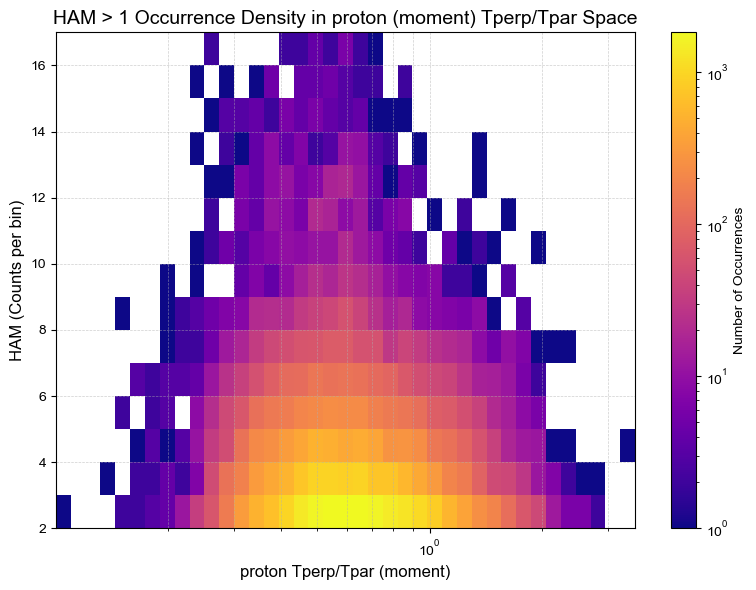

In [32]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
xvar = anisotropy_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(xvar) & (ham > 1)
ham_filtered = ham[valid_mask]
xvar_filtered = xvar[valid_mask]

# Define bins
xvar_bins = np.logspace(np.log10(np.nanmin(xvar_filtered)*.95), np.log10(np.nanmax(xvar_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    xvar_filtered, ham_filtered,
    bins=[xvar_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('proton Tperp/Tpar (moment)', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in proton (moment) Tperp/Tpar Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


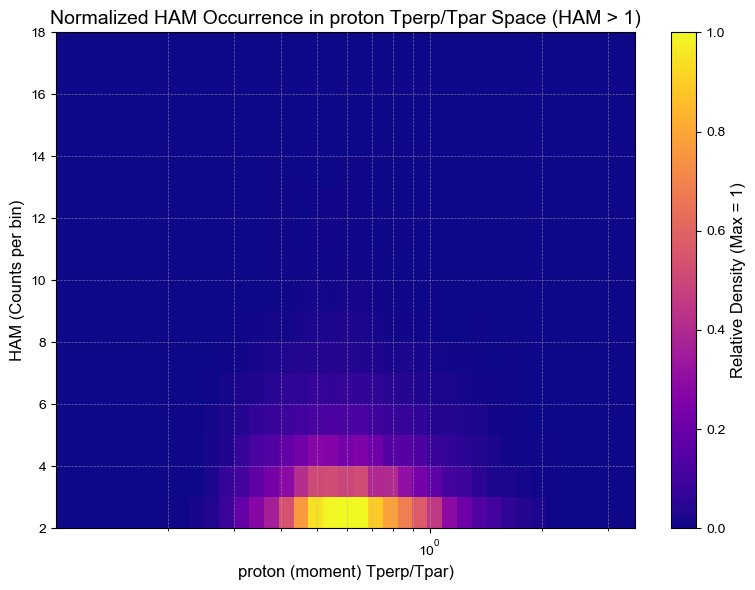

In [17]:


# Clean data
yvar_ = ham_data_all.astype(float)
xvar_ = anisotropy_up_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(yvar_) & np.isfinite(xvar_) & (ham > 1)
yvar = yvar_[valid_mask]
xvar = xvar_[valid_mask]

# Define bins
x_bins = np.logspace(np.log10(np.nanmin(xvar)*.95), np.log10(np.nanmax(xvar)*1.05), 40)
y_bins = np.arange(2, np.nanmax(yvar)+2)  # start at 2 now

# Make 2D histogram manually
H, xedges, yedges = np.histogram2d(xvar, yvar, bins=[x_bins, y_bins])

# Normalize to [0, 1]
H_norm = H / np.nanmax(H)

# Plot
fig, ax = plt.subplots(figsize=(8, 6))
mesh = ax.pcolormesh(xedges, yedges, H_norm.T, cmap='plasma', vmin=0, vmax=1)

# Colorbar
cb = fig.colorbar(mesh, ax=ax)
cb.set_label('Relative Density (Max = 1)', fontsize=12)

# Axes formatting
ax.set_xscale('log')
ax.set_xlabel('proton (moment) Tperp/Tpar)', fontsize=12)
ax.set_ylabel('HAM (Counts per bin)', fontsize=12)
ax.set_title('Normalized HAM Occurrence in proton Tperp/Tpar Space (HAM > 1)', fontsize=14)
ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

# Clean data
ham = ham_data_all.astype(float)
xvar = bm_data_all.astype(float)

# Apply mask: only keep finite values and ham > 1
valid_mask = np.isfinite(ham) & np.isfinite(xvar) & (ham > 1)
ham_filtered = ham[valid_mask]
xvar_filtered = xvar[valid_mask]

# Define bins
xvar_bins = np.logspace(np.log10(np.nanmin(xvar_filtered)*.95), np.log10(np.nanmax(xvar_filtered)*1.05), 40)
ham_bins = np.arange(2, np.nanmax(ham_filtered)+1)  # start at 2 now

# 2D histogram
plt.figure(figsize=(8, 6))
h, xedges, yedges, image = plt.hist2d(
    xvar_filtered, ham_filtered,
    bins=[xvar_bins, ham_bins],
    norm=colors.LogNorm(),
    cmap='plasma'
)

# Labels and formatting
cb = plt.colorbar(image)
cb.set_label('Number of Occurrences')

plt.xscale('log')
plt.xlabel('beta_par', fontsize=12)
plt.ylabel('HAM (Counts per bin)', fontsize=12)
plt.title('HAM > 1 Occurrence Density in beta Space', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.6)
plt.tight_layout()
plt.show()


In [19]:
print(np.nanmax(amach_up_data_all))

550.8363647460938


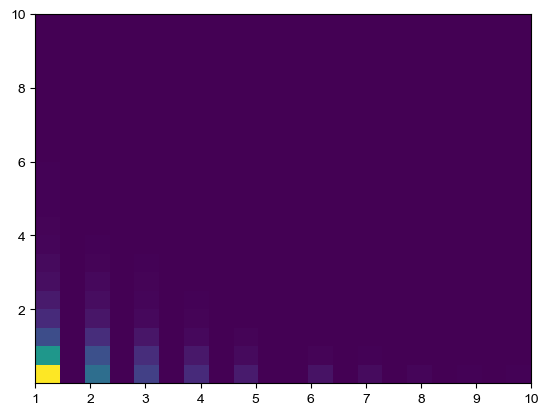

In [15]:
x = ham_data_all
y = beta_up_data_all
valid_mask = np.isfinite(x) & np.isfinite(y)
h,xb,yb, f = plt.hist2d(x[valid_mask], y[valid_mask],bins=20, range=[[1,10],[.001,10]])

In [ ]:
trange=['2020-01-25/00:00','2025-03-28/23:59']
plotbot(trange,
        ham.hamogram_30s, 1,
        proton.m_alfven, 2)

No files found for date 20200302
No files found for date 20200304
No files found for date 20200305
No files found for date 20200306
No files found for date 20200307
No files found for date 20200308
No files found for date 20200309
No files found for date 20200310
No files found for date 20200311
No files found for date 20200312
No files found for date 20200410
No files found for date 20200411
No files found for date 20200412
No files found for date 20200428
No files found for date 20200430
No files found for date 20200501
No files found for date 20200502
No files found for date 20200504
No files found for date 20200508
No files found for date 20200630
No files found for date 20200701
No files found for date 20200704
No files found for date 20200712
No files found for date 20200713
No files found for date 20200714
No files found for date 20200715
No files found for date 20200716
No files found for date 20200717
No files found for date 20200718
No files found for date 20200719
No files f

In [32]:
# Set global font settings (will figure out where this should go / how it should be implemented)
# plt.rcParams.update({
#     'font.family': 'Arial',
#     'font.sans-serif': ['Arial'],
#     'axes.labelweight': 'normal',
#     'font.weight': 'normal',
#     'mathtext.fontset': 'custom',
#     'mathtext.rm': 'Arial',
#     'mathtext.it': 'Arial:italic',
#     'mathtext.bf': 'Arial:bold'
# })

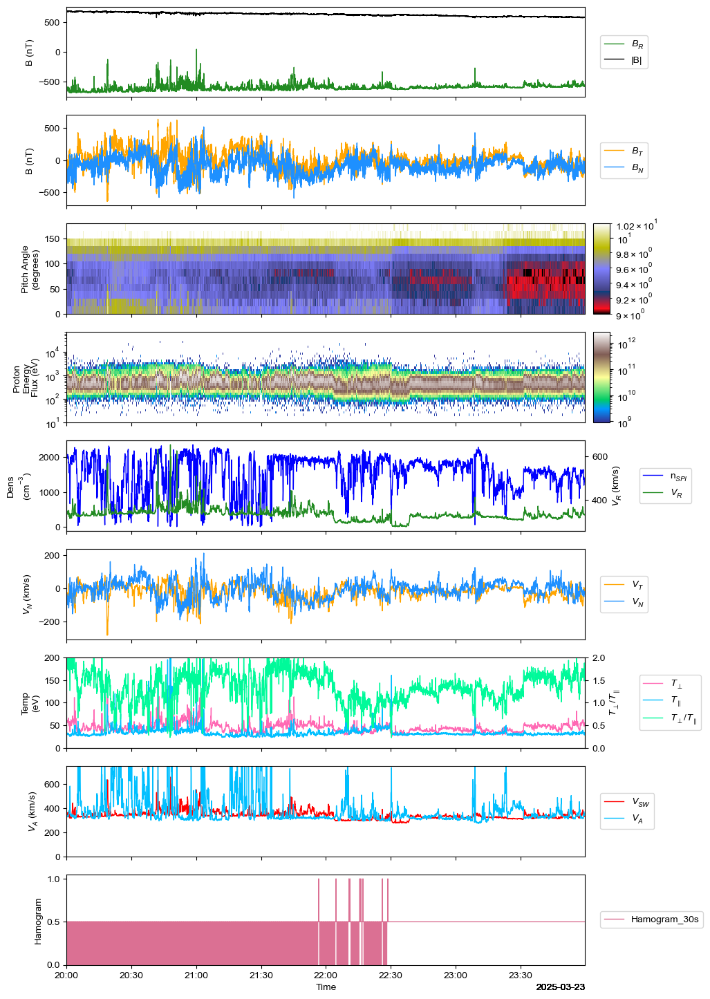

In [9]:
trange = ['2025-03-23 20:00:00.000', '2025-03-24 00:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = [9e0,1.02e1]
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,200]
proton.anisotropy.y_limit = [0,2]
proton.v_sw.y_limit = [0,750]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)

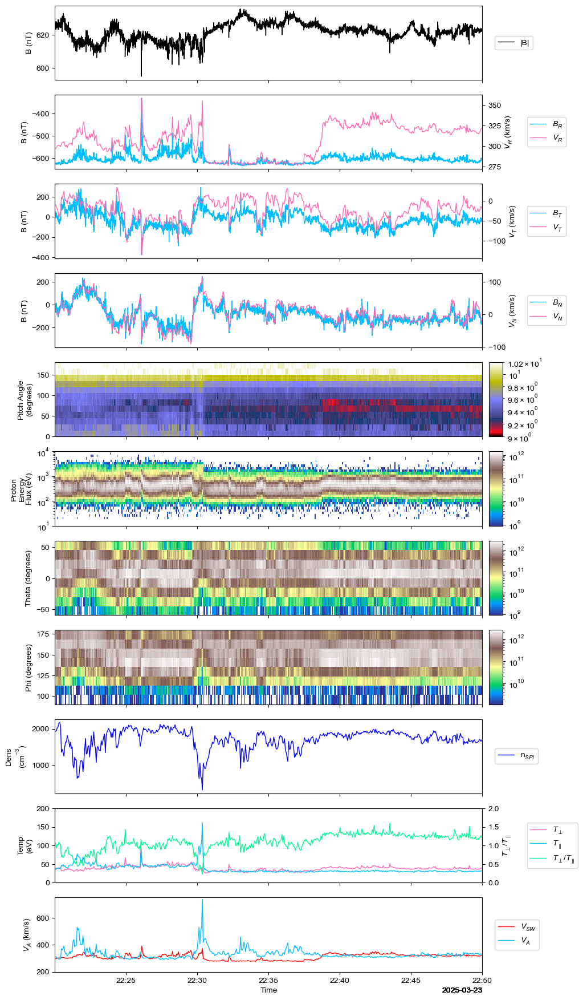

In [20]:
trange = ['2025-03-23 22:20:00.000', '2025-03-23 22:50:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.theta_flux.colormap = 'terrain'
proton.phi_flux.colormap = 'terrain'
proton.vr.color = 'hotpink'
proton.vt.color = 'hotpink'
proton.vn.color = 'hotpink'
mag_rtn_4sa.br.color = 'deepskyblue'
mag_rtn_4sa.bt.color = 'deepskyblue'
mag_rtn_4sa.bn.color = 'deepskyblue'

epad.strahl.colorbar_limits = [9e0,1.02e1]
proton.energy_flux.y_limit = [10,1e4]
proton.t_par.y_limit = [0,200]
proton.anisotropy.y_limit = [0,2]
proton.v_sw.y_limit = [200,750]


plotbot(trange, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.br, 2, proton.vr, '2r',
         mag_rtn_4sa.bt, 3, proton.vt, '3r', 
         mag_rtn_4sa.bn, 4, proton.vn, '4r',
         epad.strahl, 5, 
         proton.energy_flux, 6, 
         proton.theta_flux, 7,
         proton.phi_flux, 8,
         proton.density, 9,
         proton.t_perp, 10, proton.t_par, 10, proton.anisotropy, '10r', 
         proton.v_sw, 11, proton.v_alfven,11)

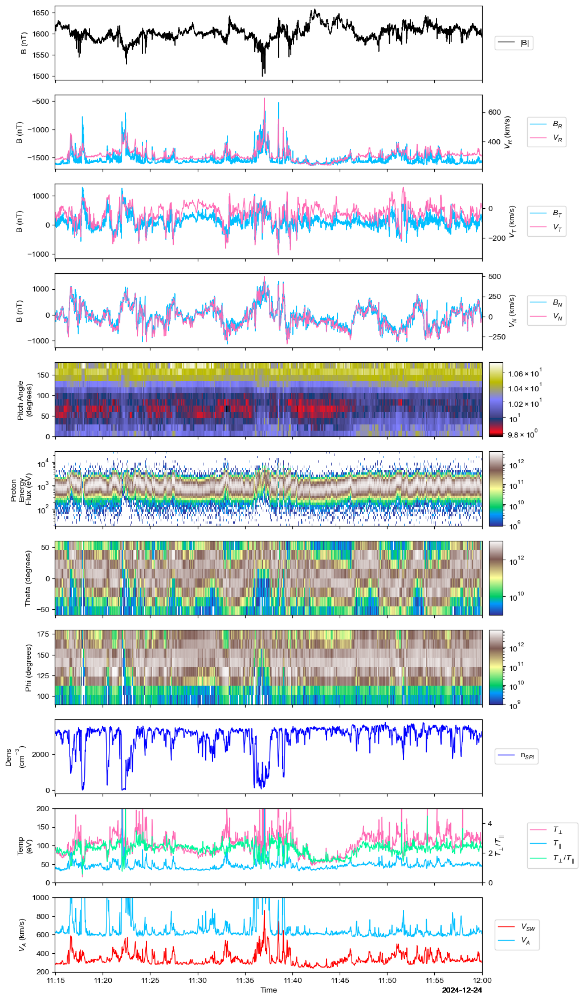

In [19]:
trange = ['2024-12-24 11:15:00.000', '2024-12-24 12:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.theta_flux.colormap = 'terrain'
proton.phi_flux.colormap = 'terrain'
proton.vr.color = 'hotpink'
proton.vt.color = 'hotpink'
proton.vn.color = 'hotpink'
mag_rtn_4sa.br.color = 'deepskyblue'
mag_rtn_4sa.bt.color = 'deepskyblue'
mag_rtn_4sa.bn.color = 'deepskyblue'

epad.strahl.colorbar_limits = None
proton.energy_flux.y_limit = None
proton.theta_flux.y_limit = None

proton.phi_flux.y_limit = None

proton.t_par.y_limit = [0,200]
proton.anisotropy.y_limit = [0,5]
proton.v_sw.y_limit = [200,1000]


plotbot(trange, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.br, 2, proton.vr, '2r',
         mag_rtn_4sa.bt, 3, proton.vt, '3r', 
         mag_rtn_4sa.bn, 4, proton.vn, '4r',
         epad.strahl, 5, 
         proton.energy_flux, 6, 
         proton.theta_flux, 7,
         proton.phi_flux, 8,
         proton.density, 9,
         proton.t_perp, 10, proton.t_par, 10, proton.anisotropy, '10r', 
         proton.v_sw, 11, proton.v_alfven,11)

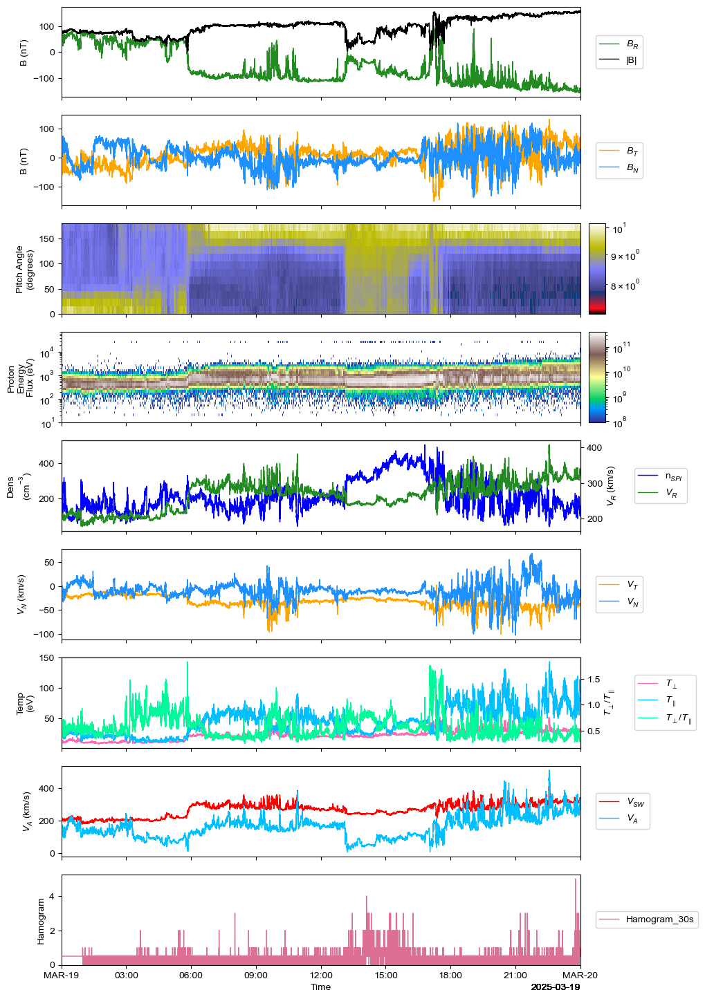

In [4]:
trange = ['2025-03-19 00:00:00.000', '2025-03-20 00:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'

proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

proton.energy_flux.y_limit = [10,7e4]



plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




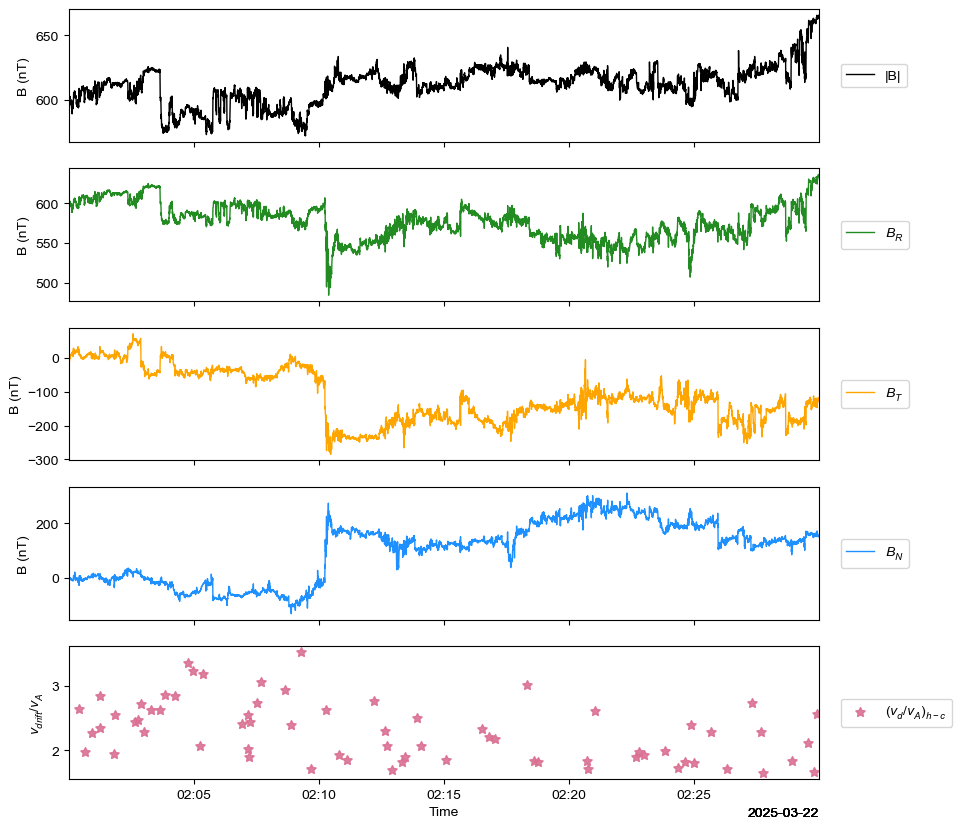

In [7]:
trange = ['2025-03-22 02:00:00.000', '2025-03-22 02:30:00.000']

ham.trat_ham.y_limit = [0,10]



plotbot(trange,
        mag_rtn_4sa.bmag,1,
        mag_rtn_4sa.br,2,
        mag_rtn_4sa.bt, 3,
        mag_rtn_4sa.bn, 4,
         ham.ham_core_drift_va, 5
         )




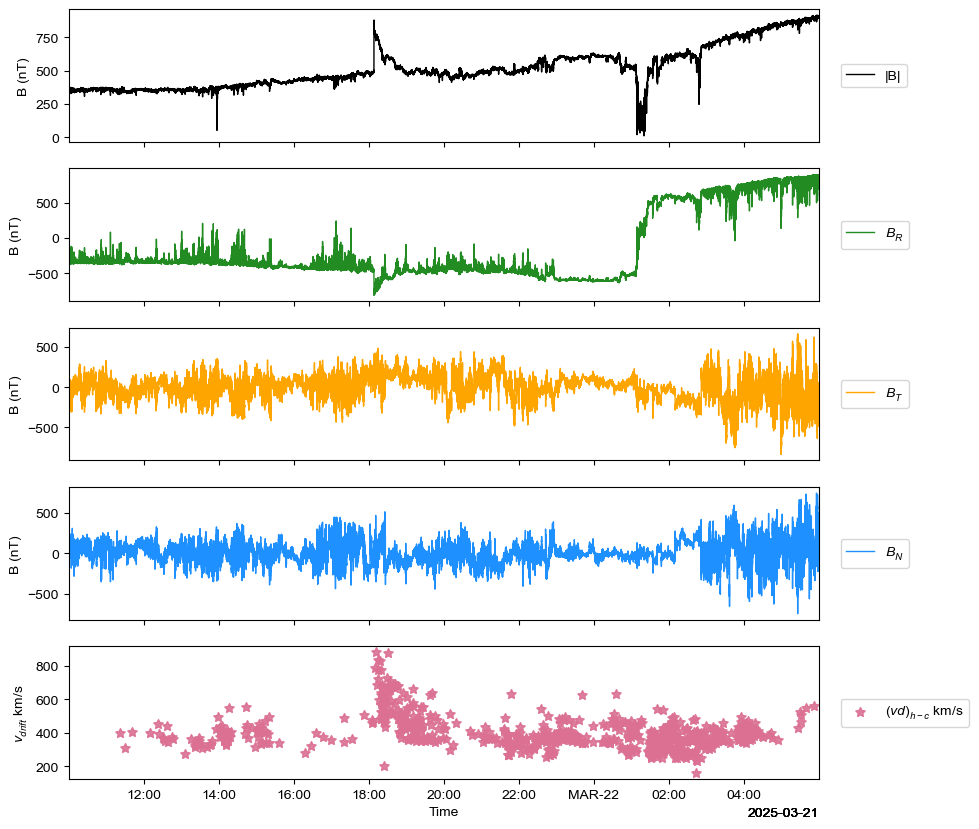

In [17]:
trange = ['2025-03-21 10:00:00.000', '2025-03-22 06:00:00.000']

ham.trat_ham.y_limit = [0,10]



plotbot(trange,
        mag_rtn_4sa.bmag,1,
        mag_rtn_4sa.br,2,
        mag_rtn_4sa.bt, 3,
        mag_rtn_4sa.bn, 4,
         ham.ham_core_drift, 5
         )


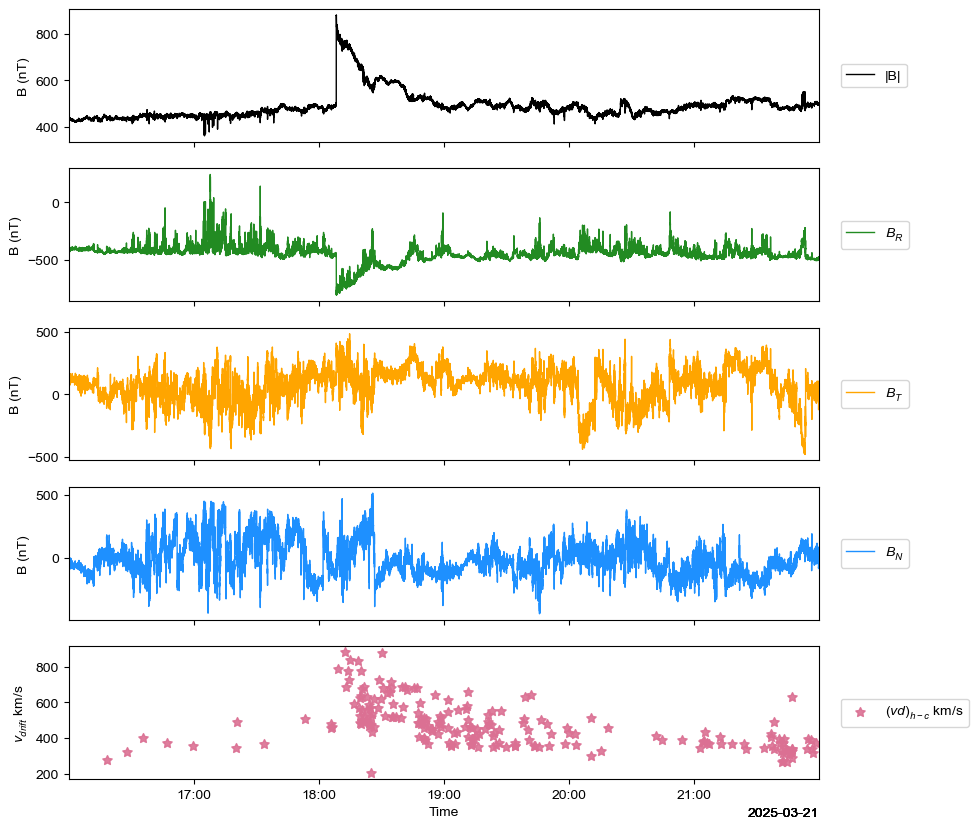

In [16]:
trange = ['2025-03-21 16:00:00.000', '2025-03-21 22:00:00.000']

ham.trat_ham.y_limit = [0,10]



plotbot(trange,
        mag_rtn_4sa.bmag,1,
        mag_rtn_4sa.br,2,
        mag_rtn_4sa.bt, 3,
        mag_rtn_4sa.bn, 4,
         ham.ham_core_drift, 5
         )


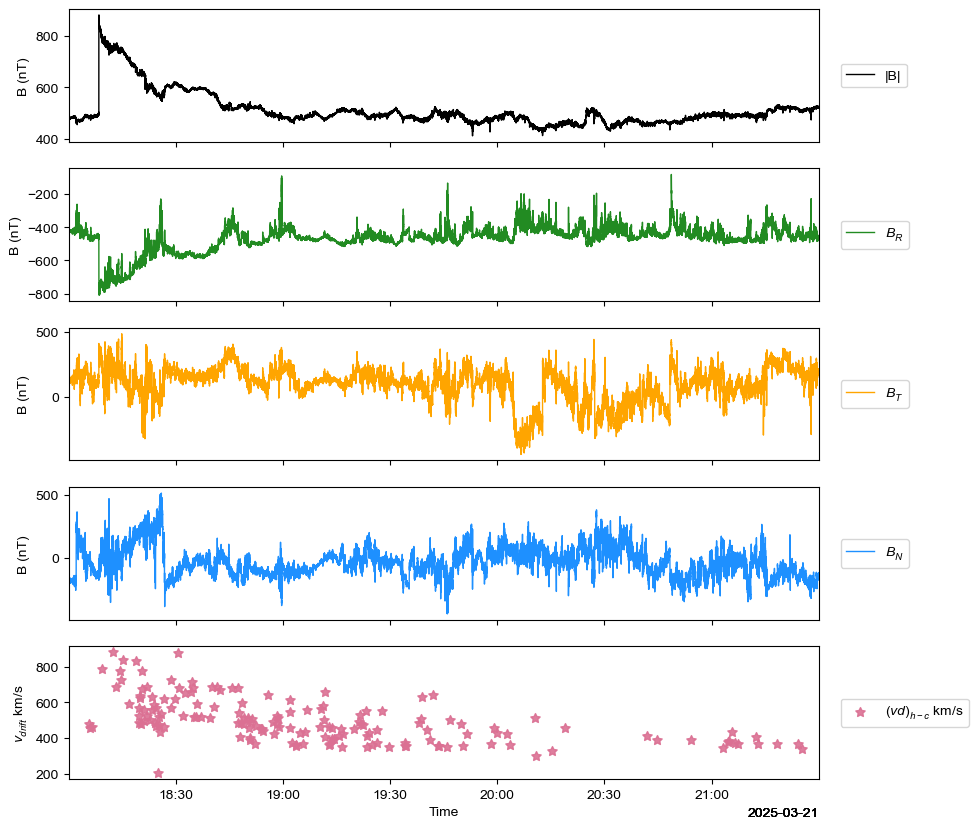

In [15]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 21:30:00.000']

ham.trat_ham.y_limit = [0,10]



plotbot(trange,
        mag_rtn_4sa.bmag,1,
        mag_rtn_4sa.br,2,
        mag_rtn_4sa.bt, 3,
        mag_rtn_4sa.bn, 4,
         ham.ham_core_drift, 5
         )


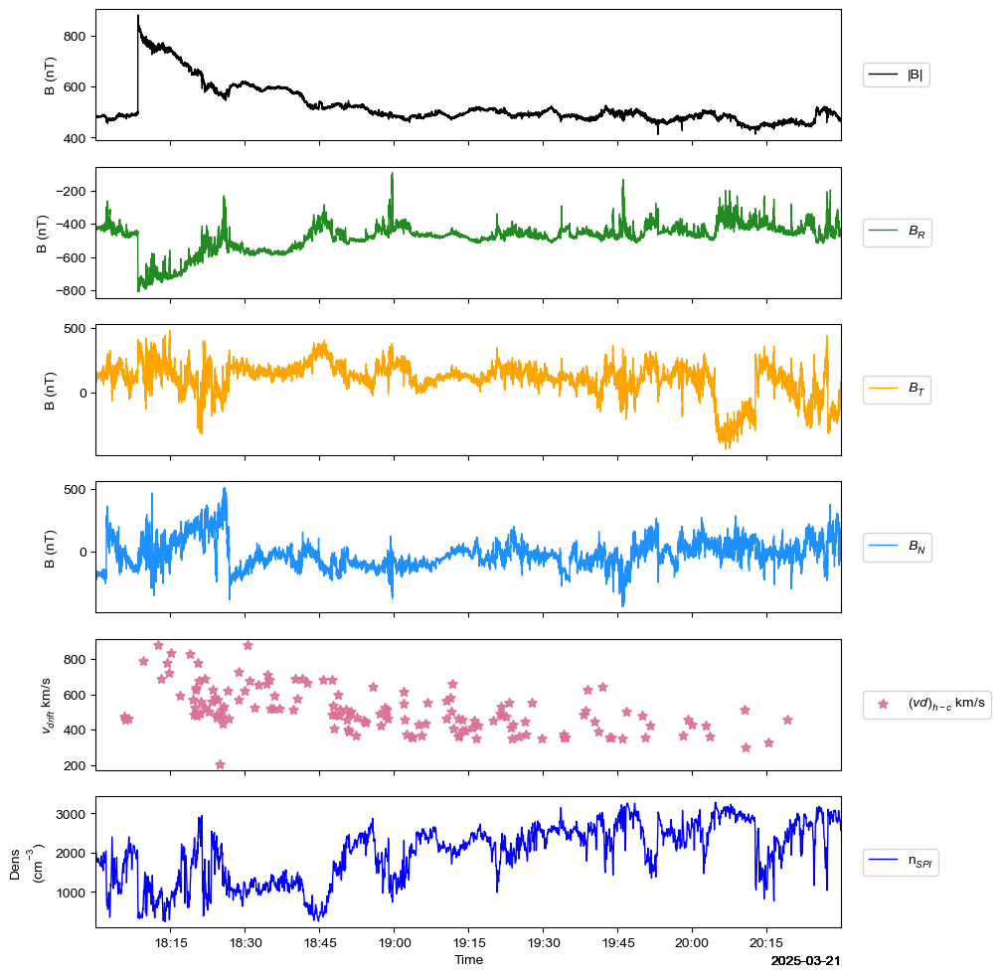

In [27]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 20:30:00.000']

ham.trat_ham.y_limit = [0,10]



plotbot(trange,
        mag_rtn_4sa.bmag,1,
        mag_rtn_4sa.br,2,
        mag_rtn_4sa.bt, 3,
        mag_rtn_4sa.bn, 4,
         ham.ham_core_drift, 5,
         proton.density, 6
         )

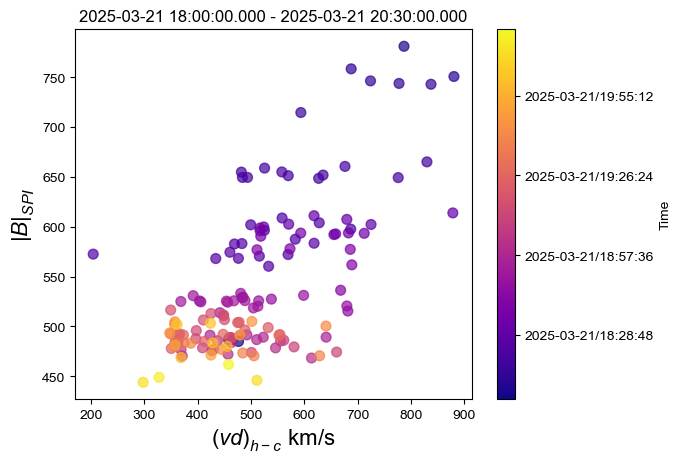

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 20:30:00.000'}, xlabel='$(vd)_{{h-c}}$ km/s', ylabel='$|B|_{SPI}$'>)

In [11]:
showdahodo(trange,ham.ham_core_drift, proton.bmag, s_ = 50)

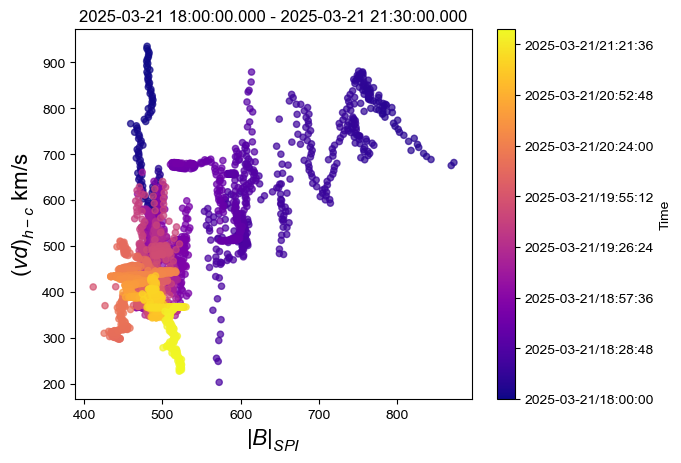

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 21:30:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(vd)_{{h-c}}$ km/s'>)

In [27]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 21:30:00.000']

showdahodo(trange,proton.bmag,ham.ham_core_drift)

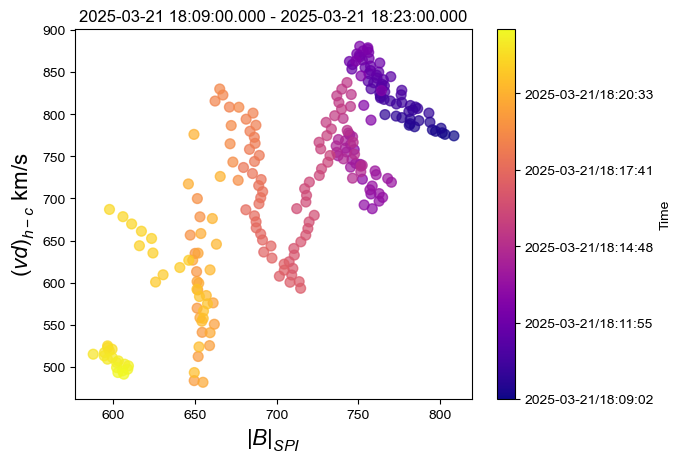

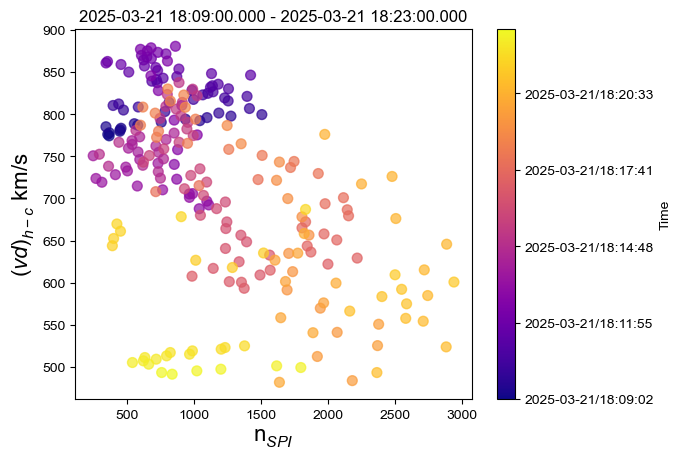

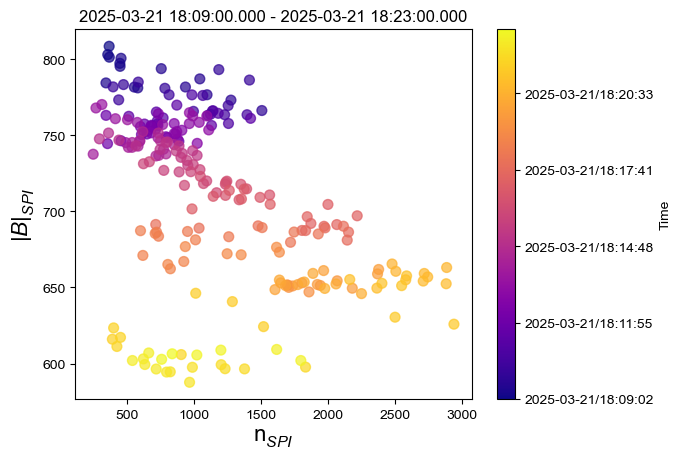

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:09:00.000 - 2025-03-21 18:23:00.000'}, xlabel='n$_{SPI}$', ylabel='$|B|_{SPI}$'>)

In [41]:
trange = ['2025-03-21 18:09:00.000', '2025-03-21 18:23:00.000']

s = 50
showdahodo(trange,proton.bmag,ham.ham_core_drift, s_ = s)
showdahodo(trange,proton.density,ham.ham_core_drift, s_ = s)
showdahodo(trange,proton.density,proton.bmag, s_ = s)

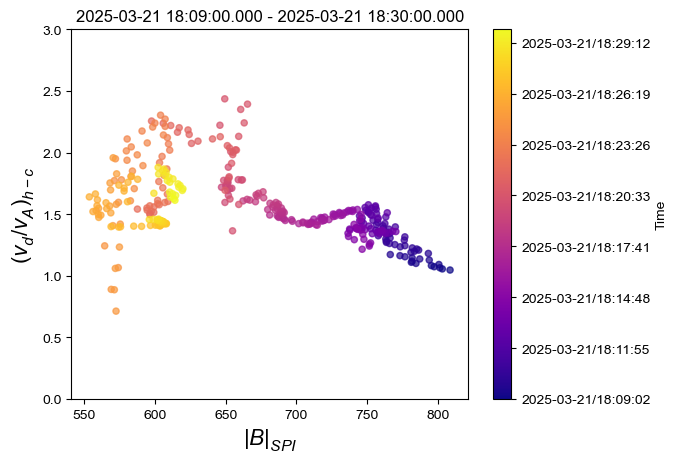

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:09:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(v_{{d}}/v_{{A}})_{{h-c}}$'>)

In [25]:
trange = ['2025-03-21 18:09:00.000', '2025-03-21 18:30:00.000']
showdahodo(trange,proton.bmag,ham.ham_core_drift_va,ylim_=[0,3])

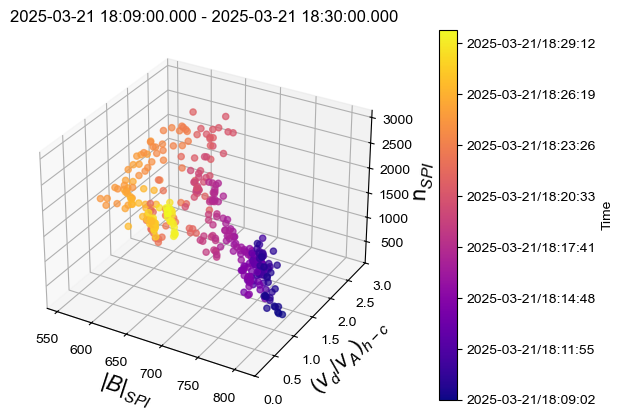

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:09:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(v_{{d}}/v_{{A}})_{{h-c}}$', zlabel='n$_{SPI}$'>)

In [28]:
trange = ['2025-03-21 18:09:00.000', '2025-03-21 18:30:00.000']
showdahodo(trange,proton.bmag,ham.ham_core_drift_va,var3 = proton.density,ylim_=[0,3])

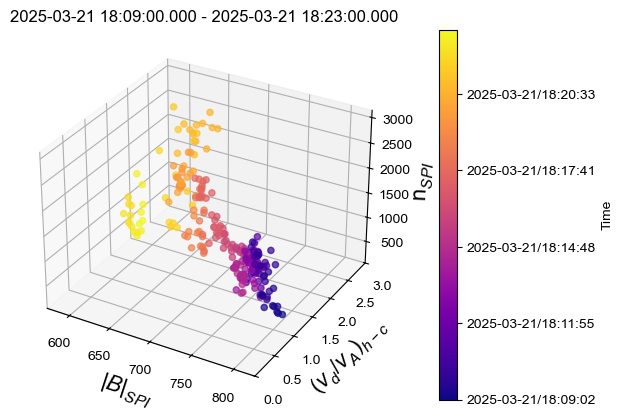

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:09:00.000 - 2025-03-21 18:23:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(v_{{d}}/v_{{A}})_{{h-c}}$', zlabel='n$_{SPI}$'>)

In [42]:
trange = ['2025-03-21 18:09:00.000', '2025-03-21 18:23:00.000']
showdahodo(trange,proton.bmag,ham.ham_core_drift_va,var3 = proton.density,ylim_=[0,3])

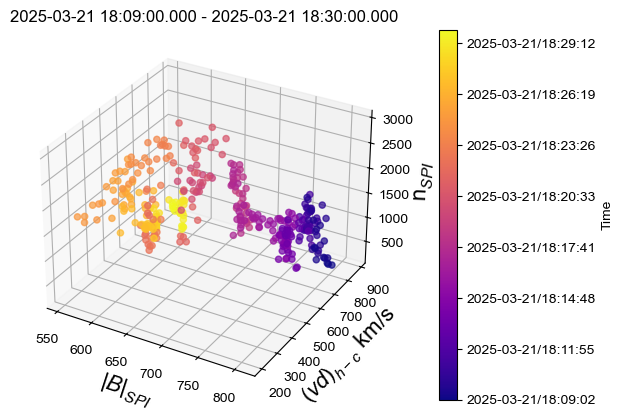

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:09:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(vd)_{{h-c}}$ km/s', zlabel='n$_{SPI}$'>)

In [46]:
trange = ['2025-03-21 18:09:00.000', '2025-03-21 18:30:00.000']
showdahodo(trange,proton.bmag,ham.ham_core_drift,var3 = proton.density,elev=0, azi=90,roll=0)

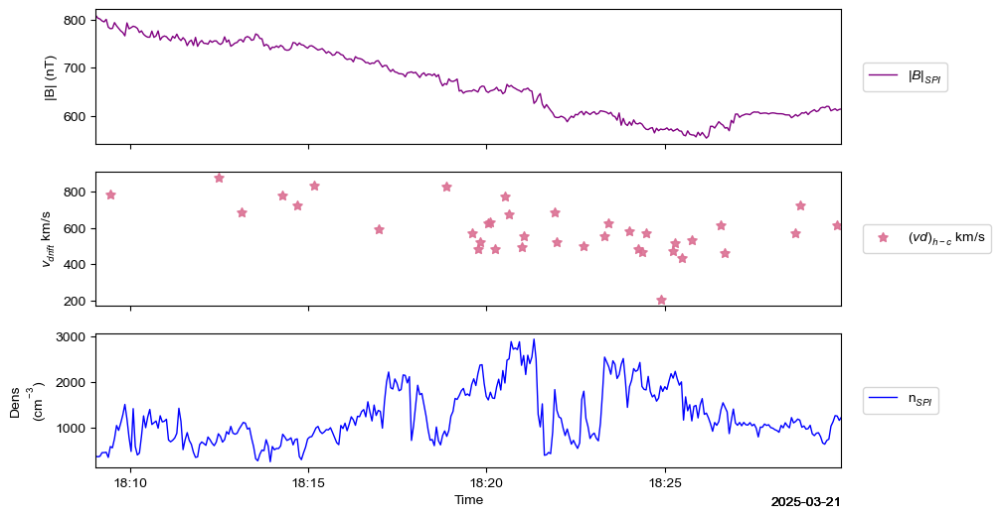

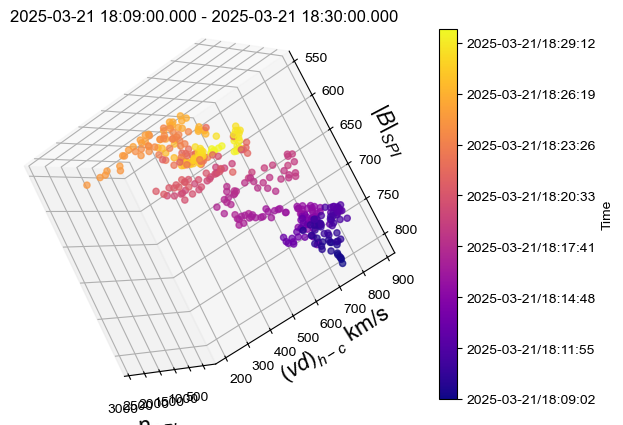

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:09:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(vd)_{{h-c}}$ km/s', zlabel='n$_{SPI}$'>)

In [54]:
trange = ['2025-03-21 18:09:00.000', '2025-03-21 18:30:00.000']
plotbot(trange,
        proton.bmag, 1,
        ham.ham_core_drift, 2,
        proton.density, 3)
showdahodo(trange,proton.bmag,ham.ham_core_drift,var3 = proton.density,elev=60, azi=60,roll=90)

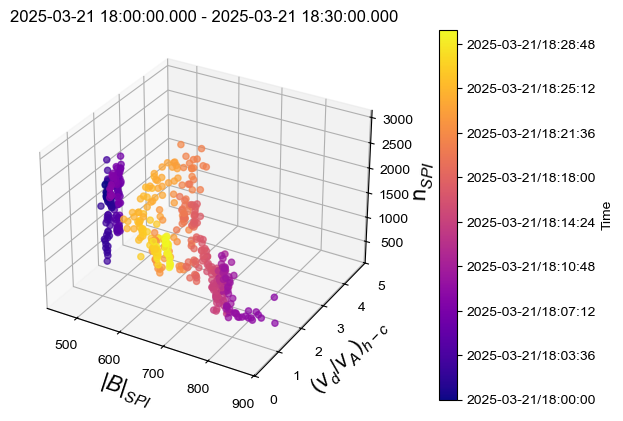

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(v_{{d}}/v_{{A}})_{{h-c}}$', zlabel='n$_{SPI}$'>)

In [34]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 18:30:00.000']
showdahodo(trange,proton.bmag,ham.ham_core_drift_va,var3 = proton.density,ylim_=[0,5])

In [ ]:
showdahodo(trange,proton.bmag,ham.ham_core_drift_va,ylim_=[0,5])

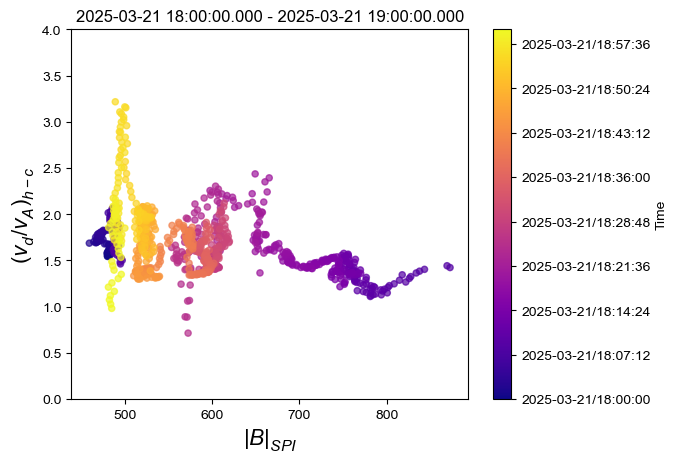

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 19:00:00.000'}, xlabel='$|B|_{SPI}$', ylabel='$(v_{{d}}/v_{{A}})_{{h-c}}$'>)

In [26]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 19:00:00.000']

showdahodo(trange,proton.bmag,ham.ham_core_drift_va,ylim_=[0,4])

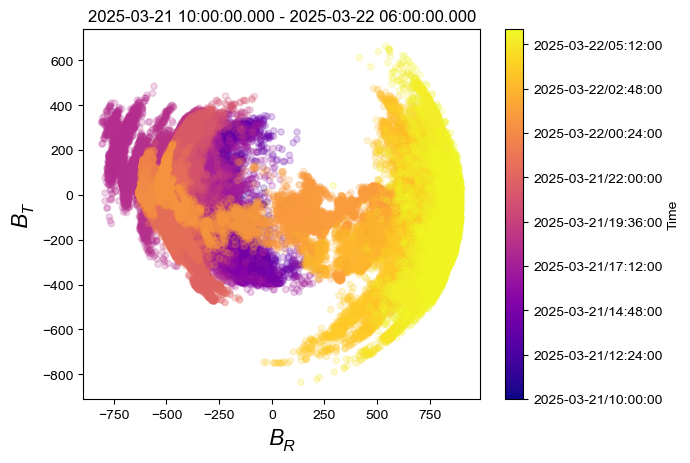

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 10:00:00.000 - 2025-03-22 06:00:00.000'}, xlabel='$B_R$', ylabel='$B_T$'>)

In [26]:
showdahodo(trange,mag_rtn_4sa.br,mag_rtn_4sa.bt,alpha_ = .2)

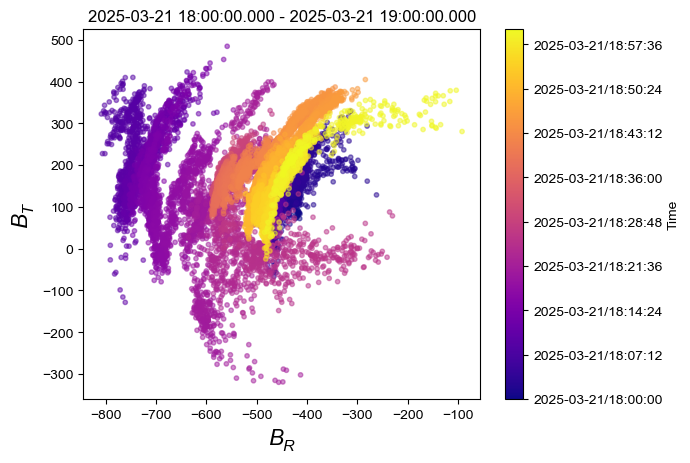

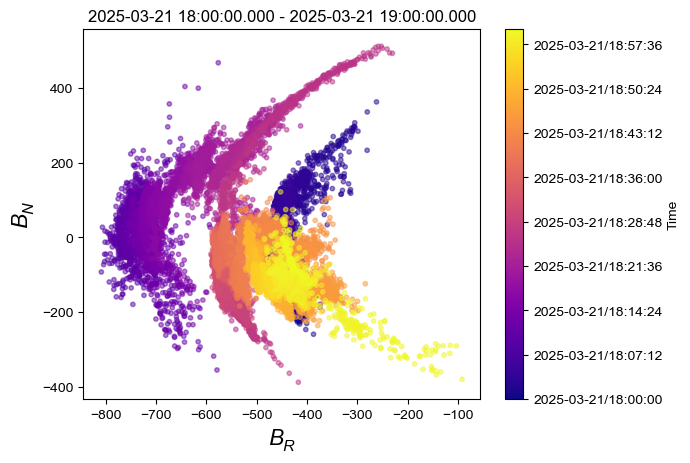

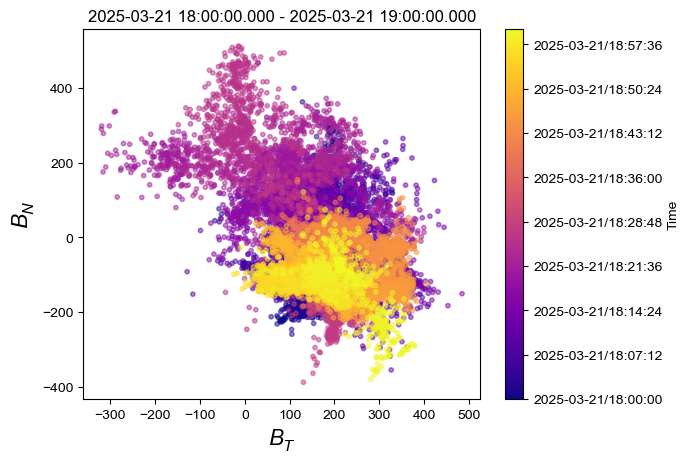

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 19:00:00.000'}, xlabel='$B_T$', ylabel='$B_N$'>)

In [38]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 19:00:00.000']

alpha = .5
s = 10
showdahodo(trange,mag_rtn_4sa.br,mag_rtn_4sa.bt,alpha_ = alpha, s_ = s)
showdahodo(trange,mag_rtn_4sa.br,mag_rtn_4sa.bn,alpha_ = alpha, s_ = s)
showdahodo(trange,mag_rtn_4sa.bt,mag_rtn_4sa.bn,alpha_ = alpha, s_ = s)

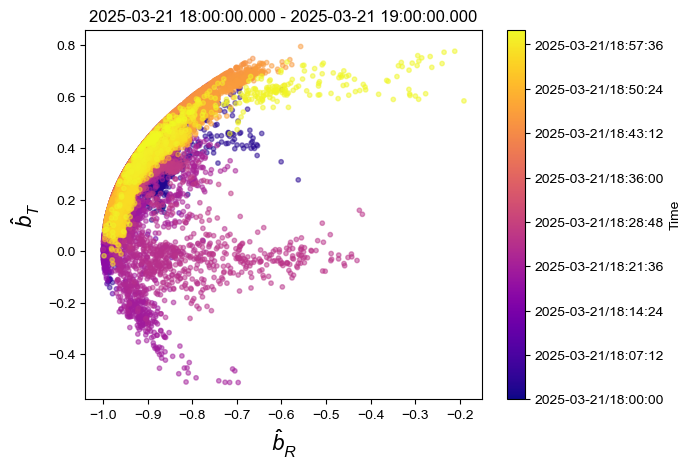

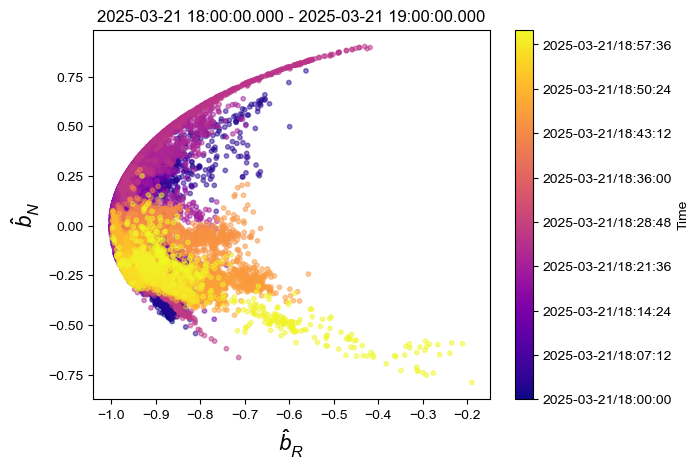

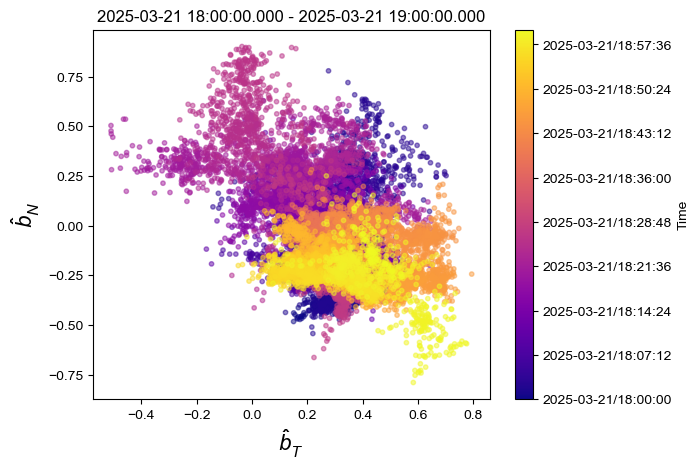

(<Figure size 640x480 with 2 Axes>,
 <Axes: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 19:00:00.000'}, xlabel='$\\hat{b}_T$', ylabel='$\\hat{b}_N$'>)

In [3]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 19:00:00.000']

alpha = .5
s = 10
showdahodo(trange,mag_rtn_4sa.br_hat,mag_rtn_4sa.bt_hat,alpha_ = alpha, s_ = s)
showdahodo(trange,mag_rtn_4sa.br_hat,mag_rtn_4sa.bn_hat,alpha_ = alpha, s_ = s)
showdahodo(trange,mag_rtn_4sa.bt_hat,mag_rtn_4sa.bn_hat,alpha_ = alpha, s_ = s)

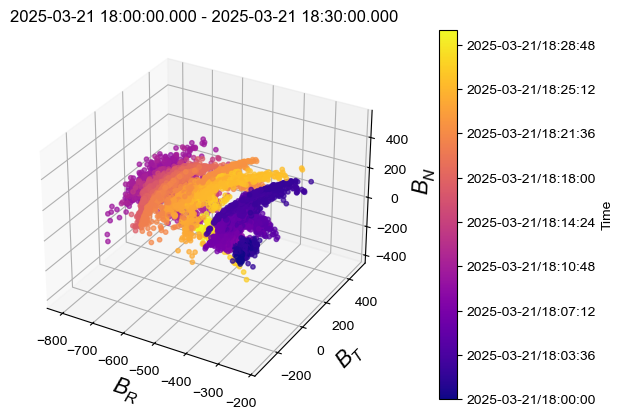

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$B_R$', ylabel='$B_T$', zlabel='$B_N$'>)

In [36]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 18:30:00.000']

showdahodo(trange,mag_rtn_4sa.br,mag_rtn_4sa.bt,var3 = mag_rtn_4sa.bn,alpha_ = .7,s_=10)

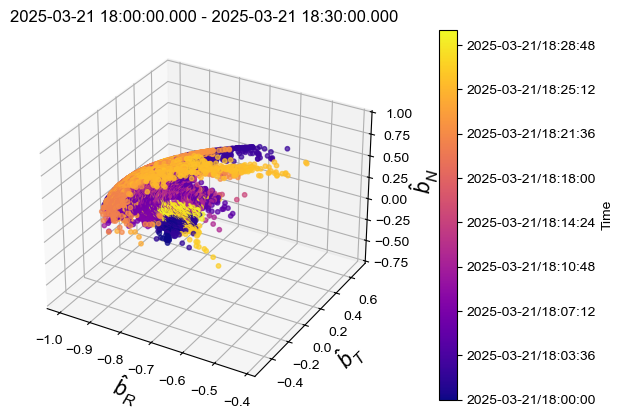

(<Figure size 640x480 with 2 Axes>,
 <Axes3D: title={'center': '2025-03-21 18:00:00.000 - 2025-03-21 18:30:00.000'}, xlabel='$\\hat{b}_R$', ylabel='$\\hat{b}_T$', zlabel='$\\hat{b}_N$'>)

In [7]:
trange = ['2025-03-21 18:00:00.000', '2025-03-21 18:30:00.000']

showdahodo(trange,mag_rtn_4sa.br_hat,mag_rtn_4sa.bt_hat,var3 = mag_rtn_4sa.bn_hat,alpha_ = .7,s_=10,elev = 180, azi = 90)

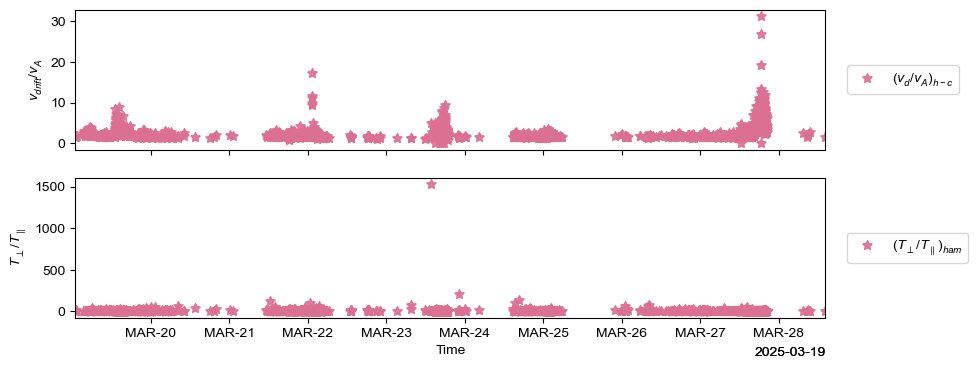

In [7]:
trange = ['2025-03-19 00:00:00.000', '2025-03-29 00:00:00.000']




plotbot(trange,
         ham.ham_core_drift_va, 1,
         ham.trat_ham, 2,
         )

No files found for date 20250328


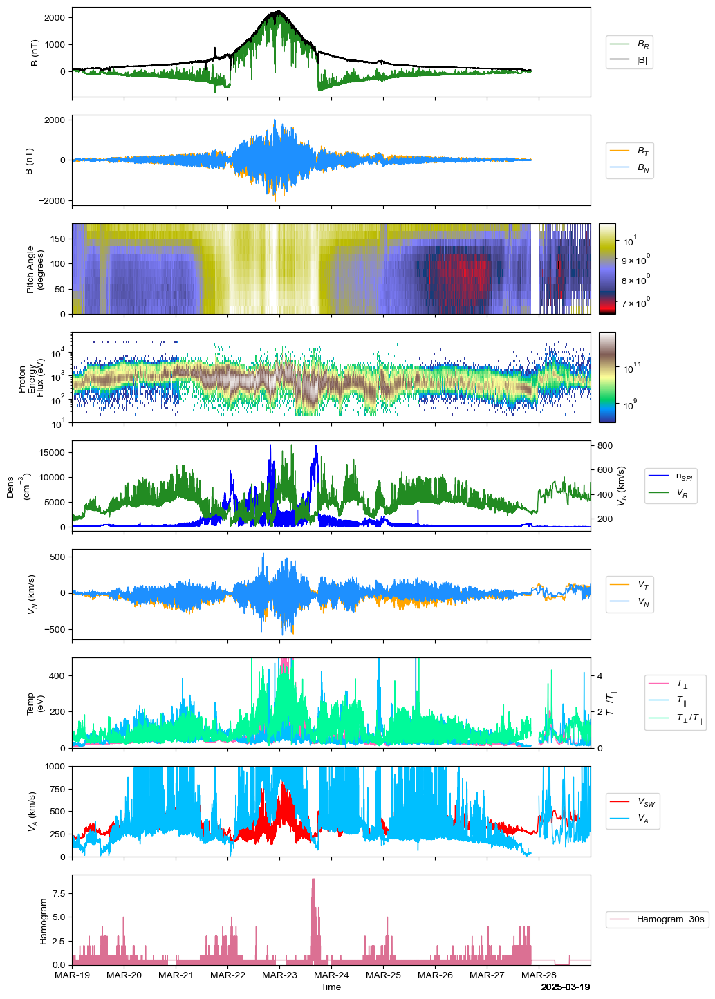

In [10]:
trange = ['2025-03-19 00:00:00.000', '2025-03-29 00:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = [6.5e0,1.1e1]
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,500]
proton.anisotropy.y_limit = [0,5]
proton.v_sw.y_limit = [0,1000]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




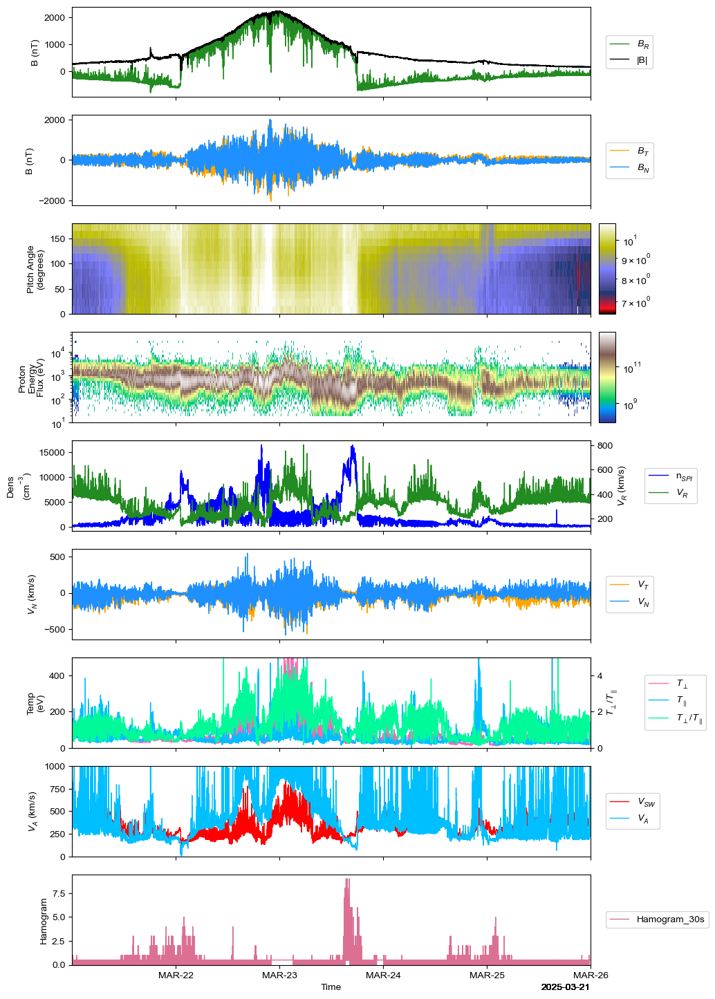

In [12]:
trange = ['2025-03-21 00:00:00.000', '2025-03-26 00:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = [6.5e0,1.1e1]
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,500]
proton.anisotropy.y_limit = [0,5]
proton.v_sw.y_limit = [0,1000]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




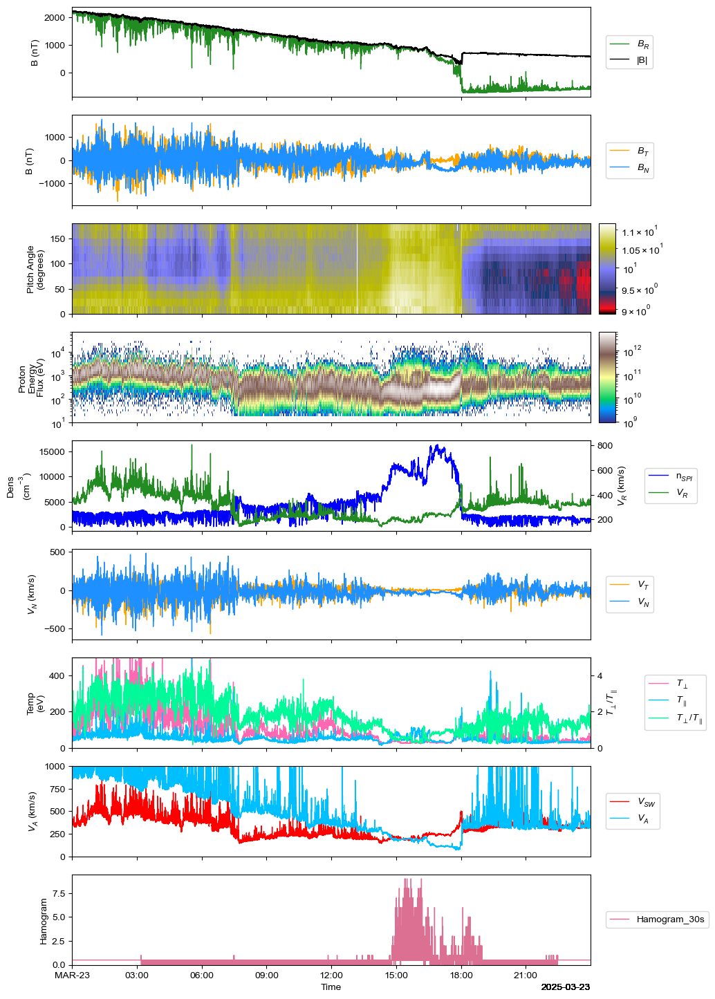

In [14]:
trange = ['2025-03-23 00:00:00.000', '2025-03-24 00:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = None
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,500]
proton.anisotropy.y_limit = [0,5]
proton.v_sw.y_limit = [0,1000]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




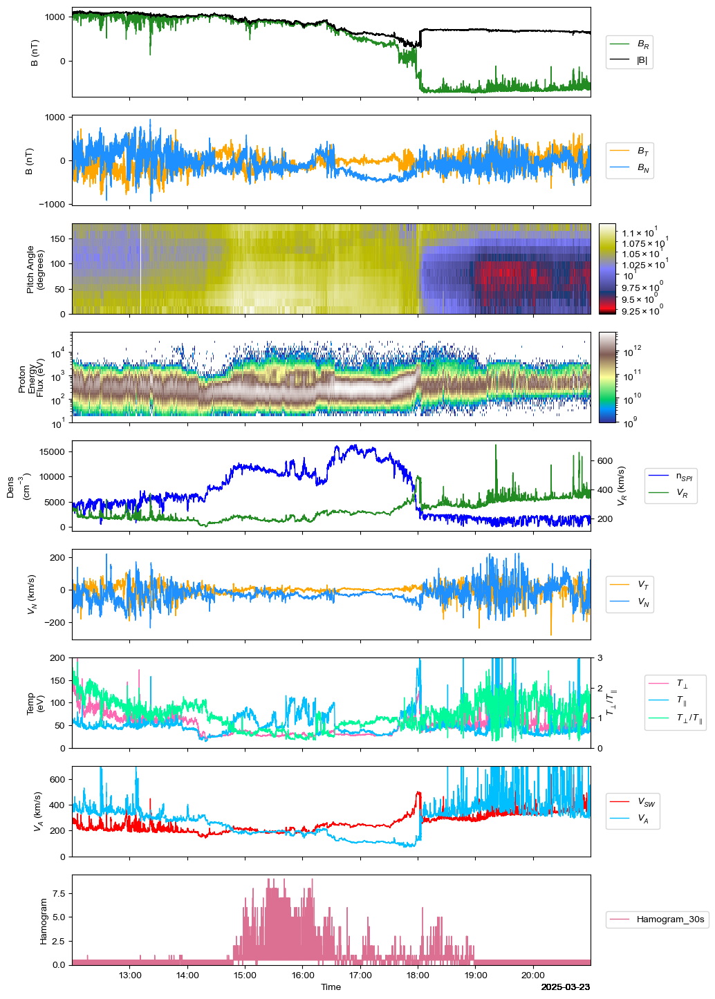

In [18]:
trange = ['2025-03-23 12:00:00.000', '2025-03-23 21:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = None
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,200]
proton.anisotropy.y_limit = [0,3]
proton.v_sw.y_limit = [0,700]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




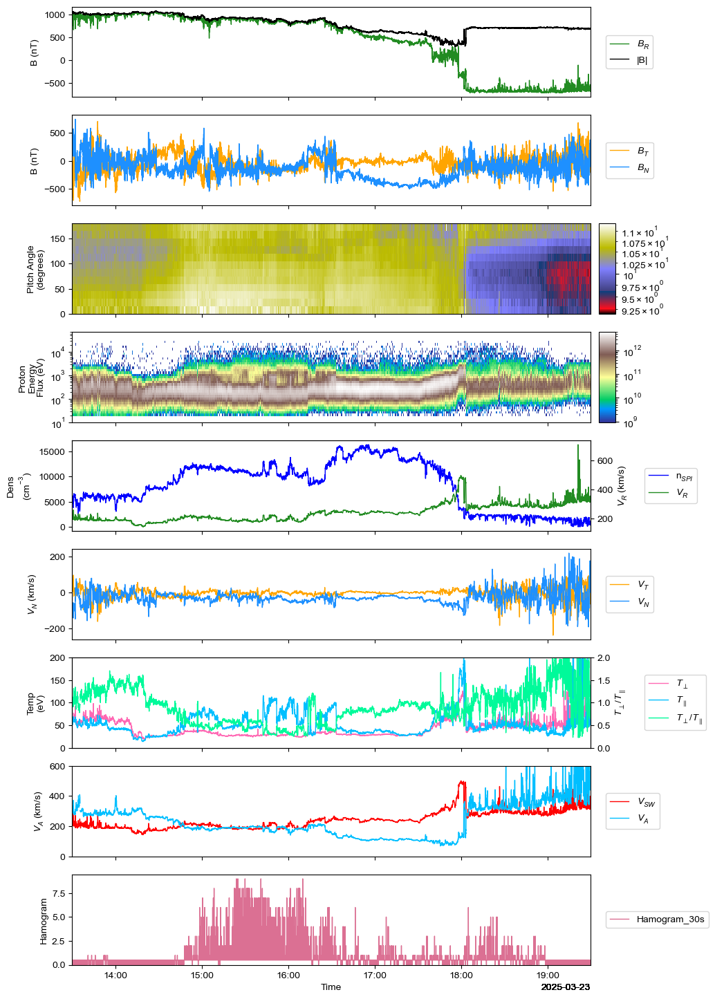

In [21]:
trange = ['2025-03-23 13:30:00.000', '2025-03-23 19:30:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = None
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,200]
proton.anisotropy.y_limit = [0,2]
proton.v_sw.y_limit = [0,600]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




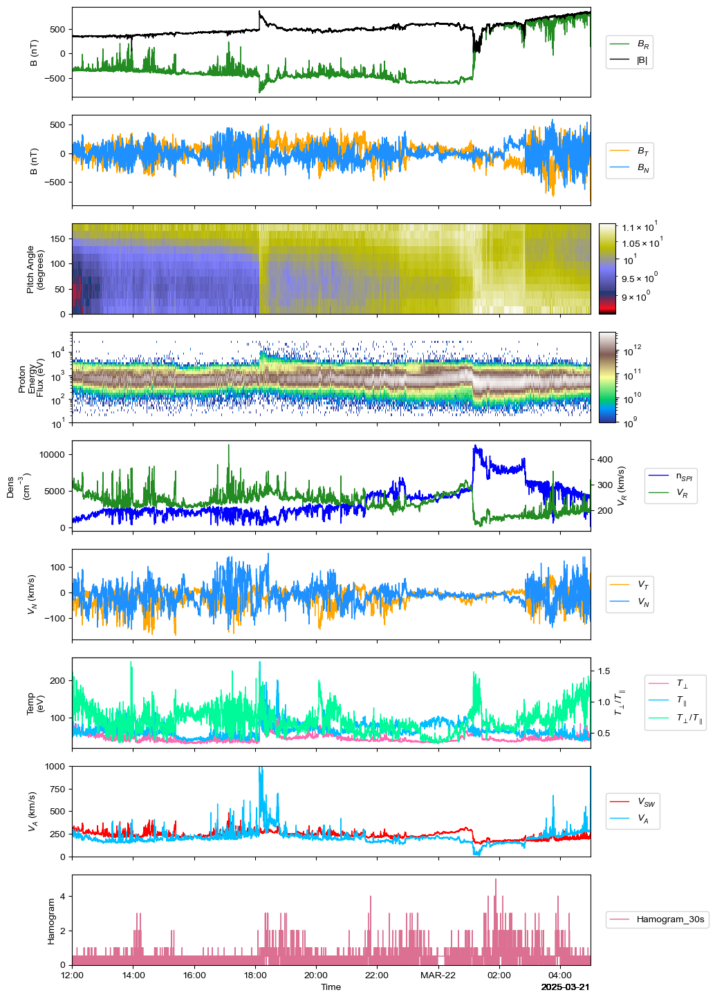

In [27]:
trange = ['2025-03-21 12:00:00.000', '2025-03-22 05:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = None
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = None
proton.anisotropy.y_limit = None
proton.v_sw.y_limit = [0,1000]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




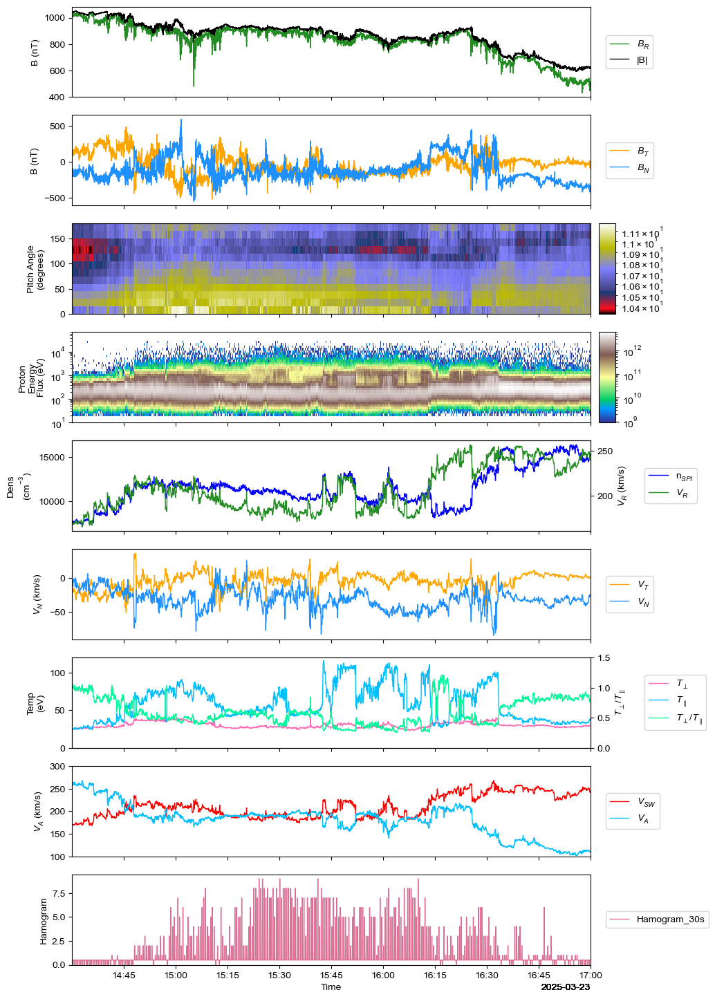

In [24]:
trange = ['2025-03-23 14:30:00.000', '2025-03-23 17:00:00.000']
epad.strahl.colormap = 'gist_stern'
epad.strahl.colorbar_scale = 'log'
proton.energy_flux.colormap = 'terrain'
proton.vr.color = 'forestgreen'
proton.vt.color = 'orange'
proton.vn.color = 'dodgerblue'

epad.strahl.colorbar_limits = None
proton.energy_flux.y_limit = [10,7e4]
proton.t_par.y_limit = [0,120]
proton.anisotropy.y_limit = [0,1.5]
proton.v_sw.y_limit = [100,300]


plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
         epad.strahl, 3, 
         proton.energy_flux, 4, 
         proton.density, 5, proton.vr, '5r',
         proton.vt, 6, proton.vn, 6,
         proton.t_perp, 7, proton.t_par, 7, proton.anisotropy, '7r', 
         proton.v_sw, 8, proton.v_alfven, 8,
         ham.hamogram_30s, 9)




--- Generating Daily Noon Multiplot Series (2025-03-19 to 2025-03-27) ---


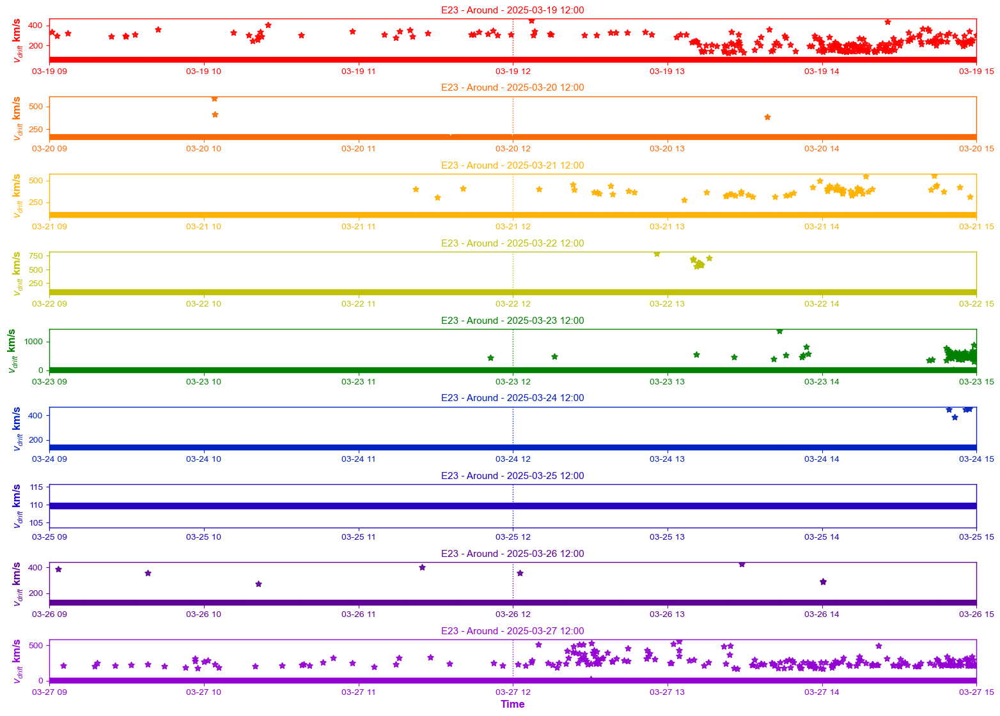

In [ ]:
# Example HAM 🍖 Multiplot Call for Ham/Core Drift Speed across Multiple Days around noon (using all the files you provided)

print("--- Generating Daily Noon Multiplot Series (2025-03-19 to 2025-03-27) ---")

# Only use the regular drift speed (not normalized)
ham_drift_vars = [
    ham.ham_core_drift  # Just the drift speed in km/s (not normalized by Alfven speed)
]

# Define ham noon times as a list of dictionaries
ham_noon_times = [
    {'time': '2025-03-19 12:00:00.000'},  # March 19th noon
    {'time': '2025-03-20 12:00:00.000'},  # March 20th noon
    {'time': '2025-03-21 12:00:00.000'},  # March 21st noon
    {'time': '2025-03-22 12:00:00.000'},  # March 22nd noon
    {'time': '2025-03-23 12:00:00.000'},  # March 23rd noon
    {'time': '2025-03-24 12:00:00.000'},  # March 24th noon
    {'time': '2025-03-25 12:00:00.000'},  # March 25th noon
    {'time': '2025-03-26 12:00:00.000'},  # March 26th noon
    {'time': '2025-03-27 12:00:00.000'},  # March 27th noon
]

# Create all plot tuples using list comprehension
all_plots = [(day['time'], var) for day in ham_noon_times for var in ham_drift_vars]

# --- Configure Plot Options ---
plt.options.reset() 

# Your existing plot parameters
plt.options.width = 20
plt.options.height_per_panel = 1.5
plt.options.hspace = 0.8

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 12
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 4

plt.options.use_single_title = False
plt.options.y_label_uses_encounter = False
plt.options.y_label_includes_time = False

plt.options.window = '6:00:00'  # +/- 3 hours around noon
plt.options.position = 'around'
plt.options.draw_vertical_line = True

plt.options.color_mode = 'rainbow'
plt.options.single_color = None

plt.options.use_relative_time = False
plt.options.use_single_x_axis = False
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

# Generate the multiplot showing all days
fig, axs = multiplot(all_plots);

--- Generating Daily Noon Multiplot Series (2025-03-19 to 2025-03-27) ---


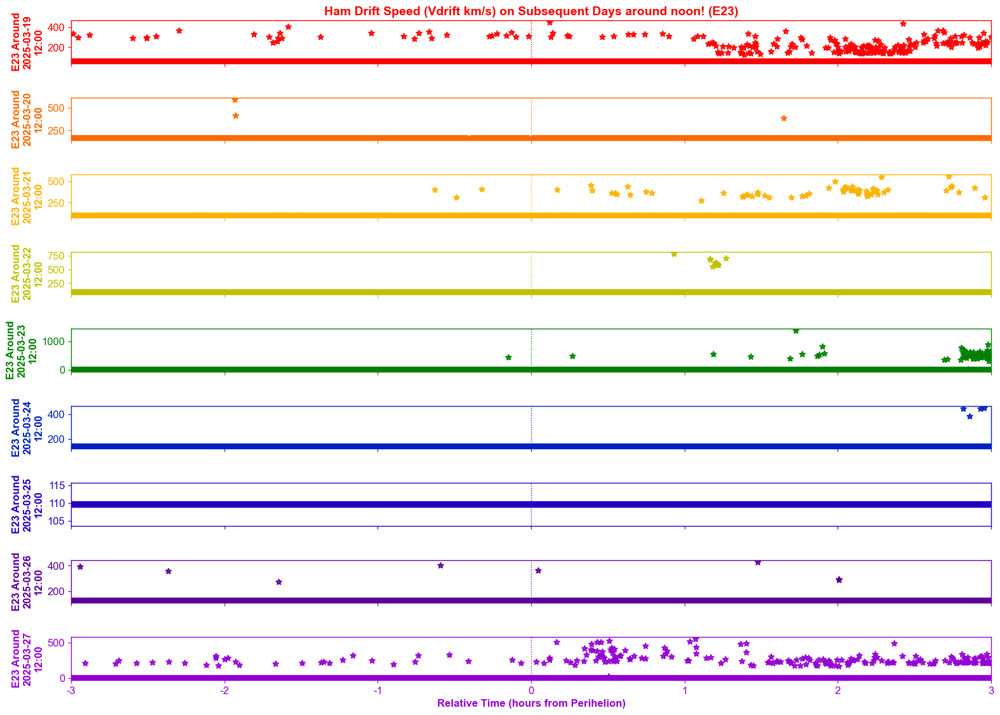

In [35]:
# REFORMATTED Example HAM 🍖 Multiplot Call for Ham/Core Drift Speed across Multiple Days around noon (using all the files you provided)

print("--- Generating Daily Noon Multiplot Series (2025-03-19 to 2025-03-27) ---")

# Only use the regular drift speed (not normalized)
ham_drift_vars = [
    ham.ham_core_drift  # Just the drift speed in km/s (not normalized by Alfven speed)
]

# Define ham noon times as a list of dictionaries
ham_noon_times = [
    {'time': '2025-03-19 12:00:00.000'},  # March 19th noon
    {'time': '2025-03-20 12:00:00.000'},  # March 20th noon
    {'time': '2025-03-21 12:00:00.000'},  # March 21st noon
    {'time': '2025-03-22 12:00:00.000'},  # March 22nd noon
    {'time': '2025-03-23 12:00:00.000'},  # March 23rd noon
    {'time': '2025-03-24 12:00:00.000'},  # March 24th noon
    {'time': '2025-03-25 12:00:00.000'},  # March 25th noon
    {'time': '2025-03-26 12:00:00.000'},  # March 26th noon
    {'time': '2025-03-27 12:00:00.000'},  # March 27th noon
]

# Create all plot tuples using list comprehension
all_plots = [(day['time'], var) for day in ham_noon_times for var in ham_drift_vars]

# --- Configure Plot Options ---
plt.options.reset() 

# Your existing plot parameters
plt.options.width = 20
plt.options.height_per_panel = 1.5
plt.options.hspace = 0.8

# Font Sizes and Padding
plt.options.title_fontsize = 14
plt.options.y_label_size = 12
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 12
plt.options.y_tick_label_size = 12
plt.options.y_label_pad = 4

plt.options.use_single_title = True
plt.options.single_title_text = 'Ham Drift Speed (Vdrift km/s) on Subsequent Days around noon! (E23)'
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = True

plt.options.window = '6:00:00'  # +/- 3 hours around noon
plt.options.position = 'around'
plt.options.draw_vertical_line = True

plt.options.color_mode = 'rainbow'
plt.options.single_color = None

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 1
plt.options.use_single_x_axis = True
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

# Generate the multiplot showing all days
fig, axs = multiplot(all_plots);

--- Generating Combined Multiplot ---
❌ ERROR: Variable has no datetime_array, cannot plot
This might be caused by a problem with custom variable lookup.
Check that you're using the registered name of the variable (e.g., 'Hello') and not the operation string (e.g., 'anisotropy + bmag')
❌ ERROR: Variable has no datetime_array, cannot plot
This might be caused by a problem with custom variable lookup.
Check that you're using the registered name of the variable (e.g., 'Hello') and not the operation string (e.g., 'anisotropy + bmag')
❌ ERROR: Variable has no datetime_array, cannot plot
This might be caused by a problem with custom variable lookup.
Check that you're using the registered name of the variable (e.g., 'Hello') and not the operation string (e.g., 'anisotropy + bmag')
❌ ERROR: Variable has no datetime_array, cannot plot
This might be caused by a problem with custom variable lookup.
Check that you're using the registered name of the variable (e.g., 'Hello') and not the operation s

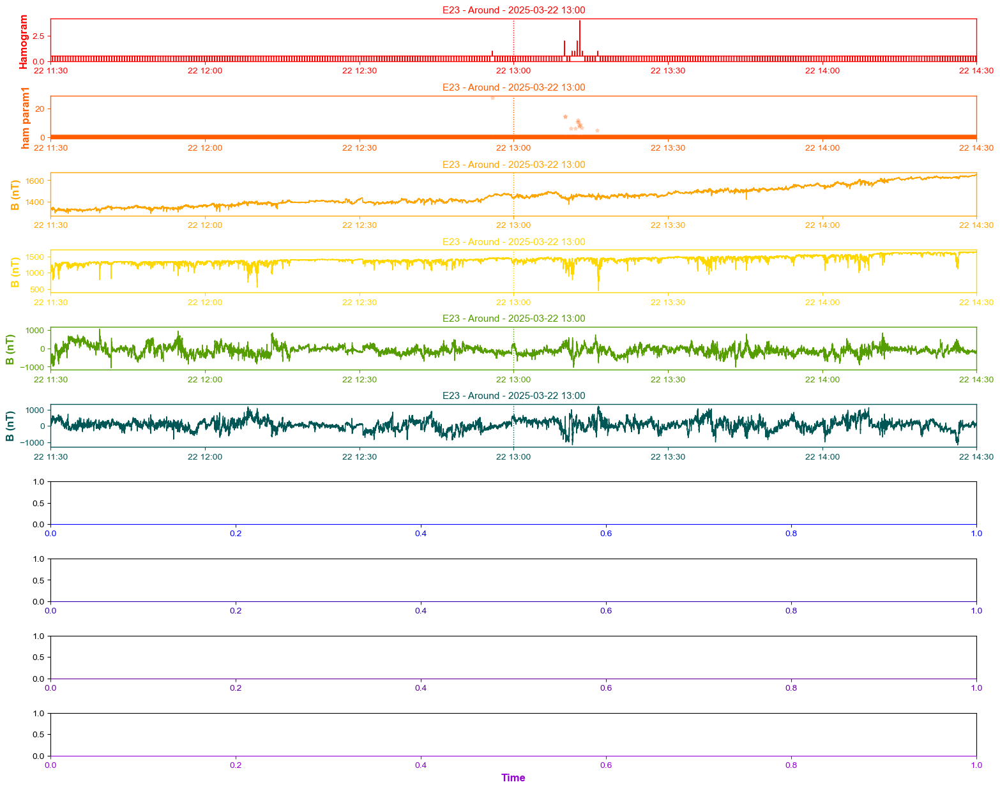


--- Combined multiplot example generated ---


In [36]:
# Mixing it up and getting a lil' wild!

print("--- Generating Combined Multiplot ---")

ham_plot_time = '2025-03-22 13:00:00'  # Updated to use HAM date we know exists

# Define time for FITS data - use direct center time instead of calculation
fits_center_time_str = '2024-09-30 12:15:00'  # Simple midpoint of FITS test range

# --- Variables and Combined Plot Data ---
# List of variables for the Hammerhead section
plot1_vars = [
    ham.hamogram_30s,
    ham.Tperprat_driftva_hc,
    mag_rtn_4sa.bmag,
    mag_rtn_4sa.br,
    mag_rtn_4sa.bt,
    mag_rtn_4sa.bn
]

# List of FITS variables for the FITS section
plot2_vars = [
    proton_fits.np1,
    proton_fits.vdrift_va_pfits,
    proton_fits.beta_ppar_pfits,
    proton_fits.Temp_tot
]

# Create the combined plot data list:
# Associate HAM/Context vars with ham_plot_time
# Associate FITS vars with fits_center_time_str
plot_data_combined = (
    [(ham_plot_time, var) for var in plot1_vars] +
    [(fits_center_time_str, var) for var in plot2_vars]
)

# --- Configure Plot Options for Combined Plot ---
plt.options.reset() # Start fresh
plt.options.width = 16
# Adjust height per panel if needed for a taller plot
total_panels = len(plot_data_combined)
plt.options.height_per_panel = 1.2 # Slightly smaller height per panel for many panels
plt.options.use_single_title = False
plt.options.single_title_text = f"Combined Plot: HAMS ({ham_plot_time}) & FITS ({fits_center_time_str})"
# Window and position will be determined by the time point for each panel individually
plt.options.window = '3:00:00.000' # Default window, will apply to each panel's center time
plt.options.position = 'around'
plt.options.draw_vertical_line = True # Draw vertical line at the center time for each panel

# Disable rainbow for clarity on combined plot
plt.options.color_mode = 'rainbow'  # Options: 'default', 'rainbow', 'single'
plt.options.single_color = None     # Used when color_mode = 'single'

plt.options.width = 20
plt.options.height_per_panel = 1.5
plt.options.hspace = 0.8

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 12
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 4

# plt.options.use_single_title = False
# plt.options.single_title_text = "Br Around PSP HCS Crossings"
plt.options.y_label_uses_encounter = False
plt.options.y_label_includes_time = False

# plt.options.draw_vertical_line = True
# plt.options.vertical_line_width = 1.5
# plt.options.vertical_line_color = 'red'
# plt.options.vertical_line_style = '--'

plt.options.use_relative_time = False
plt.options.use_single_x_axis = False
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None



# Generate the combined multiplot
# Multiplot will fetch data for EACH (time, variable) pair based on the specified time
multiplot(plot_data_combined)
# plt.show() # Keep plots displayed in notebook

print("\n--- Combined multiplot example generated ---")


TAplusBmag is not defined
🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-28/06:00:00.000', '2023-09-28/

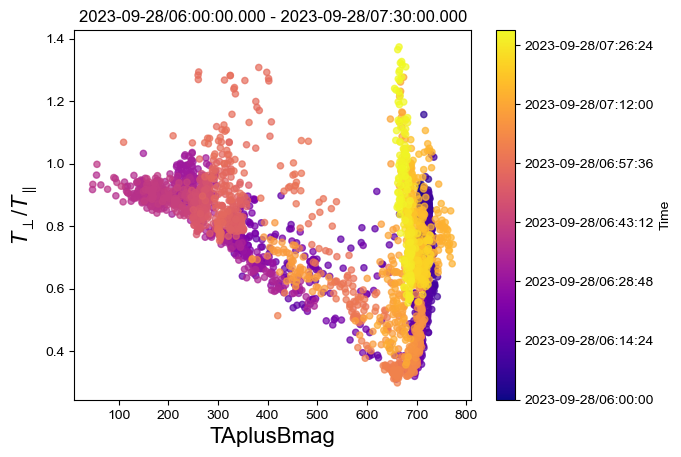

In [37]:
# # First define your time range for September 30, 2024 from 11:45 to 12:45
# trange = ['2024-09-30/11:45:00.000', '2024-09-30/12:45:00.000']

print_manager.show_status = True  # Status prints, ⭐️ useful for basic status updates

# Define a time range
trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']
# trange = ['2023-10-28/06:00:00.000', '2023-10-28/07:30:00.000']

# print('CALLING GET DATA')

# get_data(trange, proton.anisotropy, mag_rtn_4sa.bmag)

# print('CALLED GET DATA')

# Create a custom variable with our elegant syntax
TAplusBmag = custom_variable('TAplusBmag', proton.anisotropy + mag_rtn_4sa.bmag)

# Print the length of TAplusBmag
try:
    print(f"Length of TAplusBmag: {len(TAplusBmag.data_array)}")
except:
    print("TAplusBmag is not defined")


# Then use showdahodo with proton.beta_ppar on x-axis and proton.anisotropy on y-axis
# showdahodo(trange, TAplusBmag, proton.anisotropy, brazil=True);
showdahodo(trange, TAplusBmag, proton.anisotropy);

📊 Operation complete: proton.anisotropy * mag_rtn_4sa.bmag
🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

📊 Operation complete: proton.anisotropy * mag_rtn_4sa.bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ -

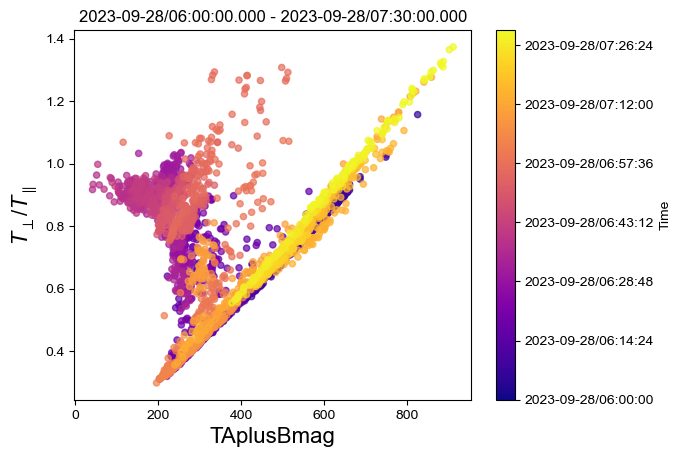

In [38]:
# # First define your time range for September 30, 2024 from 11:45 to 12:45
# trange = ['2024-09-30/11:45:00.000', '2024-09-30/12:45:00.000']

print_manager.show_status = True  # Status prints, ⭐️ useful for basic status updates

# Define a time range
trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']
# trange = ['2023-10-28/06:00:00.000', '2023-10-28/07:30:00.000']

# Create a custom variable with our elegant syntax
TAplusBmag = custom_variable('TAplusBmag', proton.anisotropy * mag_rtn_4sa.bmag)

# Then use showdahodo with proton.beta_ppar on x-axis and proton.anisotropy on y-axis
# showdahodo(trange, TAplusBmag, proton.anisotropy, brazil=True);
showdahodo(trange, TAplusBmag, proton.anisotropy);

🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ custom_data_type - acquiring variables: TAplusBmag
 
📤 Custom variable 'TAplusBmag' requires data for calculation
🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: bmag
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_

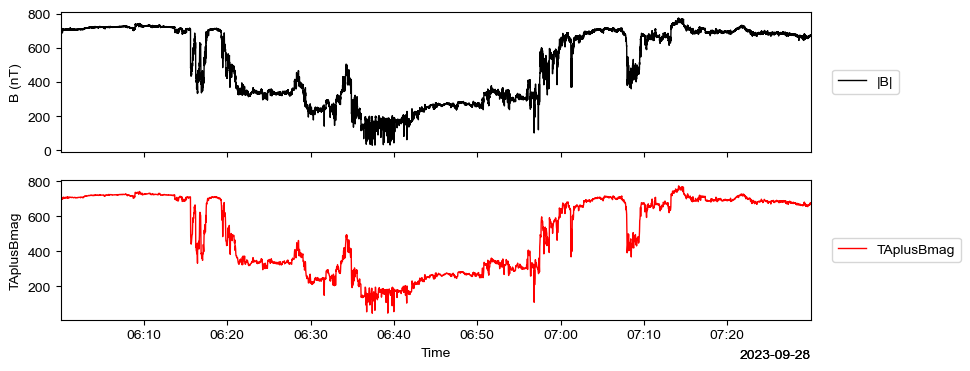

In [39]:
#Custom Variable Example!

print_manager.show_status = True  # Status prints, ⭐️ useful for basic status updates

# Define a time range
trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']

# Create a custom variable with our elegant syntax
TAplusBmag = custom_variable('TAplusBmag', proton.anisotropy + mag_rtn_4sa.bmag)

# The variable is now globally accessible as TAoverBmag

# Customize the appearance of the custom variable
TAplusBmag.color = 'red'
TAplusBmag.line_style = '-'
TAplusBmag.line_width = 1
TAplusBmag.legend_label = 'Custom Label'

plotbot(trange, mag_rtn_4sa.bmag, 1, TAplusBmag, 2)

In [40]:
# STOP 😎 #Who's callin this guy invalid!?
# #This just makes the Run All command stop...

We're downloading a LOT of data here. This will take a while, but we only need to do it once and then we'll load from the local .cdf files!
Hold tight 🙏

Panel 1: Custom variable detected: AnisotropyMinusBmag
🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230927_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-27/20:28:00.000000', '2023-09-28/02:28:00.000000'].

📥 Updating mag_RTN_4sa...
📡 spi_sf00_l3_mom - Local .cdf files already exist:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230927_v04.cdf, psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-27/20:28:00.000000', '2023-09-

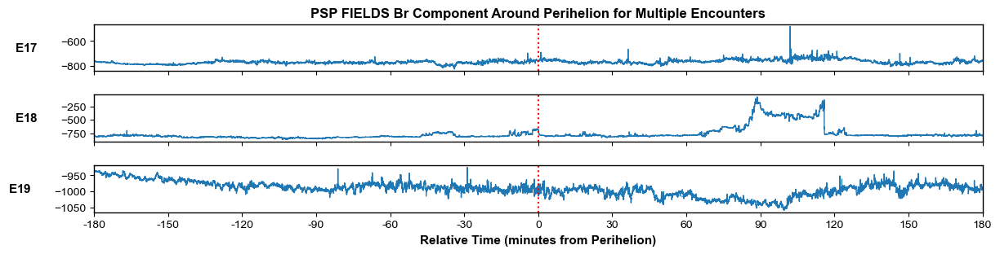

In [41]:
encounters = [

    {'perihelion': '2023/09/27 23:28:00.000'}, #Enc 17
    {'perihelion': '2023/12/29 00:56:00.000'}, #Enc 18
    {'perihelion': '2024/03/30 02:21:00.000'}, #Enc 19 

]

#######-----📈📈📈📈📈 MULTIPLOTTING MAGIC 📉📉📉📉📉📉-----#######

plt.options.reset() # Resetting options to ensure a clean slate

# Plot Setup
plt.options.width = 15
plt.options.height_per_panel = 1

plt.options.use_single_title = True
plt.options.single_title_text = "PSP FIELDS Br Component Around Perihelion for Multiple Encounters"
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'minutes'
plt.options.relative_time_step = 30

# Rainbow Plot 🌈 -- Uncomment the second set for a single color plot!
# plt.options.color_mode = 'default'  # Options: 'default', 'rainbow', 'single'
# plt.options.single_color = None     # Used when color_mode = 'single'

# DATA SELECTION FOR PLOTTING
plt.options.window = '6:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']

plot_manager.interp_method = 'nearest'
AnisotropyMinusBmag = custom_variable('AnisotropyMinusBmag', proton.anisotropy - mag_rtn_4sa.bmag)

# plot_variable = mag_rtn_4sa.br
plot_variable = AnisotropyMinusBmag

# Create the plot data list using list comprehension
plot_data = [(encounter['perihelion'], plot_variable) for encounter in encounters]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
print("We're downloading a LOT of data here. This will take a while, but we only need to do it once and then we'll load from the local .cdf files!")
print("Hold tight 🙏\n")
multiplot(plot_data);

📊 Operation complete: mag_rtn_4sa.br * mag_rtn_4sa.bt
🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ custom_data_type - acquiring variables: TAoverBr, NewVar
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
 
📤 Custom variable 'TAoverBr' requires data for calculation
🛰️ mag_RTN_4sa - acquiring variables: br
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

📤 Custom variable 'NewVar' requires data for 

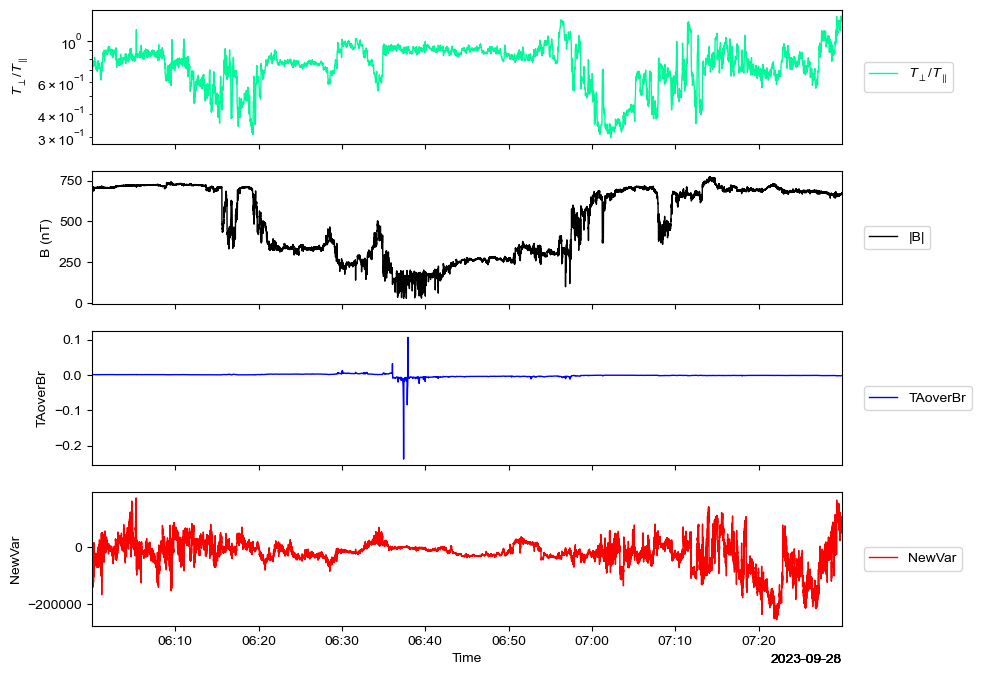

In [42]:
plt.options.reset() # Resetting options to ensure a clean slate

# Import data
trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']
# get_data(trange, mag_rtn_4sa.bmag, proton.anisotropy)


# Switch back if needed
plot_manager.interp_method = 'nearest'

TAoverBr = custom_variable('TAoverBr', proton.anisotropy / mag_rtn_4sa.br )

TAoverBr.color = 'blue'

NewVar = custom_variable('NewVar', mag_rtn_4sa.br * mag_rtn_4sa.bt)

# Set the color of the new variable
NewVar.color = 'red'

# Plot the new variable on the fourth panel
plotbot(trange, proton.anisotropy, 1, mag_rtn_4sa.bmag, 2, TAoverBr, 3, NewVar, 4)
# multiplot([(trange, proton.anisotropy), (trange, mag_rtn_4sa.bmag), (trange, TAoverB), (trange, NewVar)])


In [43]:
# Import the test runner
# from plotbot.test_pilot import run_missions

# # Run the tests with our space-themed output
# # run_missions("tests.test_custom_variables")
# import pytest
# pytest.main(["-v", "tests/test_custom_variables.py"])
# pytest.main(["-v", "tests/test_custom_variable_operators.py"])
# pytest.main(["-v", "tests/test_multiplot.py"])
# pytest.main(["-v", "tests/test_plotbot.py"])
# pytest.main(["-v", "tests/test_global.py"])


In [44]:
# STOP 😎 #Who's callin this guy invalid!?
# #This just makes the Run All command stop...

📊 Operation complete: mag_rtn_4sa.bmag * 100
   → No interpolation needed for scalar operation

🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
 
🛰️ mag_RTN_4sa - acquiring variables: bmag
🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230928_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

📈 Plotting proton.anisotropy
📈 Plotting mag_rtn_4sa.bmag


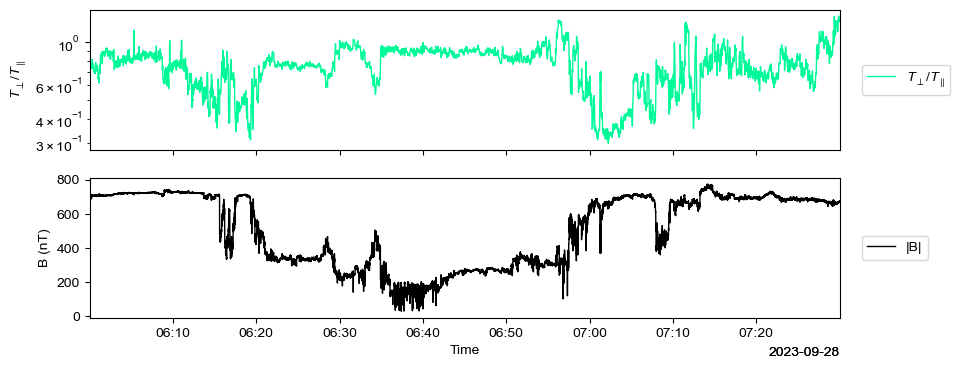

In [45]:
plt.options.reset() # Resetting options to ensure a clean slate

# Set print manager settings for status, debug, and variable testing
# print_manager.show_status = True
# print_manager.show_debug = False
# print_manager.show_variable_testing = True

# Configure server access username
server_access.username = None  # Prompt for username if None, or set 'your_username' to hardcode

# Define time range for plotting
trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']  # Enc 17 HCS Crossing

# Create a scaled version of bmag and set its color

print_manager.variable_testing("Storing bmag100x")
# Store the scaled bmag data
bmag100x = custom_variable('bmag100x', mag_rtn_4sa.bmag * 100)

bmag100x.color = 'red'

print_manager.variable_testing("Initializing plotbot with bmag100x on the third axis")

# Plot bmag and its scaled version
# plotbot(trange, mag_rtn_4sa.bmag, 1, bmag100x, 2)

# Calculate and store TAoverB

# print_manager.variable_testing("defining TAoverBmag")
# TAoverBmag = proton.anisotropy + mag_rtn_4sa.bmag

# TAoverBmag.color = 'red'
# TAoverBmag.y_label = 'TAoverBmag'
# TAoverBmag.name = 'TAoverBmag'

# print_manager.variable_testing("Storing TAoverB")
# store_data('TAoverB', data={'x': proton.anisotropy.datetime_array, 'y': TAoverBmag})
# TAoverB = new_variable(TAoverBmag, 'TAoverB')
# new_variable('Hello', proton.anisotropy + mag_rtn_4sa.bmag)

# Hello.color = 'red'

# Plot anisotropy, bmag, and TAoverB
print_manager.variable_testing("Initializing plotbot with TAoverB on the third axis")
plotbot(trange, proton.anisotropy, 1, mag_rtn_4sa.bmag, 2)# Hello, 3)


In [46]:

# # Set print manager settings for status, debug, and variable testing
# print_manager.show_status = True
# print_manager.show_debug = False
# print_manager.show_variable_testing = True

# # Configure server access username
# server_access.username = None  # Prompt for username if None, or set 'your_username' to hardcode

# # Define time range for plotting
# trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']  # Enc 17 HCS Crossing

# # Plot bmag and its scaled version
# plotbot(trange, mag_rtn_4sa.bmag, 1, proton.anisotropy, 2)

# # Create a scaled version of bmag and set its color
# bmag100x_data = mag_rtn_4sa.bmag * 100
# # Plot bmag and its scaled version
# plotbot(trange, mag_rtn_4sa.bmag, 1, bmag100x, 2)

# # Calculate and store TAoverB

# print_manager.variable_testing("defining TAoverBmag")
# TAoverBmag = proton.anisotropy / mag_rtn_4sa.bmag

# print_manager.variable_testing("Storing TAoverB")
# store_data('TAoverB', data={'x': proton.anisotropy.datetime_array, 'y': TAoverBmag})

# # Plot anisotropy, bmag, and TAoverB
# print_manager.variable_testing("Initializing plotbot with TAoverB on the third axis")
# plotbot(trange, proton.anisotropy, 1, mag_rtn_4sa.bmag, 2, TAoverBmag, 3)


🛰️ mag_RTN_4sa - acquiring variables: br, bmag, bt, bn
🛰️ spe_sf0_pad - acquiring variables: strahl
 
🛰️ mag_RTN_4sa - acquiring variables: br, bmag, bt, bn
🛰️ spe_sf0_pad - acquiring variables: strahl
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spe_sf0_pad - A local .cdf file already exists:
📂 psp_data/sweap/spe/l3/spe_sf0_pad/2023/psp_swp_spe_sf0_L3_pad_20230928_v04.cdf
✅ - CDF Data import complete for spe_sf0_pad range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spe_sf0_pad...
✅ Data acquisition complete

📈 Plotting mag_rtn_4sa.br
📈 Plotting mag_rtn_4sa.bmag
📈 Plotting mag_rtn_4sa.bt
📈 Plotting mag_rtn_4sa.bn
📈 Plotting epad.strahl


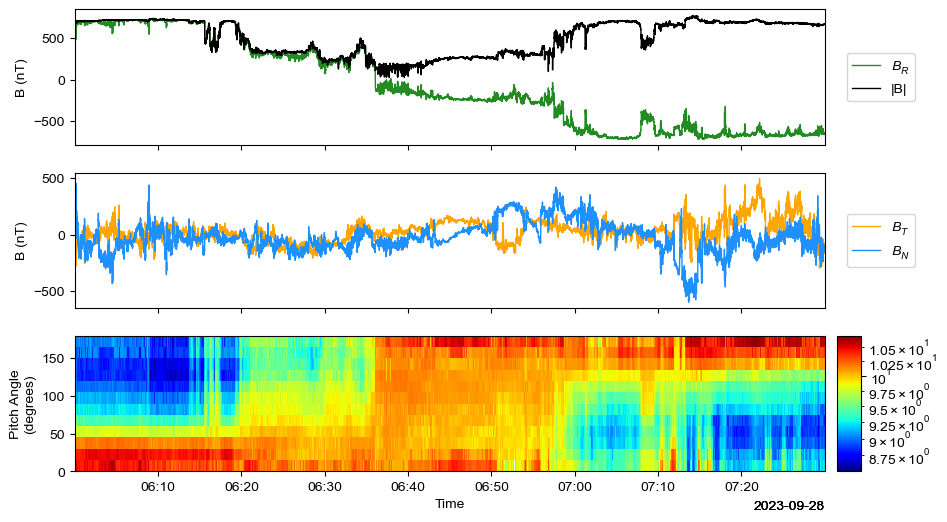

In [47]:
plt.options.reset() # Resetting options to ensure a clean slate
#E17 HCS Crossing

# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False   # Debug prints, helpful for debugging
# print_manager.show_variable_testing = True

server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

epad.strahl.colorbar_limits = 'default'
epad.strahl.colorbar_scale = 'log'

trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']  # Enc 17 HCS Crossing
plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1, 
        mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
        epad.strahl, 3)



# Uncomment to add proton data! Note: You'll need a username and password for server access.
# plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1,  
#         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
#         epad.strahl, 3, 
#         proton.energy_flux, 4, 
#         proton.theta_flux, 5, 
#         proton.phi_flux, 6, 
#         proton.t_perp, 7, 
#         proton.t_par, 7, proton.anisotropy, '7r', 
#         proton.v_sw, 8, proton.v_alfven, 8)

🛰️ mag_RTN_4sa - acquiring variables: br
 
🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2024/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20240929_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2024-09-29/12:10:00.000', '2024-09-29/12:11:00.000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

📈 Plotting mag_rtn_4sa.br


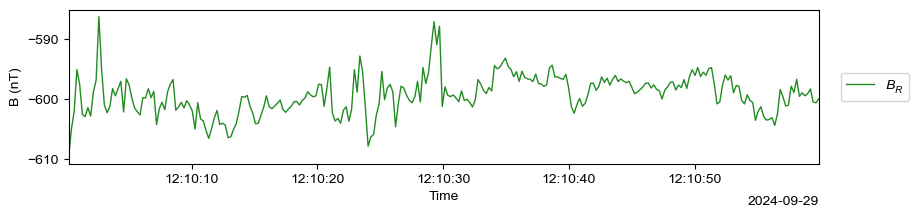

In [48]:
# trange = ['2024-09-30/12:10:00.000', '2024-09-30/12:11:00.000']

plt.options.reset() # Resetting options to ensure a clean slate

trange = ['2024-09-29/12:10:00.000', '2024-09-29/12:11:00.000']

plotbot(trange, mag_rtn_4sa.br, 1)

### Showdahodo

✨ We can use the showdahodo function to plot two variables against each other, like the radial magnetic field and strahl centroids!

🛰️ mag_RTN_4sa - acquiring variables: br
🛰️ spe_sf0_pad - acquiring variables: centroids
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating mag_RTN_4sa...
📡 spe_sf0_pad - A local .cdf file already exists:
📂 psp_data/sweap/spe/l3/spe_sf0_pad/2023/psp_swp_spe_sf0_L3_pad_20230928_v04.cdf
✅ - CDF Data import complete for spe_sf0_pad range ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000'].

📥 Updating spe_sf0_pad...
✅ Data acquisition complete



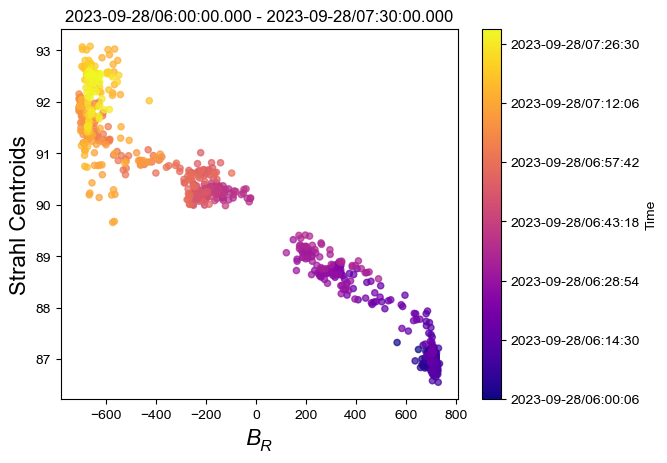

In [49]:
#----Print manager----///
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False  # Debug prints, helpful for debugging

#----Showdahodo----///
trange = ['2023-09-28/06:00:00.000', '2023-09-28/07:30:00.000']  # Enc 17 HCS Crossing

print("✨ We can use the showdahodo function to plot two variables against each other, like the radial magnetic field and strahl centroids!\n")

showdahodo(trange, mag_rtn_4sa.br, epad.centroids);

🛰️ spi_sf00_l3_mom - acquiring variables: beta_ppar, anisotropy
📡 spi_sf00_l3_mom - A local .cdf file already exists:
📂 psp_data/sweap/spi/l3/spi_sf00_l3_mom/2024/psp_swp_spi_sf00_L3_mom_20240930_v04.cdf
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2024-09-30/11:45:00.000', '2024-09-30/12:45:00.000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete



/Users/jlverniero/GitHub/Plotbot/plotbot/showdahodo.py:538: RuntimeWarning: invalid value encountered in power
  trat_parfire = 1-(.47/(beta_par - .59)**.53)


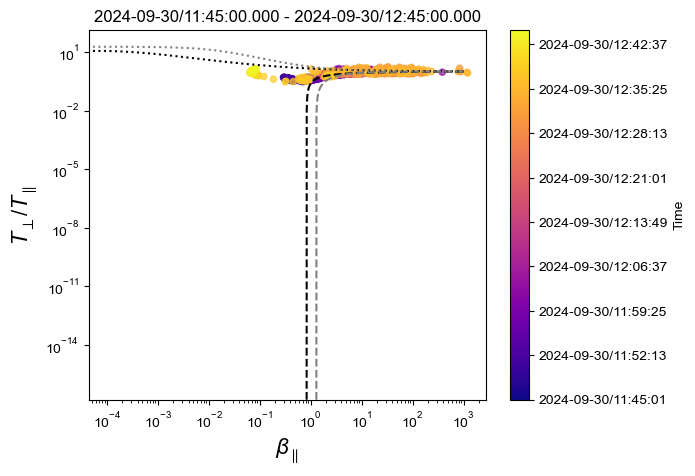

In [50]:
# First define your time range for September 30, 2024 from 11:45 to 12:45
trange = ['2024-09-30/11:45:00.000', '2024-09-30/12:45:00.000']

proton.beta_ppar.y_scale = 'log'
proton.anisotropy.y_scale = 'log'

# Then use showdahodo with proton.beta_ppar on x-axis and proton.anisotropy on y-axis
showdahodo(trange, proton.beta_ppar, proton.anisotropy, brazil=True);

In [51]:
# #E21 Glory Region! 
# print_manager.show_status = False  # Status prints, useful for status updates
# print_manager.show_debug = False   # Debug prints, helpful for debugging

# server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

# epad.strahl.colorbar_limits = [10.4, 11]
# epad.strahl.colorbar_scale = 'log'

# trange = ['2024-09-30/12:10:00.000', '2024-09-30/12:20:00.000']
# # plotbot(trange, mag_rtn_4sa.all, 1, mag_rtn_4sa.bmag, 1, 
# #         epad_hr.strahl, 2, 
# #         proton_hr.energy_flux, 3, 
# #         proton_hr.t_perp, 4, 
# #         proton_hr.t_par, 4, proton_hr.anisotropy, '4r', 
# #         proton_hr.v_sw, 5, proton_hr.v_alfven, '5r')

# plotbot(trange, mag_rtn_4sa.br, 1, mag_rtn_4sa.bmag, 1, 
#         mag_rtn_4sa.bt, 2, mag_rtn_4sa.bn, 2, 
#         epad.strahl, 3, 
#         proton.energy_flux, 4, 
#         proton.theta_flux, 5, 
#         proton.phi_flux, 6, 
#         proton.t_perp, 7, 
#         proton.t_par, 7, proton.anisotropy, '7r', 
#         proton.v_sw, 8, proton.v_alfven, 8)

### Multiplot

In [52]:
#We can define a separate list of encounters to plot, or continue to use the rainbow_encounters list!
encounters = [
    # {'perihelion': '2018/11/06 03:27:00.000'}, #Enc 1
    # {'perihelion': '2019/04/04 22:39:00.000'}, #Enc 2
    # {'perihelion': '2019/09/01 17:50:00.000'}, #Enc 3
    # {'perihelion': '2020/01/29 09:37:00.000'}, #Enc 4
    # {'perihelion': '2020/06/07 08:23:00.000'}, #Enc 5
    # {'perihelion': '2020/09/27 09:16:00.000'}, #Enc 6
    # {'perihelion': '2021/01/17 17:40:00.000'}, #Enc 7
    # {'perihelion': '2021/04/29 08:48:00.000'}, #Enc 8
    # {'perihelion': '2021/08/09 19:11:00.000'}, #Enc 9
    # {'perihelion': '2021/11/21 08:23:00.000'}, #Enc 10
    # {'perihelion': '2022/02/25 15:38:00.000'}, #Enc 11
    # {'perihelion': '2022/06/01 22:51:00.000'}, #Enc 12
    # {'perihelion': '2022/09/06 06:04:00.000'}, #Enc 13
    # {'perihelion': '2022/12/11 13:16:00.000'}, #Enc 14
    # {'perihelion': '2023/03/17 20:30:00.000'}, #Enc 15
    # {'perihelion': '2023/06/22 03:46:00.000'}, #Enc 16
    {'perihelion': '2023/09/27 23:28:00.000'}, #Enc 17
    {'perihelion': '2023/12/29 00:56:00.000'}, #Enc 18
    {'perihelion': '2024/03/30 02:21:00.000'}, #Enc 19 
    # {'perihelion': '2024/06/30 03:47:00.000'}, #Enc 20 Not yet publicly available
    # {'perihelion': '2024/09/30 05:15:00.000'}, #Enc 21 Not yet publicly available
    # {'perihelion': '2024/12/24 11:53:00.000'}, #Enc 22 Not yet publicly available
]

In [53]:
# # Create an empty list to store plot data
# plot_data = []

# # Process each encounter
# for i, encounter in enumerate(encounters):
#     # Get data for this time range
#     trange = [encounter['rangeStart'], encounter['rangeStop']]
#     get_data(trange, mag_rtn_4sa.bmag, proton.anisotropy)
    
#     # Create derived variable
#     TAoverBmag = proton.anisotropy / mag_rtn_4sa.bmag 
    
#     # Store with unique name
#     enc_num = i + 1  # Encounter number (1-based)
#     unique_name = f"TAoverBmag_E{enc_num}"
#     store_data(unique_name, data={'x': TAoverBmag.datetime_array, 'y': TAoverBmag})
    
#     # Add to plot data using the uniquely stored variable
#     # We reference the variable by its new name
#     derived_var = eval(unique_name)  # This works because it was made globally accessible
#     plot_data.append((encounter['perihelion'], derived_var))



# # Plot everything
# multiplot(plot_data);

We're downloading a LOT of data here. This will take a while, but we only need to do it once and then we'll load from the local .cdf files!
Hold tight 🙏

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230926_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230927_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-26/23:28:00.000000', '2023-09-28/23:28:00.000000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20231228_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20231229_v02.cdf, psp_data/fields/l2/mag_rtn

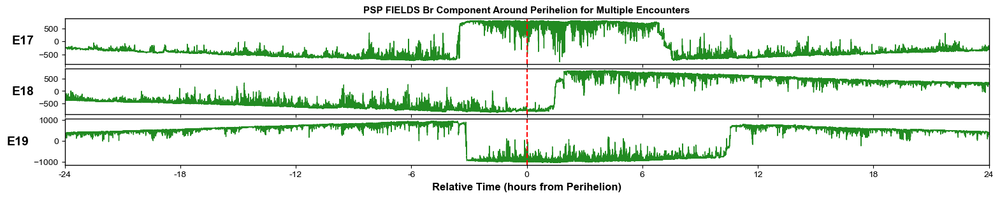

In [54]:
#######-----📈📈📈📈📈 MULTIPLOTTING MAGIC 📉📉📉📉📉📉-----#######

#====================================================================
# CONFIGURE PRINT MANAGER AND SERVER ACCESS
#====================================================================
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False  # Debug prints, helpful for debugging

# print_manager.show_variable_testing = True
# print_manager.show_variable_basic = True

server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

#====================================================================
# RESET PLOTTING OPTIONS
#====================================================================
plt.options.reset() # Resetting options to ensure a clean slate

#====================================================================
# CONFIGURE GENERAL PLOT OPTIONS
#====================================================================
# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 1
plt.options.hspace = 0.1

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5

plt.options.use_single_title = True
plt.options.single_title_text = "PSP FIELDS Br Component Around Perihelion for Multiple Encounters"
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = True
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

#====================================================================
# CONFIGURE AXIS-SPECIFIC OPTIONS ✨NEW!✨
#====================================================================
# plt.options.ax1.y_limit = (-3000, 3000)  # Example y-limit for ax1
# plt.options.ax3.color = 'purple'

#====================================================================
# Rainbow Plot 🌈 -- Uncomment the second set for a single color plot!
#====================================================================
plt.options.color_mode = 'default'  # Options: 'default', 'rainbow', 'single'
plt.options.single_color = None     # Used when color_mode = 'single'

# plt.options.color_mode = 'single'  # Options: 'default', 'rainbow', 'single'
# plt.options.single_color = 'red'     # Used when color_mode = 'single'

#====================================================================
# DATA SELECTION FOR PLOTTING
#====================================================================

plt.options.window = '48:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

plot_variable = mag_rtn_4sa.br


# Create the plot data list using list comprehension
plot_data = [(encounter['perihelion'], plot_variable) for encounter in encounters]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
print("We're downloading a LOT of data here. This will take a while, but we only need to do it once and then we'll load from the local .cdf files!")
print("Hold tight 🙏\n")
multiplot(plot_data);

In [55]:
#define a set of encounters to plot
rainbow_encounters = [
    # {'perihelion': '2018/11/06 03:27:00.000'}, #Enc 1
    # {'perihelion': '2019/04/04 22:39:00.000'}, #Enc 2
    # {'perihelion': '2019/09/01 17:50:00.000'}, #Enc 3
    # {'perihelion': '2020/01/29 09:37:00.000'}, #Enc 4
    # {'perihelion': '2020/06/07 08:23:00.000'}, #Enc 5
    # {'perihelion': '2020/09/27 09:16:00.000'}, #Enc 6
    # {'perihelion': '2021/01/17 17:40:00.000'}, #Enc 7
    # {'perihelion': '2021/04/29 08:48:00.000'}, #Enc 8
    # {'perihelion': '2021/08/09 19:11:00.000'}, #Enc 9
    # {'perihelion': '2021/11/21 08:23:00.000'}, #Enc 10
    # {'perihelion': '2022/02/25 15:38:00.000'}, #Enc 11
    # {'perihelion': '2022/06/01 22:51:00.000'}, #Enc 12
    # {'perihelion': '2022/09/06 06:04:00.000'}, #Enc 13
    # {'perihelion': '2022/12/11 13:16:00.000'}, #Enc 14
    # {'perihelion': '2023/03/17 20:30:00.000'}, #Enc 15
    # {'perihelion': '2023/06/22 03:46:00.000'}, #Enc 16
    {'perihelion': '2023/09/27 23:28:00.000'}, #Enc 17
    {'perihelion': '2023/12/29 00:56:00.000'}, #Enc 18
    {'perihelion': '2024/03/30 02:21:00.000'}, #Enc 19 
    # {'perihelion': '2024/06/30 03:47:00.000'}, #Enc 20 Not yet publicly available
    # {'perihelion': '2024/09/30 05:15:00.000'}, #Enc 21 Not yet publicly available
    # {'perihelion': '2024/12/24 11:53:00.000'}, #Enc 22 Not yet publicly available
]

🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
File psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230925_v04.cdf downloaded successfully.
File psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20230929_v04.cdf downloaded successfully.
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-09-25/23:28:00.000000', '2023-09-29/23:28:00.000000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
File psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20231227_v04.cdf downloaded successfully.
File psp_data/sweap/spi/l3/spi_sf00_l3_mom/2023/psp_swp_spi_sf00_L3_mom_20231231_v04.cdf downloaded successfully.
✅ - CDF Data import complete for spi_sf00_l3_mom range ['2023-12-27/00:56:00.000000', '2023-12-31/00:56:00.000000'].

📥 Updating spi_sf00_l3_mom...
✅ Data acquisition complete

🛰️ spi_sf00_l3_mom - acquiring variables: anisotropy
File psp_data/sweap/spi/l3/spi_

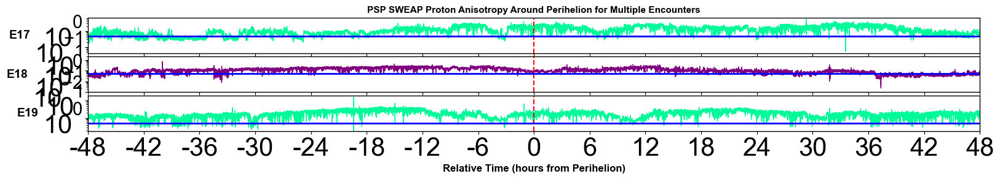

In [56]:
#######-----📈📈📈📈📈 MULTIPLOTTING MAGIC 📉📉📉📉📉📉-----#######

#====================================================================
# CONFIGURE PRINT MANAGER AND SERVER ACCESS
#====================================================================
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False # Debug prints, helpful for debugging

server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

#====================================================================
# RESET PLOTTING OPTIONS
#====================================================================
plt.options.reset() # Resetting options to ensure a clean slate

#====================================================================
# CONFIGURE GENERAL PLOT OPTIONS
#====================================================================
# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 0.8
plt.options.hspace = 0.1

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12

# plt.options.x_tick_label_size = 10
# plt.options.y_tick_label_size = 10

plt.options.x_tick_label_size = 30
plt.options.y_tick_label_size = 30

plt.options.y_label_pad = 5

plt.options.use_single_title = True
plt.options.single_title_text = "PSP SWEAP Proton Anisotropy Around Perihelion for Multiple Encounters"
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = True
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

#====================================================================
# CONFIGURE AXIS-SPECIFIC OPTIONS ✨NEW!✨
#====================================================================
plt.options.ax2.y_limit = (0.01, 20)  # Example y-limit for ax2
# Access each axis to ensure it is initialized, then set the y_limit
# for i in range(1, 4): #To properly plot the final desired axis, use the last axis number + 1 for the end range!
#     axis_attr = f'ax{i}'
#     axis_options = getattr(plt.options, axis_attr)  # This will initialize the axis if it doesn't exist
#     axis_options.y_limit = (0, 10)  # Set y-limit for axes 1 through 22

plt.options.ax2.color = 'purple'

#====================================================================
# Rainbow Plot 🌈 -- Uncomment the second set for a single color plot!
#====================================================================
# plt.options.color_mode = 'rainbow'  # Options: 'default', 'rainbow', 'single'
plt.options.single_color = None     # Used when color_mode = 'single'

# plt.options.color_mode = 'single'  # Options: 'default', 'rainbow', 'single'
# plt.options.single_color = 'red'     # Used when color_mode = 'single'


#====================================================================
# Draw a horizontal line at a specific value!
#====================================================================
plt.options.draw_horizontal_line = True
plt.options.horizontal_line_value = 0.5
plt.options.horizontal_line_color = 'blue'
plt.options.horizontal_line_width = 2
plt.options.horizontal_line_style = '-'
plt.options.border_line_width = 1

# # Axis-specific horizontal line
# plt.options.ax1.draw_horizontal_line = True
# plt.options.ax1.horizontal_line_value = 2.0
# plt.options.ax1.horizontal_line_color = 'green'

#====================================================================
# DATA SELECTION FOR PLOTTING
#====================================================================

plt.options.window = '96:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

plot_variable = proton.anisotropy #You'll need server access to plot this variable!

# Create the plot data list using list comprehension
plot_data = [(encounter['perihelion'], plot_variable) for encounter in rainbow_encounters]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
# multiplot(plot_data); #You'll need server access to plot this variable! ✨Un-comment to Plot! 

# Add this after calling multiplot
fig, axs = multiplot(plot_data)
    


Bring the magic 🌈
🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230926_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230927_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20230928_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-09-26/23:28:00.000000', '2023-09-28/23:28:00.000000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20231228_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20231229_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2023/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20231230_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2023-12-28/00:56

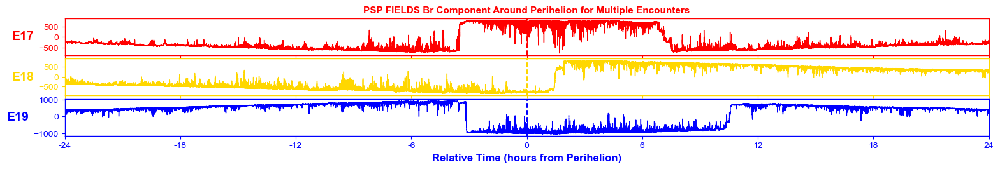

In [57]:
#######-----🌈🌈🌈🌈🌈🌈 MULTIPLOTTING Rainbow MAGIC 🌈🌈🌈🌈🌈----#######

#====================================================================
# CONFIGURE PRINT MANAGER AND SERVER ACCESS
#====================================================================
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False  # Debug prints, helpful for debugging

server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

#====================================================================
# RESET PLOTTING OPTIONS
#====================================================================
plt.options.reset() # Resetting options to ensure a clean slate

#====================================================================
# CONFIGURE GENERAL PLOT OPTIONS
#====================================================================
# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 0.8
plt.options.hspace = 0.1

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5

plt.options.use_single_title = True
plt.options.single_title_text = "PSP FIELDS Br Component Around Perihelion for Multiple Encounters"
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = True
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

#====================================================================
# CONFIGURE AXIS-SPECIFIC OPTIONS ✨NEW!✨
#====================================================================
# plt.options.ax1.y_limit = (-3000, 3000)  # Example y-limit for ax1
# plt.options.ax3.color = 'purple'

#====================================================================
# Rainbow Plot 🌈 -- Uncomment the second set for a single color plot!
#====================================================================
plt.options.color_mode = 'rainbow'  # Options: 'default', 'rainbow', 'single'
plt.options.single_color = None     # Used when color_mode = 'single'

# plt.options.color_mode = 'single'  # Options: 'default', 'rainbow', 'single'
# plt.options.single_color = 'red'     # Used when color_mode = 'single'

#====================================================================
# DATA SELECTION FOR PLOTTING
#====================================================================

plt.options.window = '48:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

plot_variable = mag_rtn_4sa.br

# Create the plot data list using list comprehension
plot_data = [(encounter['perihelion'], plot_variable) for encounter in rainbow_encounters]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
print("Bring the magic 🌈")

multiplot(plot_data);

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210428_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210429_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2021-04-28/22:00:00.000000', '2021-04-29/04:00:00.000000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210429_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2021-04-29/05:20:00.000000', '2021-04-29/11:20:00.000000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210429_v02.cdf
✅ - CDF Data

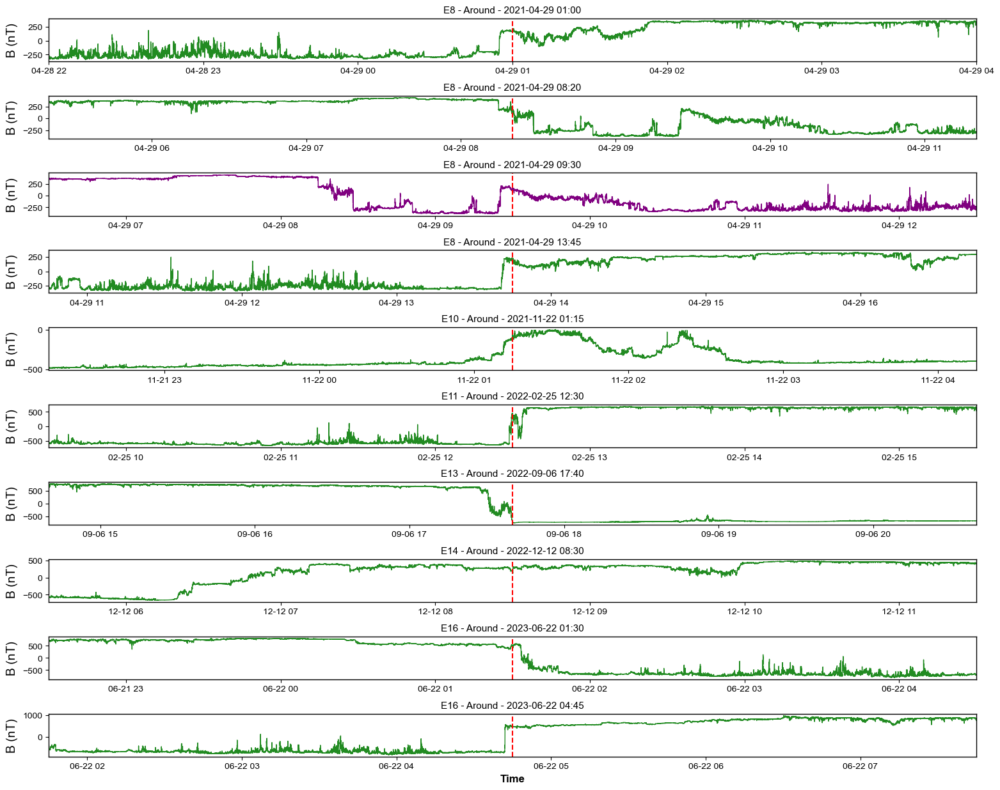

In [58]:
#######-----📈📈📈📈📈 MULTIPLOTTING MAGIC 📉📉📉📉📉📉-----#######

#====================================================================
# CONFIGURE PRINT MANAGER AND SERVER ACCESS
#====================================================================
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False  # Debug prints, helpful for debugging

# server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

#====================================================================
# RESET PLOTTING OPTIONS
#====================================================================
plt.options.reset() # Resetting options to ensure a clean slate

#====================================================================
# CONFIGURE GENERAL PLOT OPTIONS
#====================================================================
# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 1.5
plt.options.hspace = 0.8

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5

plt.options.use_single_title = False
plt.options.single_title_text = "Br Around PSP HCS Crossings"
plt.options.y_label_uses_encounter = False
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = False
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = False
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

#====================================================================
# CONFIGURE AXIS-SPECIFIC OPTIONS ✨NEW!✨
#====================================================================
# plt.options.ax1.y_limit = (-3000, 3000)  # Example y-limit for ax1
plt.options.ax3.color = 'purple'

#====================================================================
# DATA SELECTION FOR PLOTTING
#====================================================================
hcs_crossing_times = [ #in the previous example we defined the times outside the cell, either way works!
    '2021-04-29/01:00:00.000',
    '2021-04-29/08:20:00.000',
    '2021-04-29/09:30:00.000',
    '2021-04-29/13:45:00.000',
    '2021-11-22/01:15:00.000',
    '2022-02-25/12:30:00.000',
    '2022-09-06/17:40:00.000',
    '2022-12-12/08:30:00.000',
    '2023-06-22/01:30:00.000',
    '2023-06-22/04:45:00.000'
]

plt.options.window = '06:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

plot_variable = mag_rtn_4sa.br

# Create the plot data list using list comprehension
plot_data = [(time, plot_variable) for time in hcs_crossing_times]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
multiplot(plot_data); #✨Un-comment to Plot! 

🛰️ spe_sf0_pad - acquiring variables: strahl
📡 spe_sf0_pad - Local .cdf files already exist:
📂 psp_data/sweap/spe/l3/spe_sf0_pad/2021/psp_swp_spe_sf0_L3_pad_20210428_v04.cdf, psp_data/sweap/spe/l3/spe_sf0_pad/2021/psp_swp_spe_sf0_L3_pad_20210429_v04.cdf
✅ - CDF Data import complete for spe_sf0_pad range ['2021-04-28/22:00:00.000000', '2021-04-29/04:00:00.000000'].

📥 Updating spe_sf0_pad...
✅ Data acquisition complete

🛰️ spe_sf0_pad - acquiring variables: strahl
📡 spe_sf0_pad - A local .cdf file already exists:
📂 psp_data/sweap/spe/l3/spe_sf0_pad/2021/psp_swp_spe_sf0_L3_pad_20210429_v04.cdf
✅ - CDF Data import complete for spe_sf0_pad range ['2021-04-29/05:20:00.000000', '2021-04-29/11:20:00.000000'].

📥 Updating spe_sf0_pad...
✅ Data acquisition complete

🛰️ spe_sf0_pad - acquiring variables: strahl
📡 spe_sf0_pad - A local .cdf file already exists:
📂 psp_data/sweap/spe/l3/spe_sf0_pad/2021/psp_swp_spe_sf0_L3_pad_20210429_v04.cdf
✅ - CDF Data import complete for spe_sf0_pad range ['202

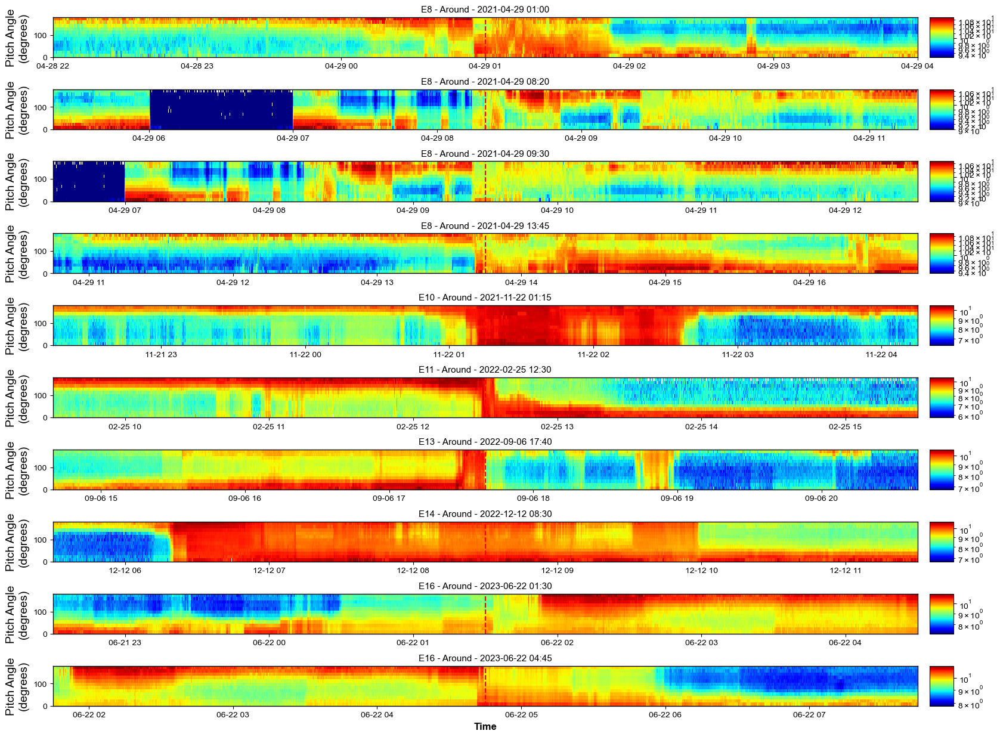

In [59]:
#######-----📈📈📈📈📈 MULTIPLOTTING MAGIC - STRAHL EXAMPLE 📉📉📉📉📉📉-----#######

#====================================================================
# CONFIGURE PRINT MANAGER AND SERVER ACCESS
#====================================================================
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False  # Debug prints, helpful for debugging

# server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

#====================================================================
# RESET PLOTTING OPTIONS
#====================================================================
plt.options.reset() # Resetting options to ensure a clean slate

#====================================================================
# CONFIGURE GENERAL PLOT OPTIONS
#====================================================================

# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 1.5
plt.options.hspace = 0.8

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5

plt.options.use_single_title = False
plt.options.single_title_text = "Br Around PSP HCS Crossings"
plt.options.y_label_uses_encounter = False
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = False
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = False
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

#====================================================================
# CONFIGURE AXIS-SPECIFIC OPTIONS ✨NEW!✨
#====================================================================
plt.options.ax2.colorbar_limits = (9, 10.7) #We're setting a custom limit to correct for the area where the instrument dropped out.
plt.options.ax3.colorbar_limits = (9, 10.7) #This causes the drop-out region to appear dark blue, but the rest of the data is properly scaled.

#====================================================================
# Ploptions work too!
#====================================================================
epad.strahl.colorbar_limits = 'default' #Setting to default in case this was changed elsewhere... it gets overriden by the axis specific option for ax2 and ax3!

#====================================================================
# DATA SELECTION FOR PLOTTING
#====================================================================
hcs_crossing_times = [ #in the previous example we defined the times outside the cell, either way works!
    '2021-04-29/01:00:00.000',
    '2021-04-29/08:20:00.000',
    '2021-04-29/09:30:00.000',
    '2021-04-29/13:45:00.000',
    '2021-11-22/01:15:00.000',
    '2022-02-25/12:30:00.000',
    '2022-09-06/17:40:00.000',
    '2022-12-12/08:30:00.000',
    '2023-06-22/01:30:00.000',
    '2023-06-22/04:45:00.000'
]

plt.options.window = '06:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

plot_variable = epad.strahl

# Create the plot data list using list comprehension
plot_data = [(time, plot_variable) for time in hcs_crossing_times]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
multiplot(plot_data); #✨Un-comment to Plot! 

In [60]:
#######-----📈📈📈📈📈 MULTIPLOTTING MAGIC 📉📉📉📉📉📉-----#######

#====================================================================
# CONFIGURE PRINT MANAGER AND SERVER ACCESS
#====================================================================
# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False  # Debug prints, helpful for debugging

server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

#====================================================================
# RESET PLOTTING OPTIONS
#====================================================================
plt.options.reset() # Resetting options to ensure a clean slate

#====================================================================
# CONFIGURE GENERAL PLOT OPTIONS
#====================================================================
# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 0.8
plt.options.hspace = 0.1

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5

plt.options.use_single_title = True
plt.options.single_title_text = "PSP SWEAP Proton Anisotropy Around Perihelion for Multiple Encounters"
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = True
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

#====================================================================
# CONFIGURE AXIS-SPECIFIC OPTIONS ✨NEW!✨
#====================================================================
# plt.options.ax4.y_limit = (0, 5)  # Example y-limit for ax1
# Access each axis to ensure it is initialized, then set the y_limit
for i in range(11, 16): #To properly plot the final desired axis, use the last axis number + 1 for the end range!
    axis_attr = f'ax{i}'
    axis_options = getattr(plt.options, axis_attr)  # This will initialize the axis if it doesn't exist
    axis_options.y_limit = (0, 10)  # Set y-limit for axes 1 through 22

# plt.options.ax3.color = 'purple'

#====================================================================
# Rainbow Plot 🌈 -- Uncomment the second set for a single color plot!
#====================================================================
plt.options.color_mode = 'rainbow'  # Options: 'default', 'rainbow', 'single'
plt.options.single_color = None     # Used when color_mode = 'single'

# plt.options.color_mode = 'single'  # Options: 'default', 'rainbow', 'single'
# plt.options.single_color = 'red'     # Used when color_mode = 'single'

#====================================================================
# DATA SELECTION FOR PLOTTING
#====================================================================

plt.options.window = '48:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

plot_variable = proton.anisotropy #You'll need server access to plot this variable!

# Create the plot data list using list comprehension
plot_data = [(encounter['perihelion'], plot_variable) for encounter in rainbow_encounters]

#====================================================================
# CALL MULTIPLOT WITH UPDATED OPTIONS
#====================================================================
# multiplot(plot_data); #You'll need server access to plot this variable! ✨Un-comment to Plot! 

In [61]:
# STOP 😎 #Who's callin this guy invalid!?
#This just makes the Run All command stop...
#This is a work in progress! You can scroll down to the bottom and manually run the audification cell bock to write audio files 🔈

This is a work in progress! You can scroll down to the bottom and manually run the audification cell bock to write audio files 🔈

In [62]:
#Example Strahl Plot

# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False   # Debug prints, helpful for debugging

# server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

# plot_variable = proton.m_alfven   
# plot_variable = mag_rtn_4sa.br
# plot_variable = mag_rtn_4sa.bt
plot_variable = epad.strahl

perihelion_times = [(encounter['perihelion'], plot_variable) for encounter in encounters]

# Update plt.options with the multiplot settings
plt.options.window = '96:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

# Plot Sizing
plt.options.width = 26
plt.options.height_per_panel = 0.8
plt.options.hspace = 0.15

# Font Sizes and Padding
plt.options.title_fontsize = 12
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10  # Size of x-axis tick labels
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5  # Space between y-label and axis

plt.options.use_single_title = True
# plt.options.single_title_text = "Alfven Mach Number Around Perihelion for Multiple Encounters"
# plt.options.single_title_text = "PSP FIELDS Br (nT) Around Perihelion for Multiple Encounters"
plt.options.single_title_text = "Strahl Pitch Angle (Degrees) Around Parker Solar Probe Perihelion Crossings"

plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = True
plt.options.relative_time_step_units = 'hours'  # use 'days', 'hours', 'minutes', or 'seconds'.
plt.options.relative_time_step = 2
plt.options.use_single_x_axis = True
plt.options.use_custom_x_axis_label = True
plt.options.custom_x_axis_label = "Relative Time (hours from Perihelion)"

# Call multiplot with updated options
# multiplot(perihelion_times) #✨Un-comment to Plot!


🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210428_v02.cdf, psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210429_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2021-04-28/22:00:00.000000', '2021-04-29/04:00:00.000000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210429_v02.cdf
✅ - CDF Data import complete for mag_RTN_4sa range ['2021-04-29/05:20:00.000000', '2021-04-29/11:20:00.000000'].

📥 Updating mag_RTN_4sa...
✅ Data acquisition complete

🛰️ mag_RTN_4sa - acquiring variables: br
📡 mag_RTN_4sa - A local .cdf file already exists:
📂 psp_data/fields/l2/mag_rtn_4_per_cycle/2021/psp_fld_l2_mag_RTN_4_Sa_per_Cyc_20210429_v02.cdf
✅ - CDF Data

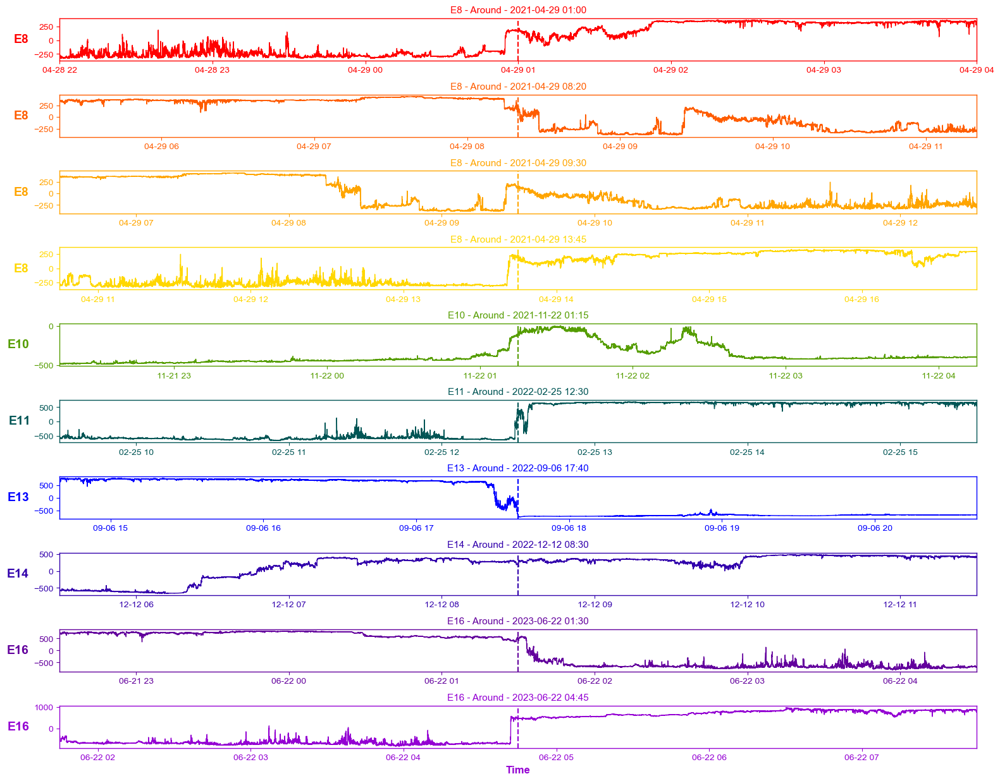

In [63]:
# And we can still create our plots this way! 🙌

# print_manager.show_status = True  # Status prints, useful for status updates
# print_manager.show_debug = False   # Debug prints, helpful for debugging

# server_access.username = None # Set to None for username prompt, or enter 'your_username' to hardcode.

# Update plt.options with the multiplot settings
plt.options.window = '06:00:00.000'
plt.options.position = 'around'  # Position options for multiplot: 'before', 'after', 'around'

# Plot Sizing
plt.options.width = 20
plt.options.height_per_panel = 1.5
plt.options.hspace = 0.8

# Font Sizes and Padding
plt.options.title_fontsize = 11
plt.options.y_label_size = 14
plt.options.x_label_size = 12
plt.options.x_tick_label_size = 10
plt.options.y_tick_label_size = 10
plt.options.y_label_pad = 5

plt.options.use_single_title = False
plt.options.single_title_text = "Br Around PSP HCS Crossings"
plt.options.y_label_uses_encounter = True
plt.options.y_label_includes_time = False

plt.options.draw_vertical_line = True
plt.options.vertical_line_width = 1.5
plt.options.vertical_line_color = 'red'
plt.options.vertical_line_style = '--'

plt.options.use_relative_time = False
plt.options.relative_time_step_units = 'hours'
plt.options.relative_time_step = 6
plt.options.use_single_x_axis = False
plt.options.use_custom_x_axis_label = False
plt.options.custom_x_axis_label = None

# Call multiplot with updated options
multiplot([
    ('2021-04-29/01:00:00.000', mag_rtn_4sa.br),
    ('2021-04-29/08:20:00.000', mag_rtn_4sa.br),
    ('2021-04-29/09:30:00.000', mag_rtn_4sa.br),
    ('2021-04-29/13:45:00.000', mag_rtn_4sa.br),
    ('2021-11-22/01:15:00.000', mag_rtn_4sa.br),
    ('2022-02-25/12:30:00.000', mag_rtn_4sa.br),
    ('2022-09-06/17:40:00.000', mag_rtn_4sa.br),
    ('2022-12-12/08:30:00.000', mag_rtn_4sa.br),
    ('2023-06-22/01:30:00.000', mag_rtn_4sa.br),
    ('2023-06-22/04:45:00.000', mag_rtn_4sa.br)
]);

In [64]:
# STOP 😎 #Who's callin this guy invalid!?
# #This just makes the Run All command stop...

### Audification

In [65]:
# To force selection of a new directory:
SET_NEW_SAVE_DIRECTORY = False  # Set to True to choose a new save directory
audifier.select_save_dir(force_new=SET_NEW_SAVE_DIRECTORY)
print()

Using previously set save directory: /Users/robertalexander/Dropbox/__Collaborations/_NASA/__HCS_Crossing_Catalogue/HCS_Crossings/E23


Button(button_style='info', description='Open Save Directory', style=ButtonStyle(), tooltip='Click to open the…

In [66]:
# Optionally change markers per hour from default 120
audifier.markers_per_hour = 60  # 1 marker every 10 seconds = 360 markers per hour,
audifier.markers_only = False  # Default setting
audifier.quantize_markers = True  # hourly
audifier.sample_rate = 22000
audifier.channels = 1

# trange = ['2024-09-27/05:15.000', '2024-10-03/05:15.000']  # Enc 21

# trange = ['2025-03-23/17:30:00.000', '2025-03-23/18:30:00.000']  # Enc 23 Flapping Proof?
trange = ['2025-03-23/17:56:00.000', '2025-03-23/18:06:00.000']  # Enc 23 Flapping Proof Zoom


print(trange)

# Create audio files and markers from any components
# audifier.audify(trange, mag_rtn_4sa.br, mag_rtn_4sa.bt, mag_rtn_4sa.bn, mag_rtn_4sa.bmag)
audifier.audify(trange, mag_rtn.br, mag_rtn.bt, mag_rtn.bn, mag_rtn.bmag)


['2025-03-23/17:56:00.000', '2025-03-23/18:06:00.000']
Starting audification process...
Authentication required for https://sprg.ssl.berkeley.edu/data/psp/data/sci/fields/l2/mag_RTN/2025/03/
Authentication required for https://sprg.ssl.berkeley.edu/data/psp/data/sci/fields/l2/mag_RTN/2025/03/
🤷🏾‍♂️ The data you're looking for can't be retrieved from the server, friend!
An error occurred: 'NoneType' object has no attribute 'status_code'
Authentication required for https://sprg.ssl.berkeley.edu/data/psp/data/sci/fields/l2/mag_RTN/2025/03/
Authentication required for https://sprg.ssl.berkeley.edu/data/psp/data/sci/fields/l2/mag_RTN/2025/03/
🤷🏾‍♂️ The data you're looking for can't be retrieved from the server, friend!
An error occurred: 'NoneType' object has no attribute 'status_code'
Authentication required for https://sprg.ssl.berkeley.edu/data/psp/data/sci/fields/l2/mag_RTN/2025/03/
Authentication required for https://sprg.ssl.berkeley.edu/data/psp/data/sci/fields/l2/mag_RTN/2025/03/
🤷🏾

KeyboardInterrupt: Interrupted by user

In [ ]:
# Optionally change markers per hour from default 120
audifier.markers_per_hour = 60  # 1 marker every 10 seconds = 360 markers per hour,
audifier.markers_only = False  # Default setting
audifier.quantize_markers = True  # hourly
audifier.sample_rate = 15000
audifier.fade_samples = 2000
audifier.channels = 2

# trange = ['2024-09-27/05:15.000', '2024-10-03/05:15.000']  # Enc 21

# trange = ['2025-03-23/17:30:00.000', '2025-03-23/18:30:00.000']  # Enc 23 Flapping Proof?
trange = ['2025-03-23/17:56:00.000', '2025-03-23/18:06:00.000']  # Enc 23 Flapping Proof Zoom


print(trange)

# Create audio files and markers from any components
# audifier.audify(trange, mag_rtn_4sa.br, mag_rtn_4sa.bt, mag_rtn_4sa.bn, mag_rtn_4sa.bmag)
audifier.audify(trange, mag_rtn.bt, mag_rtn.bn)


['2025-03-23/17:56:00.000', '2025-03-23/18:06:00.000']
Starting audification process...
📡 mag_RTN - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn/2025/psp_fld_l2_mag_RTN_2025032312_v00.cdf, psp_data/fields/l2/mag_rtn/2025/psp_fld_l2_mag_RTN_2025032318_v00.cdf
📡 mag_RTN - Local .cdf files already exist:
📂 psp_data/fields/l2/mag_rtn/2025/psp_fld_l2_mag_RTN_2025032312_v00.cdf, psp_data/fields/l2/mag_rtn/2025/psp_fld_l2_mag_RTN_2025032318_v00.cdf

DEBUG CLIPPING:
Clipping data to range: 2025-03-23/17:56:00.000 to 2025-03-23/18:06:00.000
Original data points: 175780
Points in range: 175780

Save directory already ends with encounter 'E23'. Using: /Users/robertalexander/Dropbox/__Collaborations/_NASA/__HCS_Crossing_Catalogue/HCS_Crossings/E23
Output directory: /Users/robertalexander/Dropbox/__Collaborations/_NASA/__HCS_Crossing_Catalogue/HCS_Crossings/E23/E23_2025_03_23_1756_to_1806
Generating markers for time range: 2025-03-23/17:56:00.000 to 2025-03-23/18:06:00.000
Number of

Button(description='Show Directory', style=ButtonStyle())

Button(description='Open markers', style=ButtonStyle())

Button(description='Open stereo_Bt_Bn', style=ButtonStyle())

{'markers': '/Users/robertalexander/Dropbox/__Collaborations/_NASA/__HCS_Crossing_Catalogue/HCS_Crossings/E23/E23_2025_03_23_1756_to_1806/E23_PSP_FIELDS_MARKER_SET_2025-03-23_1756_to_1806_60_per_hour.txt',
 'stereo_Bt_Bn': '/Users/robertalexander/Dropbox/__Collaborations/_NASA/__HCS_Crossing_Catalogue/HCS_Crossings/E23/E23_2025_03_23_1756_to_1806/E23_PSP_MAG_RTN_2025-03-23_1756_to_1806_15000SR_Bt_L_Bn_R.wav'}

=== Magnetic Field Data Analysis ===

1. Data Structure Checks:
Data type: <class 'plotbot.plot_manager.plot_manager'>
Shape: (98876,)
Number of points: 98876
Memory usage: 0.40 MB

2. Basic Statistics:
Mean |B|: 757.44 nT
Median |B|: 733.61 nT
Standard deviation: 87.92 nT
Min |B|: 318.48 nT
Max |B|: 1006.42 nT

3. Component Analysis:
Mean values:
⟨Br⟩: 44.66 nT
⟨Bt⟩: -117.22 nT
⟨Bn⟩: 44.11 nT

4. Field Orientation:
Mean θ (from radial): 89.84°
Mean φ (azimuthal): 54.56°

5. Energy Analysis:
Mean B²: 581450.12 nT²
Mean magnetic energy density: 2.31e+02 J/m³

6. Time Series Properties:
Mean sampling cadence: 0.218454 seconds
Dominant frequency in power spectrum: 1.79e-02 Hz

7. Data Quality Metrics:
Number of NaN values: 16
Number of zeros: 0
Number of values > 3σ: 570



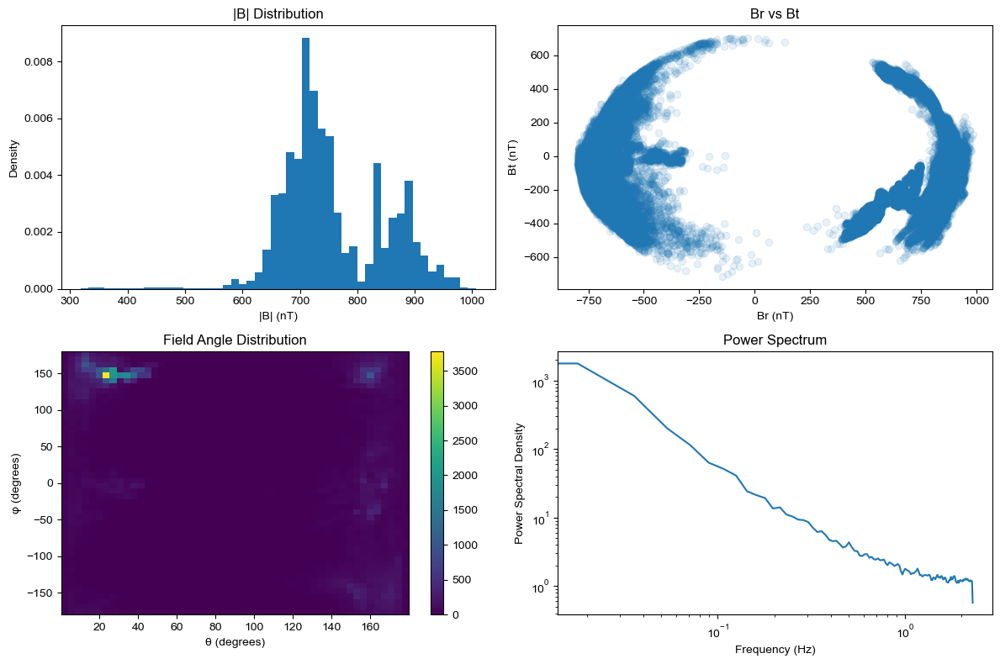

In [ ]:
#Working with Plotbot.data!! (the format is actually "mag_rtn_4sa.bmag.data " but you know what I mean...)

# Statistical Analysis of Magnetic Field Data
print("=== Magnetic Field Data Analysis ===\n")

# Convert plot_manager objects to numpy arrays for analysis
bmag_data = mag_rtn_4sa.bmag.data  
br_data = mag_rtn_4sa.br.data
bt_data = mag_rtn_4sa.bt.data
bn_data = mag_rtn_4sa.bn.data

# Basic checks
print("1. Data Structure Checks:")
print(f"Data type: {type(mag_rtn_4sa.bmag)}")
print(f"Shape: {np.shape(bmag_data)}")
print(f"Number of points: {len(bmag_data)}")
print(f"Memory usage: {bmag_data.nbytes / 1e6:.2f} MB\n")

# Basic statistics
print("2. Basic Statistics:")
print(f"Mean |B|: {np.nanmean(bmag_data):.2f} nT")
print(f"Median |B|: {np.nanmedian(bmag_data):.2f} nT")
print(f"Standard deviation: {np.nanstd(bmag_data):.2f} nT")
print(f"Min |B|: {np.nanmin(bmag_data):.2f} nT")
print(f"Max |B|: {np.nanmax(bmag_data):.2f} nT\n")

# Component analysis
print("3. Component Analysis:")
print("Mean values:")
print(f"⟨Br⟩: {np.nanmean(br_data):.2f} nT")
print(f"⟨Bt⟩: {np.nanmean(bt_data):.2f} nT")
print(f"⟨Bn⟩: {np.nanmean(bn_data):.2f} nT\n")

# Calculate field angles
theta = np.arctan2(np.sqrt(bt_data**2 + bn_data**2), br_data)
phi = np.arctan2(bn_data, bt_data)

print("4. Field Orientation:")
print(f"Mean θ (from radial): {np.degrees(np.nanmean(theta)):.2f}°")
print(f"Mean φ (azimuthal): {np.degrees(np.nanmean(phi)):.2f}°\n")

# Power and energy density
mu0 = 4 * np.pi * 1e-7  # permeability of free space
B_squared = bmag_data**2
energy_density = B_squared / (2 * mu0) * 1e-9  # Convert to J/m^3

print("5. Energy Analysis:")
print(f"Mean B²: {np.nanmean(B_squared):.2f} nT²")
print(f"Mean magnetic energy density: {np.nanmean(energy_density):.2e} J/m³\n")

# Time series analysis
if hasattr(mag_rtn_4sa, 'datetime_array'):
    print("6. Time Series Properties:")
    # Convert datetime array to numeric values for time difference calculation
    time_array = np.array(mag_rtn_4sa.datetime_array, dtype='datetime64[ns]')
    time_diffs = np.diff(time_array)
    mean_cadence_ns = np.mean(time_diffs)
    mean_cadence_s = mean_cadence_ns / np.timedelta64(1, 's')  # Convert to seconds
    print(f"Mean sampling cadence: {mean_cadence_s:.6f} seconds")
    
    # Calculate power spectrum using sampling frequency in Hz
    from scipy import signal
    fs = 1.0 / mean_cadence_s
    # Remove NaN values for spectrum calculation
    valid_data = bmag_data[~np.isnan(bmag_data)]
    if len(valid_data) > 0:
        f, Pxx = signal.welch(valid_data - np.mean(valid_data), fs=fs)
        peak_freq = f[np.argmax(Pxx)]
        print(f"Dominant frequency in power spectrum: {peak_freq:.2e} Hz\n")

# Data quality checks
print("7. Data Quality Metrics:")
print(f"Number of NaN values: {np.sum(np.isnan(bmag_data))}")
print(f"Number of zeros: {np.sum(bmag_data == 0)}")
print(f"Number of values > 3σ: {np.sum(np.abs(bmag_data - np.nanmean(bmag_data)) > 3*np.nanstd(bmag_data))}\n")

# Visualization
plt.figure(figsize=(12, 8))

# Plot 1: Histogram of |B|
plt.subplot(221)
plt.hist(bmag_data[~np.isnan(bmag_data)], bins=50, density=True)
plt.title('|B| Distribution')
plt.xlabel('|B| (nT)')
plt.ylabel('Density')

# Plot 2: Component correlations
plt.subplot(222)
mask = ~np.isnan(br_data) & ~np.isnan(bt_data)
plt.scatter(br_data[mask], bt_data[mask], alpha=0.1)
plt.xlabel('Br (nT)')
plt.ylabel('Bt (nT)')
plt.title('Br vs Bt')

# Plot 3: Field angle distribution
plt.subplot(223)
mask = ~np.isnan(theta) & ~np.isnan(phi)
plt.hist2d(np.degrees(theta[mask]), np.degrees(phi[mask]), bins=50)
plt.xlabel('θ (degrees)')
plt.ylabel('φ (degrees)')
plt.title('Field Angle Distribution')
plt.colorbar()

# Plot 4: Power spectrum
plt.subplot(224)
if hasattr(mag_rtn_4sa, 'datetime_array'):
    valid_data = bmag_data[~np.isnan(bmag_data)]
    if len(valid_data) > 0:
        plt.loglog(f, Pxx)
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Power Spectral Density')
        plt.title('Power Spectrum')

plt.tight_layout()
plt.show()